# **AI for Emergency Department Predictions (18 May 2025)**
# **Members:**
*  **Dipesh Badal (X00229123)**
*  John Staunton (X00229681)
*  Surya Teja Gowd Ayinavilli (X00229553)
*  Olohigbe Pearl Ohiwerei (X00229601)

# **Introduction**

This notebook contains all the Python code and output results for Group 3's project on predicting hospital Emergency Department (ED) outcomes for patients using the MIMIC-IV-ED dataset.

The notebook consists of 5 sections as summarized below:

1. **Libraries** - installs and imports all libraries and functions that are needed later in the notebook  

2. **Load Files** - loads the MIMIC-IV-ED files (all in csv format) into the notebook  

3. **Exploratory Data Analysis / Visualizations** - performs analysis and visualization on the MIMIC-IV-ED data tables to aid in our understanding of the data and to help identify any data trends and potential quality issues that may arise  

4. **Pre-processing** - includes pre-processing to join the data per ED visit from the various separate tables and build the "master dataframe" that will be used as input to the ML models. Includes handling of min/max/outliers/missing values and further feature engineering where required  

5. **Develop & Evaluate Models** - development of multiple ML models including performance assessment, feature importance, bias checks and XAI. Models types are Logistic Regression (LR), Decision Tree (DT), Random Forest (RF), XGBoost (XGB) and Deep Neural Network (DNN).  Also includes implementation of Model Compression for RF and DNN  


# **1. Libraries**

This section installs and imports all libraries and functions that are needed later in the notebook

In [ ]:
# install lime - for XAI analysis
!pip install lime

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 275.7/275.7 kB 5.4 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for lime: filename=lime-0.2.0.1-py3-none-any.whl size=283834 sha256=23e65ae5d9ed32aa24ee0d5d24925fe8b36ccccea4338c79e1a0b480d07bd536
  Stored in directory: /root/.cache/pip/wheels/85/fa/a3/9c2d44c9f3cd77cf4e533b58900b2bf4487f2a17e8ec212a3d
Successfully built lime


In [ ]:
# install graphviz - for display of decision tree images
!pip install graphviz

In [ ]:
# Import libraries that we need to use
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline

import statsmodels.api as sm
from statsmodels.stats.outliers_influence import variance_inflation_factor

from sklearn.metrics import accuracy_score, roc_auc_score, classification_report, confusion_matrix, roc_curve
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import classification_report


from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier

import xgboost as xgb
from xgboost import XGBClassifier
from xgboost import plot_tree
from graphviz import Source
import json

from lime.lime_tabular import LimeTabularExplainer

import shap

import graphviz
from sklearn.tree import export_graphviz

import tensorflow as tf

from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout, Input
from tensorflow.keras.callbacks import EarlyStopping

import time
import os
import joblib

from google.colab import drive

# **2. Load Files**

This section loads the MIMIC-IV-ED files (all in csv format) into the notebook

In [ ]:
# mount the google drive
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# Set path for data files
path = '/content/drive/MyDrive/Colab Notebooks/GROUP CA/Data/'

In [ ]:
# load the Edstays csv file
edstays_df = pd.read_csv(path + 'edstays.csv')
edstays_df.head()

,subject_id,hadm_id,stay_id,intime,outtime,gender,race,arrival_transport,disposition
0,10000032,22595853.0,33258284,2180-05-06 19:17:00,2180-05-06 23:30:00,F,WHITE,AMBULANCE,ADMITTED
1,10000032,22841357.0,38112554,2180-06-26 15:54:00,2180-06-26 21:31:00,F,WHITE,AMBULANCE,ADMITTED
2,10000032,25742920.0,35968195,2180-08-05 20:58:00,2180-08-06 01:44:00,F,WHITE,AMBULANCE,ADMITTED
3,10000032,29079034.0,32952584,2180-07-22 16:24:00,2180-07-23 05:54:00,F,WHITE,AMBULANCE,HOME
4,10000032,29079034.0,39399961,2180-07-23 05:54:00,2180-07-23 14:00:00,F,WHITE,AMBULANCE,ADMITTED


In [ ]:
# load the Triage csv file
triage_df = pd.read_csv(path + 'triage.csv')
triage_df.head()

,subject_id,stay_id,temperature,heartrate,resprate,o2sat,sbp,dbp,pain,acuity,chiefcomplaint
0,10000032,32952584,97.8,87.0,14.0,97.0,71.0,43.0,7,2.0,Hypotension
1,10000032,33258284,98.4,70.0,16.0,97.0,106.0,63.0,0,3.0,"Abd pain, Abdominal distention"
2,10000032,35968195,99.4,105.0,18.0,96.0,106.0,57.0,10,3.0,"n/v/d, Abd pain"
3,10000032,38112554,98.9,88.0,18.0,97.0,116.0,88.0,10,3.0,Abdominal distention
4,10000032,39399961,98.7,77.0,16.0,98.0,96.0,50.0,13,2.0,"Abdominal distention, Abd pain, LETHAGIC"


In [ ]:
# load the Medrecon csv file
medrecon_df = pd.read_csv(path + 'medrecon.csv')
medrecon_df.head()

,subject_id,stay_id,charttime,name,gsn,ndc,etc_rn,etccode,etcdescription
0,10000032,32952584,2180-07-22 17:26:00,albuterol sulfate,28090,21695042308,1,5970.0,Asthma/COPD Therapy - Beta 2-Adrenergic Agents...
1,10000032,32952584,2180-07-22 17:26:00,calcium carbonate,1340,10135021101,1,733.0,Minerals and Electrolytes - Calcium Replacement
2,10000032,32952584,2180-07-22 17:26:00,cholecalciferol (vitamin D3),65241,37205024678,1,670.0,Vitamins - D Derivatives
3,10000032,32952584,2180-07-22 17:26:00,emtricitabine-tenofovir [Truvada],57883,35356007003,1,5849.0,Antiretroviral - Nucleoside and Nucleotide Ana...
4,10000032,32952584,2180-07-22 17:26:00,fluticasone [Flovent HFA],21251,49999061401,1,371.0,Asthma Therapy - Inhaled Corticosteroids (Gluc...


In [ ]:
# load the Pyxis csv file
pyxis_df = pd.read_csv(path + 'pyxis.csv')
pyxis_df.head()

,subject_id,stay_id,charttime,med_rn,name,gsn_rn,gsn
0,10000032,32952584,2180-07-22 17:59:00,1,Albuterol Inhaler,1,5037.0
1,10000032,32952584,2180-07-22 17:59:00,1,Albuterol Inhaler,2,28090.0
2,10000032,35968195,2180-08-05 22:29:00,1,Morphine,1,4080.0
3,10000032,35968195,2180-08-05 22:55:00,2,Donnatol (Elixir),1,4773.0
4,10000032,35968195,2180-08-05 22:55:00,3,Aluminum-Magnesium Hydrox.-Simet,1,2701.0


In [ ]:
# load the Vital Sign csv file
vitalsign_df = pd.read_csv(path + 'vitalsign.csv')
vitalsign_df.head()

,subject_id,stay_id,charttime,temperature,heartrate,resprate,o2sat,sbp,dbp,rhythm,pain
0,10000032,32952584,2180-07-22 16:36:00,NaN,83.0,24.0,97.0,90.0,51.0,NaN,0
1,10000032,32952584,2180-07-22 16:43:00,NaN,85.0,22.0,98.0,76.0,39.0,NaN,0
2,10000032,32952584,2180-07-22 16:45:00,NaN,84.0,22.0,97.0,75.0,39.0,NaN,0
3,10000032,32952584,2180-07-22 17:56:00,NaN,84.0,20.0,99.0,86.0,51.0,NaN,NaN
4,10000032,32952584,2180-07-22 18:37:00,98.4,86.0,20.0,98.0,65.0,37.0,NaN,NaN


In [ ]:
# load the Diagnosis csv file
diagnosis_df = pd.read_csv(path +  'diagnosis.csv')
diagnosis_df.head()

,subject_id,stay_id,seq_num,icd_code,icd_version,icd_title
0,10000032,32952584,1,4589,9,HYPOTENSION NOS
1,10000032,32952584,2,07070,9,UNSPECIFIED VIRAL HEPATITIS C WITHOUT HEPATIC ...
2,10000032,32952584,3,V08,9,ASYMPTOMATIC HIV INFECTION
3,10000032,33258284,1,5728,9,"OTH SEQUELA, CHR LIV DIS"
4,10000032,33258284,2,78959,9,OTHER ASCITES


In [ ]:
# load the Patient csv file
patients_df = pd.read_csv(path + 'patients.csv')
patients_df.head()

,subject_id,gender,anchor_age,anchor_year,anchor_year_group,dod
0,10000032,F,52,2180,2014 - 2016,2180-09-09
1,10000048,F,23,2126,2008 - 2010,NaN
2,10000058,F,33,2168,2020 - 2022,NaN
3,10000068,F,19,2160,2008 - 2010,NaN
4,10000084,M,72,2160,2017 - 2019,2161-02-13


In [ ]:
# load the Admissions csv file
admissions_df = pd.read_csv(path + 'admissions.csv')
admissions_df.head()


,subject_id,hadm_id,admittime,dischtime,deathtime,admission_type,admit_provider_id,admission_location,discharge_location,insurance,language,marital_status,race,edregtime,edouttime,hospital_expire_flag
0,10000032,22595853,2180-05-06 22:23:00,2180-05-07 17:15:00,NaN,URGENT,P49AFC,TRANSFER FROM HOSPITAL,HOME,Medicaid,English,WIDOWED,WHITE,2180-05-06 19:17:00,2180-05-06 23:30:00,0
1,10000032,22841357,2180-06-26 18:27:00,2180-06-27 18:49:00,NaN,EW EMER.,P784FA,EMERGENCY ROOM,HOME,Medicaid,English,WIDOWED,WHITE,2180-06-26 15:54:00,2180-06-26 21:31:00,0
2,10000032,25742920,2180-08-05 23:44:00,2180-08-07 17:50:00,NaN,EW EMER.,P19UTS,EMERGENCY ROOM,HOSPICE,Medicaid,English,WIDOWED,WHITE,2180-08-05 20:58:00,2180-08-06 01:44:00,0
3,10000032,29079034,2180-07-23 12:35:00,2180-07-25 17:55:00,NaN,EW EMER.,P06OTX,EMERGENCY ROOM,HOME,Medicaid,English,WIDOWED,WHITE,2180-07-23 05:54:00,2180-07-23 14:00:00,0
4,10000068,25022803,2160-03-03 23:16:00,2160-03-04 06:26:00,NaN,EU OBSERVATION,P39NWO,EMERGENCY ROOM,NaN,NaN,English,SINGLE,WHITE,2160-03-03 21:55:00,2160-03-04 06:26:00,0


In [ ]:
# load the ICU Stays csv file
icustays_df = pd.read_csv(path + 'icustays.csv')
icustays_df.head()


,subject_id,hadm_id,stay_id,first_careunit,last_careunit,intime,outtime,los
0,10000032,29079034,39553978,Medical Intensive Care Unit (MICU),Medical Intensive Care Unit (MICU),2180-07-23 14:00:00,2180-07-23 23:50:47,0.410266
1,10000690,25860671,37081114,Medical Intensive Care Unit (MICU),Medical Intensive Care Unit (MICU),2150-11-02 19:37:00,2150-11-06 17:03:17,3.893252
2,10000980,26913865,39765666,Medical Intensive Care Unit (MICU),Medical Intensive Care Unit (MICU),2189-06-27 08:42:00,2189-06-27 20:38:27,0.497535
3,10001217,24597018,37067082,Surgical Intensive Care Unit (SICU),Surgical Intensive Care Unit (SICU),2157-11-20 19:18:02,2157-11-21 22:08:00,1.118032
4,10001217,27703517,34592300,Surgical Intensive Care Unit (SICU),Surgical Intensive Care Unit (SICU),2157-12-19 15:42:24,2157-12-20 14:27:41,0.948113


In [ ]:
# load the Triage Chief Complaints csv file - this has a ChatGPT classification for each Chief Complaint in triage
# Link to this CSV file = https://tudublin-my.sharepoint.com/:x:/g/personal/x00229681_mytudublin_ie/EaL3jD2w_TlLg5ljD3rb81YBHaoiw8Rt06KCNcBDOEZwOw?e=mOokp1
# You will need to put copy of this file into your /Data folder in Google colab as well :-)

triage_cc_classified_df = pd.read_csv(path + 'triage_cc_classified.csv')
triage_cc_classified_df.head()

,stay_id,text,classification
0,32952584,Hypotension,General Medical
1,33258284,"Abd pain, Abdominal distention",Cardiopulmonary
2,35968195,"n/v/d, Abd pain",Gastrointestinal
3,38112554,Abdominal distention,Cardiopulmonary
4,39399961,"Abdominal distention, Abd pain, LETHAGIC",Cardiopulmonary


# **3. Exploratory Data Analysis / Visualizations**

This section performs analysis and visualization on the MIMIC-IV-ED data tables to aid in our understanding of the data and to help identify any data trends and potential quality issues that may arise

##3.1 edstays

In [ ]:
# check datatypes of all columns
edstays_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 425087 entries, 0 to 425086
Data columns (total 9 columns):
 #   Column             Non-Null Count   Dtype  
---  ------             --------------   -----  
 0   subject_id         425087 non-null  int64  
 1   hadm_id            203016 non-null  float64
 2   stay_id            425087 non-null  int64  
 3   intime             425087 non-null  object 
 4   outtime            425087 non-null  object 
 5   gender             425087 non-null  object 
 6   race               425087 non-null  object 
 7   arrival_transport  425087 non-null  object 
 8   disposition        425087 non-null  object 
dtypes: float64(1), int64(2), object(6)
memory usage: 29.2+ MB


In [ ]:
# describe to see standard stats
triage_df.describe()

,subject_id,stay_id,temperature,heartrate,resprate,o2sat,sbp,dbp,acuity
count,4.250870e+05,4.250870e+05,401672.000000,407997.000000,404734.000000,404491.000000,406796.000000,405996.000000,418100.000000
mean,1.500871e+07,3.499735e+07,98.015046,85.079891,17.565521,98.471888,135.395352,81.262126,2.625102
std,2.878486e+06,2.888342e+06,4.008575,18.041690,5.485706,17.040807,240.956408,1057.220031,0.708084
min,1.000003e+07,3.000001e+07,0.100000,1.000000,0.000000,0.000000,1.000000,0.000000,1.000000
25%,1.251789e+07,3.249799e+07,97.500000,72.000000,16.000000,97.000000,120.000000,68.000000,2.000000
50%,1.501628e+07,3.499395e+07,98.000000,84.000000,18.000000,99.000000,133.000000,77.000000,3.000000
75%,1.749900e+07,3.750387e+07,98.600000,96.000000,18.000000,100.000000,148.000000,87.000000,3.000000
max,1.999999e+07,3.999996e+07,986.000000,1228.000000,1820.000000,9322.000000,151103.000000,661672.000000,5.000000


In [ ]:
# convert hadm_id to be int64
edstays_df['hadm_id'] = pd.to_numeric(edstays_df['hadm_id'], errors='coerce').astype('Int64')

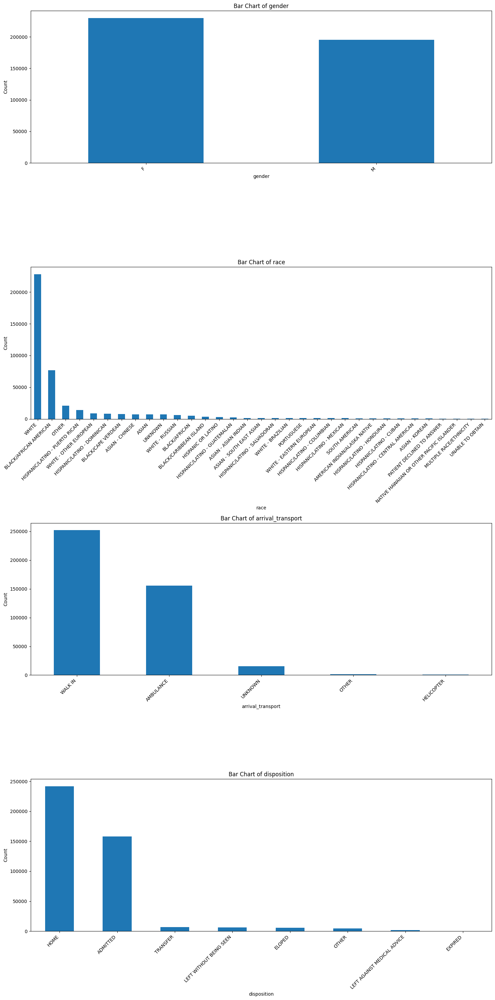

In [ ]:
# create bar charts for each of gender, race, arrival transport, disposition.  place them in a 4 x 1 grid.  adjust the x labels by 45 degrees. for numeric columns, order the bars by label value ascending (not by count) ...

# Define the columns to create bar charts for
categorical_cols = ['gender', 'race', 'arrival_transport', 'disposition']
numeric_cols = []

# Create a 6x1 grid for the subplots
fig, axes = plt.subplots(4, 1, figsize=(15, 30))

# Iterate through the columns and create bar charts
for i, col in enumerate(categorical_cols + numeric_cols):
  ax = axes[i]
  if col in categorical_cols:
    edstays_df[col].value_counts().plot(kind='bar', ax=ax)
  else:
    # For numeric columns, order the bars by label value
    edstays_df[col].value_counts().sort_index().plot(kind='bar', ax=ax)

  ax.set_title(f'Bar Chart of {col}')
  ax.set_xlabel(col)
  ax.set_ylabel('Count')
  plt.setp(ax.get_xticklabels(), rotation=45, ha="right")

plt.tight_layout()
plt.show()


##3.2 triage

In [ ]:
# check datatypes of all columns
triage_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 425087 entries, 0 to 425086
Data columns (total 11 columns):
 #   Column          Non-Null Count   Dtype  
---  ------          --------------   -----  
 0   subject_id      425087 non-null  int64  
 1   stay_id         425087 non-null  int64  
 2   temperature     401672 non-null  float64
 3   heartrate       407997 non-null  float64
 4   resprate        404734 non-null  float64
 5   o2sat           404491 non-null  float64
 6   sbp             406796 non-null  float64
 7   dbp             405996 non-null  float64
 8   pain            412154 non-null  object 
 9   acuity          418100 non-null  float64
 10  chiefcomplaint  425064 non-null  object 
dtypes: float64(7), int64(2), object(2)
memory usage: 35.7+ MB


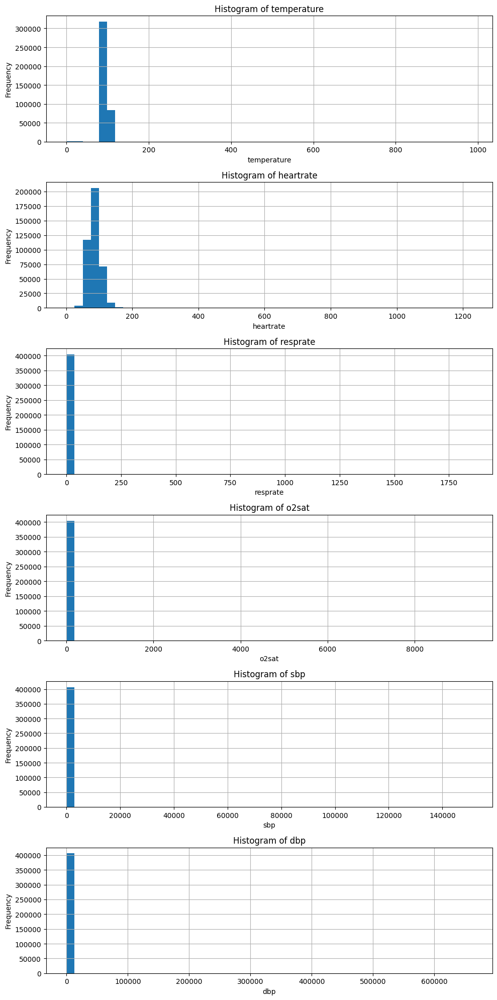

In [ ]:
# create histograms for each of temperature, heartrate, resprate, o2sat, sbp, dbp.  place them in a 6 x 1 grid.  ensure each histogram has 50 bins that are sized to include min and max values

# Define the columns for histograms
cols = ['temperature', 'heartrate', 'resprate', 'o2sat', 'sbp', 'dbp']

# Create a 6x1 grid for the subplots
fig, axes = plt.subplots(6, 1, figsize=(10, 20))

# Iterate through the columns and create histograms
for i, col in enumerate(cols):
    ax = axes[i]
    # Calculate the number of bins dynamically based on min and max values
    min_val = triage_df[col].min()
    max_val = triage_df[col].max()
    bin_width = (max_val - min_val) / 50
    bins = np.arange(min_val, max_val + bin_width, bin_width)

    triage_df[col].hist(bins=bins, ax=ax)
    ax.set_title(f'Histogram of {col}')
    ax.set_xlabel(col)
    ax.set_ylabel('Frequency')

plt.tight_layout()
plt.show()


##3.3 vitalsign

In [ ]:
# check datatypes of all columns
vitalsign_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1564610 entries, 0 to 1564609
Data columns (total 11 columns):
 #   Column       Non-Null Count    Dtype  
---  ------       --------------    -----  
 0   subject_id   1564610 non-null  int64  
 1   stay_id      1564610 non-null  int64  
 2   charttime    1564610 non-null  object 
 3   temperature  999642 non-null   float64
 4   heartrate    1494900 non-null  float64
 5   resprate     1475217 non-null  float64
 6   o2sat        1428774 non-null  float64
 7   sbp          1483354 non-null  float64
 8   dbp          1483354 non-null  float64
 9   rhythm       59650 non-null    object 
 10  pain         1121344 non-null  object 
dtypes: float64(6), int64(2), object(3)
memory usage: 131.3+ MB


In [ ]:
# convert chartime to datetime objects
vitalsign_df['charttime'] = pd.to_datetime(vitalsign_df['charttime'], format='%Y-%m-%d %H:%M:%S', errors='coerce')

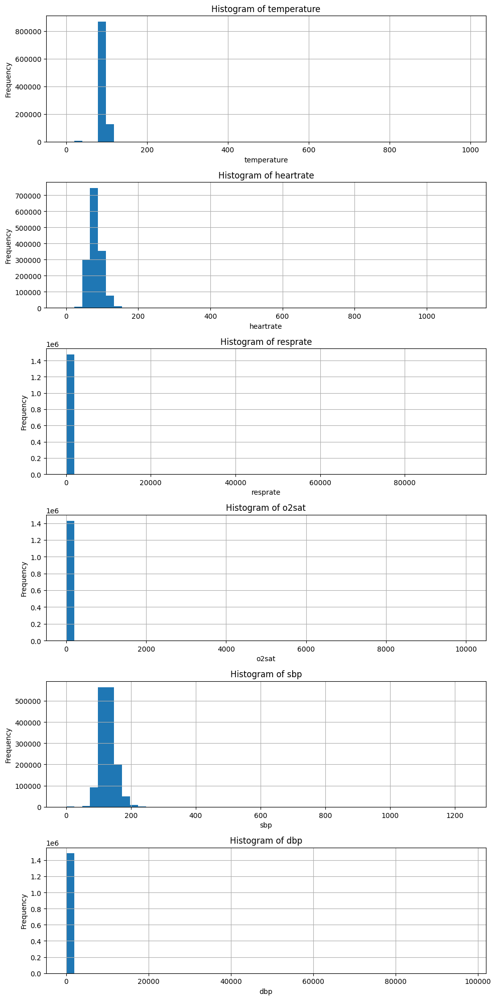

In [ ]:
# create histograms for each of temperature, heartrate, resprate, o2sat, sbp, dbp.  place them in a 6 x 1 grid.  ensure each histogram has 50 bins that are sized to include min and max values

# Define the columns for histograms
cols = ['temperature', 'heartrate', 'resprate', 'o2sat', 'sbp', 'dbp']

# Create a 6x1 grid for the subplots
fig, axes = plt.subplots(6, 1, figsize=(10, 20))

# Iterate through the columns and create histograms
for i, col in enumerate(cols):
    ax = axes[i]
    # Calculate the number of bins dynamically based on min and max values
    min_val = vitalsign_df[col].min()
    max_val = vitalsign_df[col].max()
    bin_width = (max_val - min_val) / 50
    bins = np.arange(min_val, max_val + bin_width, bin_width)

    vitalsign_df[col].hist(bins=bins, ax=ax)
    ax.set_title(f'Histogram of {col}')
    ax.set_xlabel(col)
    ax.set_ylabel('Frequency')

plt.tight_layout()
plt.show()

##3.4 medrecon

In [ ]:
# check datatypes of all columns
medrecon_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2987342 entries, 0 to 2987341
Data columns (total 9 columns):
 #   Column          Dtype  
---  ------          -----  
 0   subject_id      int64  
 1   stay_id         int64  
 2   charttime       object 
 3   name            object 
 4   gsn             int64  
 5   ndc             int64  
 6   etc_rn          int64  
 7   etccode         float64
 8   etcdescription  object 
dtypes: float64(1), int64(5), object(3)
memory usage: 205.1+ MB


In [ ]:
# print out the number of null values in any column of medrecon

# Check for null values in each column of medrecon_df
null_counts = medrecon_df.isnull().sum()

# Print the number of null values for each column
null_counts


,0
subject_id,0
stay_id,0
charttime,0
name,0
gsn,0
ndc,0
etc_rn,0
etccode,11728
etcdescription,11728


In [ ]:
# convert chartime to datetime objects
medrecon_df['charttime'] = pd.to_datetime(medrecon_df['charttime'], format='%Y-%m-%d %H:%M:%S', errors='coerce')

In [ ]:
# print out the number of unique gsns in medrecon - each value is a separate generic drug
print(len(medrecon_df['gsn'].unique()))

9179


In [ ]:
# print out the number of unique etccodes in medrecon - each value is a separate "therapeutic class"
print(len(medrecon_df['etccode'].unique()))

1202


## 3.5 pyxis

In [ ]:
# check datatypes of all columns
pyxis_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1586053 entries, 0 to 1586052
Data columns (total 7 columns):
 #   Column      Non-Null Count    Dtype  
---  ------      --------------    -----  
 0   subject_id  1586053 non-null  int64  
 1   stay_id     1586053 non-null  int64  
 2   charttime   1586053 non-null  object 
 3   med_rn      1586053 non-null  int64  
 4   name        1586053 non-null  object 
 5   gsn_rn      1586053 non-null  int64  
 6   gsn         1550601 non-null  float64
dtypes: float64(1), int64(4), object(2)
memory usage: 84.7+ MB


In [ ]:
# convert chartime to datetime objects
pyxis_df['charttime'] = pd.to_datetime(pyxis_df['charttime'], format='%Y-%m-%d %H:%M:%S', errors='coerce')

In [ ]:
# print out the number of unique gsns in pyxis - each value is a separate generic drug
print(len(pyxis_df['gsn'].unique()))

705


## 3.6 diagnosis

In [ ]:
# check datatypes of all columns
diagnosis_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 899050 entries, 0 to 899049
Data columns (total 6 columns):
 #   Column       Non-Null Count   Dtype 
---  ------       --------------   ----- 
 0   subject_id   899050 non-null  int64 
 1   stay_id      899050 non-null  int64 
 2   seq_num      899050 non-null  int64 
 3   icd_code     899050 non-null  object
 4   icd_version  899050 non-null  int64 
 5   icd_title    899050 non-null  object
dtypes: int64(4), object(2)
memory usage: 41.2+ MB


In [ ]:
# print out the number of unique icd_codes in diagnosis
print(len(diagnosis_df['icd_code'].unique()))

13199


## 3.7 admissions

In [ ]:
# check datatypes of all columns
admissions_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 546028 entries, 0 to 546027
Data columns (total 16 columns):
 #   Column                Non-Null Count   Dtype 
---  ------                --------------   ----- 
 0   subject_id            546028 non-null  int64 
 1   hadm_id               546028 non-null  int64 
 2   admittime             546028 non-null  object
 3   dischtime             546028 non-null  object
 4   deathtime             11790 non-null   object
 5   admission_type        546028 non-null  object
 6   admit_provider_id     546024 non-null  object
 7   admission_location    546027 non-null  object
 8   discharge_location    396210 non-null  object
 9   insurance             536673 non-null  object
 10  language              545253 non-null  object
 11  marital_status        532409 non-null  object
 12  race                  546028 non-null  object
 13  edregtime             379240 non-null  object
 14  edouttime             379240 non-null  object
 15  hospital_expire_f

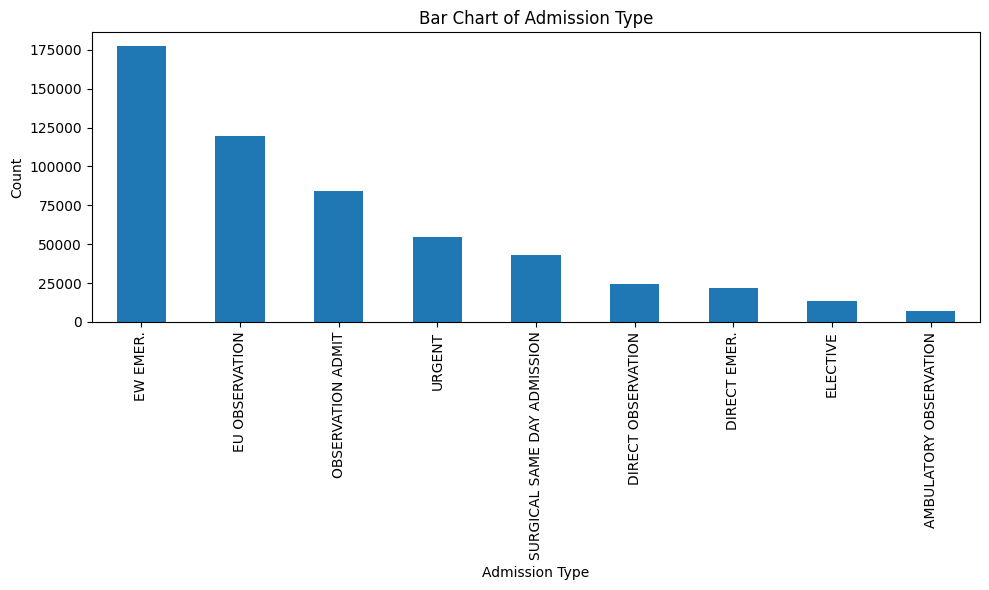

In [ ]:
# create a bar chart of admission_type

# Create a bar chart of admission_type
plt.figure(figsize=(10, 6))
admissions_df['admission_type'].value_counts().plot(kind='bar')
plt.xlabel('Admission Type')
plt.ylabel('Count')
plt.title('Bar Chart of Admission Type')
plt.xticks(rotation=90)
plt.tight_layout()
plt.show()


## 3.8 icustays

In [ ]:
# check datatypes of all columns
icustays_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 94458 entries, 0 to 94457
Data columns (total 8 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   subject_id      94458 non-null  int64  
 1   hadm_id         94458 non-null  int64  
 2   stay_id         94458 non-null  int64  
 3   first_careunit  94458 non-null  object 
 4   last_careunit   94458 non-null  object 
 5   intime          94458 non-null  object 
 6   outtime         94444 non-null  object 
 7   los             94444 non-null  float64
dtypes: float64(1), int64(3), object(4)
memory usage: 5.8+ MB


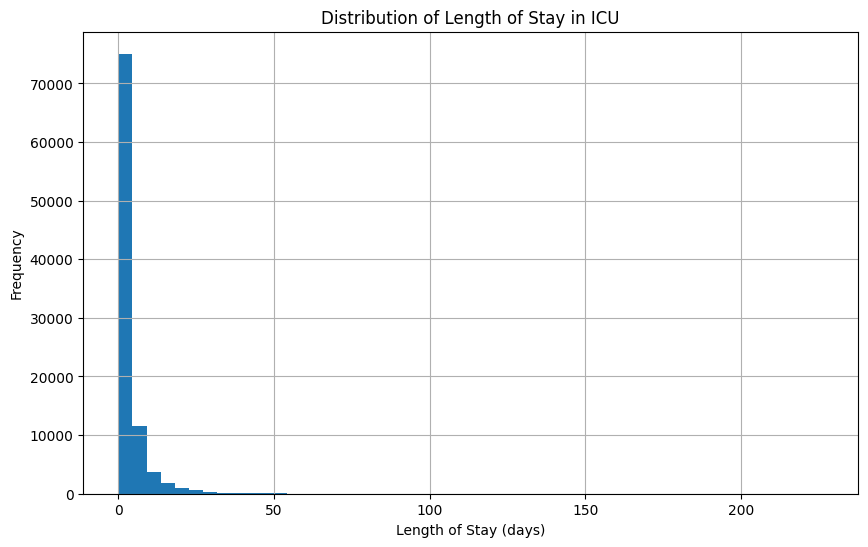

In [ ]:
# create a histogram for los from icustays

# Create a histogram of LOS
plt.figure(figsize=(10, 6))
icustays_df['los'].hist(bins=50)  # Adjust the number of bins as needed
plt.xlabel('Length of Stay (days)')
plt.ylabel('Frequency')
plt.title('Distribution of Length of Stay in ICU')
plt.show()


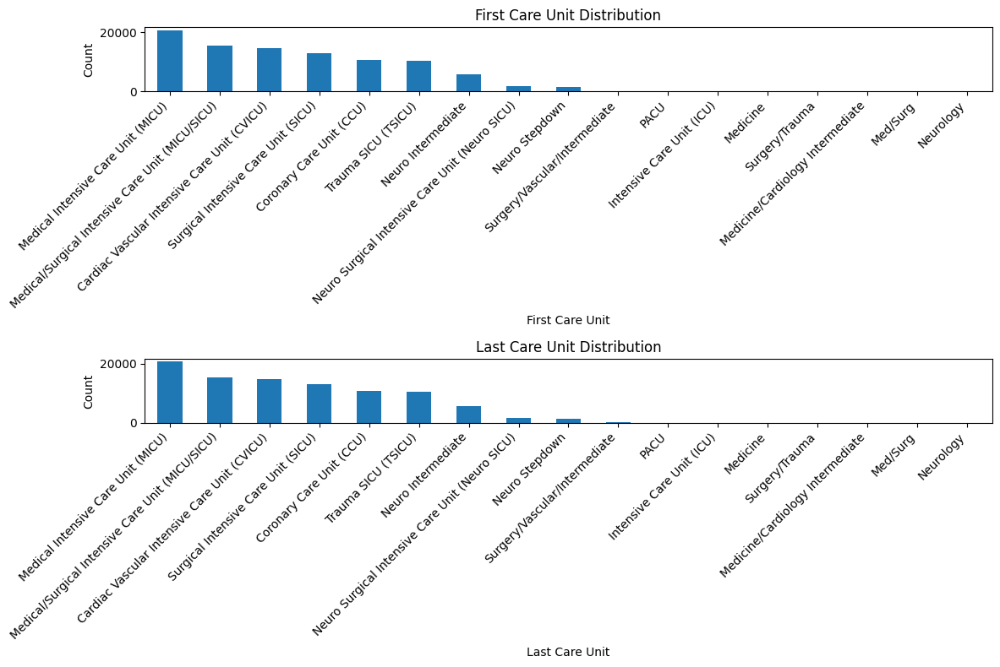

In [ ]:
# create 2 x bar charts using icustays_df and columns for first_careunit and last_careunit and show them on a 2 x 1 grid

plt.figure(figsize=(12, 8))

plt.subplot(2, 1, 1)
icustays_df['first_careunit'].value_counts().plot(kind='bar')
plt.title('First Care Unit Distribution')
plt.xlabel('First Care Unit')
plt.ylabel('Count')
plt.xticks(rotation=45, ha='right')

plt.subplot(2, 1, 2)
icustays_df['last_careunit'].value_counts().plot(kind='bar')
plt.title('Last Care Unit Distribution')
plt.xlabel('Last Care Unit')
plt.ylabel('Count')
plt.xticks(rotation=45, ha='right')

plt.tight_layout()
plt.show()


# **4. Pre-Processing**

This section includes pre-processing to join the data per ED visit from the various separate tables and build the "master dataframe" that will be used as input to the ML models. Includes handling of min/max/outliers/missing values and further feature engineering where required

##4.0 Data Cleaning

In this section we do some data cleaning including

*   edstays - drop records which have disposition = ADMITTED but no corresponding record in the hospital admissions table
*   triage - handle min/max/missing/outliers using the "expert" threshold values from Xie paper
*   vitalsigns - same as triage above



### 4.0.1 edstays

In [ ]:
edstays_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 425087 entries, 0 to 425086
Data columns (total 9 columns):
 #   Column             Non-Null Count   Dtype 
---  ------             --------------   ----- 
 0   subject_id         425087 non-null  int64 
 1   hadm_id            203016 non-null  Int64 
 2   stay_id            425087 non-null  int64 
 3   intime             425087 non-null  object
 4   outtime            425087 non-null  object
 5   gender             425087 non-null  object
 6   race               425087 non-null  object
 7   arrival_transport  425087 non-null  object
 8   disposition        425087 non-null  object
dtypes: Int64(1), int64(2), object(6)
memory usage: 29.6+ MB


In [ ]:
edstays_df.head()

,subject_id,hadm_id,stay_id,intime,outtime,gender,race,arrival_transport,disposition
0,10000032,22595853,33258284,2180-05-06 19:17:00,2180-05-06 23:30:00,F,WHITE,AMBULANCE,ADMITTED
1,10000032,22841357,38112554,2180-06-26 15:54:00,2180-06-26 21:31:00,F,WHITE,AMBULANCE,ADMITTED
2,10000032,25742920,35968195,2180-08-05 20:58:00,2180-08-06 01:44:00,F,WHITE,AMBULANCE,ADMITTED
3,10000032,29079034,32952584,2180-07-22 16:24:00,2180-07-23 05:54:00,F,WHITE,AMBULANCE,HOME
4,10000032,29079034,39399961,2180-07-23 05:54:00,2180-07-23 14:00:00,F,WHITE,AMBULANCE,ADMITTED


In [ ]:
admissions_df.head()

,subject_id,hadm_id,admittime,dischtime,deathtime,admission_type,admit_provider_id,admission_location,discharge_location,insurance,language,marital_status,race,edregtime,edouttime,hospital_expire_flag
0,10000032,22595853,2180-05-06 22:23:00,2180-05-07 17:15:00,NaN,URGENT,P49AFC,TRANSFER FROM HOSPITAL,HOME,Medicaid,English,WIDOWED,WHITE,2180-05-06 19:17:00,2180-05-06 23:30:00,0
1,10000032,22841357,2180-06-26 18:27:00,2180-06-27 18:49:00,NaN,EW EMER.,P784FA,EMERGENCY ROOM,HOME,Medicaid,English,WIDOWED,WHITE,2180-06-26 15:54:00,2180-06-26 21:31:00,0
2,10000032,25742920,2180-08-05 23:44:00,2180-08-07 17:50:00,NaN,EW EMER.,P19UTS,EMERGENCY ROOM,HOSPICE,Medicaid,English,WIDOWED,WHITE,2180-08-05 20:58:00,2180-08-06 01:44:00,0
3,10000032,29079034,2180-07-23 12:35:00,2180-07-25 17:55:00,NaN,EW EMER.,P06OTX,EMERGENCY ROOM,HOME,Medicaid,English,WIDOWED,WHITE,2180-07-23 05:54:00,2180-07-23 14:00:00,0
4,10000068,25022803,2160-03-03 23:16:00,2160-03-04 06:26:00,NaN,EU OBSERVATION,P39NWO,EMERGENCY ROOM,NaN,NaN,English,SINGLE,WHITE,2160-03-03 21:55:00,2160-03-04 06:26:00,0


In [ ]:
# print out the edstays records where disposition = "ADMITTED" but hadm_id = null

# Filter the DataFrame for the specified conditions
filtered_edstays = edstays_df[(edstays_df['disposition'] == 'ADMITTED') & (edstays_df['hadm_id'].isnull())]

# Print the filtered records
filtered_edstays


,subject_id,hadm_id,stay_id,intime,outtime,gender,race,arrival_transport,disposition
741,10015387,<NA>,32461132,2189-10-19 19:23:00,2189-10-19 20:33:00,F,BLACK/CARIBBEAN ISLAND,WALK IN,ADMITTED
2720,10062812,<NA>,31385201,2126-07-28 04:33:00,2126-07-29 07:19:00,M,UNKNOWN,UNKNOWN,ADMITTED
3030,10072167,<NA>,38575150,2152-12-15 05:23:00,2152-12-15 09:00:00,M,WHITE,AMBULANCE,ADMITTED
3524,10086015,<NA>,36854185,2137-01-06 16:45:00,2137-01-06 23:10:00,F,BLACK/AFRICAN AMERICAN,WALK IN,ADMITTED
5437,10133383,<NA>,37044813,2182-08-19 17:50:00,2182-08-20 00:25:00,F,OTHER,WALK IN,ADMITTED
...,...,...,...,...,...,...,...,...,...
420596,19895683,<NA>,35672300,2159-07-30 10:52:00,2159-07-30 14:01:00,M,WHITE,AMBULANCE,ADMITTED
421547,19915616,<NA>,30667267,2167-06-24 13:38:00,2167-06-24 16:10:00,M,WHITE,WALK IN,ADMITTED
422665,19938685,<NA>,34689310,2123-09-07 11:14:00,2123-09-07 11:49:00,F,HISPANIC/LATINO - DOMINICAN,WALK IN,ADMITTED
422885,19943634,<NA>,31685161,2193-02-23 15:04:00,2193-02-23 16:07:00,F,WHITE,UNKNOWN,ADMITTED


In [ ]:
# Drop the records from edstays_df where stay_id is in the filtered_edstays i.e. where disposition = 'ADMITTED' but there is no record in admissions_df
edstays_df = edstays_df[~edstays_df['stay_id'].isin(filtered_edstays['stay_id'])]


In [ ]:
# check the number of rows using the info() function
edstays_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 424703 entries, 0 to 425086
Data columns (total 9 columns):
 #   Column             Non-Null Count   Dtype 
---  ------             --------------   ----- 
 0   subject_id         424703 non-null  int64 
 1   hadm_id            203016 non-null  Int64 
 2   stay_id            424703 non-null  int64 
 3   intime             424703 non-null  object
 4   outtime            424703 non-null  object
 5   gender             424703 non-null  object
 6   race               424703 non-null  object
 7   arrival_transport  424703 non-null  object
 8   disposition        424703 non-null  object
dtypes: Int64(1), int64(2), object(6)
memory usage: 32.8+ MB


### 4.0.2 triage

In [ ]:
# check the number of rows and the datatypes in triage
triage_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 425087 entries, 0 to 425086
Data columns (total 11 columns):
 #   Column          Non-Null Count   Dtype  
---  ------          --------------   -----  
 0   subject_id      425087 non-null  int64  
 1   stay_id         425087 non-null  int64  
 2   temperature     401672 non-null  float64
 3   heartrate       407997 non-null  float64
 4   resprate        404734 non-null  float64
 5   o2sat           404491 non-null  float64
 6   sbp             406796 non-null  float64
 7   dbp             405996 non-null  float64
 8   pain            412154 non-null  object 
 9   acuity          418100 non-null  float64
 10  chiefcomplaint  425064 non-null  object 
dtypes: float64(7), int64(2), object(2)
memory usage: 35.7+ MB


In [ ]:
# print out the min/max/mean etc using the describe function
triage_df.describe()

,subject_id,stay_id,temperature,heartrate,resprate,o2sat,sbp,dbp,acuity
count,4.250870e+05,4.250870e+05,401672.000000,407997.000000,404734.000000,404491.000000,406796.000000,405996.000000,418100.000000
mean,1.500871e+07,3.499735e+07,98.015046,85.079891,17.565521,98.471888,135.395352,81.262126,2.625102
std,2.878486e+06,2.888342e+06,4.008575,18.041690,5.485706,17.040807,240.956408,1057.220031,0.708084
min,1.000003e+07,3.000001e+07,0.100000,1.000000,0.000000,0.000000,1.000000,0.000000,1.000000
25%,1.251789e+07,3.249799e+07,97.500000,72.000000,16.000000,97.000000,120.000000,68.000000,2.000000
50%,1.501628e+07,3.499395e+07,98.000000,84.000000,18.000000,99.000000,133.000000,77.000000,3.000000
75%,1.749900e+07,3.750387e+07,98.600000,96.000000,18.000000,100.000000,148.000000,87.000000,3.000000
max,1.999999e+07,3.999996e+07,986.000000,1228.000000,1820.000000,9322.000000,151103.000000,661672.000000,5.000000


In [ ]:
# print out the % of missing values (i.e. nulls) in each of temperature, heartrate, resprate, 02sat, sbp, dbp, pain, accuity and chiefcomplaint

cols_to_check = ['temperature', 'heartrate', 'resprate', 'o2sat', 'sbp', 'dbp', 'pain', 'acuity', 'chiefcomplaint']

for col in cols_to_check:
  if col in triage_df.columns:
    missing_percent = triage_df[col].isnull().sum() / len(triage_df) * 100
    print(f"Percentage of missing values in {col}: {missing_percent:.2f}%")
  else:
    print(f"Column '{col}' not found in the DataFrame.")


Percentage of missing values in temperature: 5.51%
Percentage of missing values in heartrate: 4.02%
Percentage of missing values in resprate: 4.79%
Percentage of missing values in o2sat: 4.85%
Percentage of missing values in sbp: 4.30%
Percentage of missing values in dbp: 4.49%
Percentage of missing values in pain: 3.04%
Percentage of missing values in acuity: 1.64%
Percentage of missing values in chiefcomplaint: 0.01%


In [ ]:
# print out the % of values which are non-numeric and not null in each of temperature, heartrate, resprate, 02sat, sbp, dbp, pain, accuity and chiefcomplaint

# Assuming 'triage_df' is already loaded as in the provided code.
cols_to_check = ['temperature', 'heartrate', 'resprate', 'o2sat', 'sbp', 'dbp', 'pain', 'acuity', 'chiefcomplaint']

for col in cols_to_check:
  if col in triage_df.columns:
    # Calculate the percentage of non-numeric and non-null values
    non_numeric_non_null = triage_df[~pd.to_numeric(triage_df[col], errors='coerce').notnull()][col].notnull().sum()
    total_non_null = triage_df[col].notnull().sum()
    if total_non_null > 0:  # Avoid division by zero if all values are null
      percentage = (non_numeric_non_null / total_non_null) * 100
      print(f"Percentage of non-numeric and not null values in {col}: {percentage:.2f}%")
    else:
      print(f"All values in '{col}' are null")
  else:
    print(f"Column '{col}' not found in the DataFrame.")


Percentage of non-numeric and not null values in temperature: 0.00%
Percentage of non-numeric and not null values in heartrate: 0.00%
Percentage of non-numeric and not null values in resprate: 0.00%
Percentage of non-numeric and not null values in o2sat: 0.00%
Percentage of non-numeric and not null values in sbp: 0.00%
Percentage of non-numeric and not null values in dbp: 0.00%
Percentage of non-numeric and not null values in pain: 3.68%
Percentage of non-numeric and not null values in acuity: 0.00%
Percentage of non-numeric and not null values in chiefcomplaint: 100.00%


In [ ]:
# set up the threshold values for the numeric columns - from the Xie paper (values have been agreed with medical subject matter experts)
vitals_valid_range = {
    'temperature': {'outlier_low': 14.2, 'valid_low': 26, 'valid_high': 45, 'outlier_high':47},
    'heartrate': {'outlier_low': 0, 'valid_low': 0, 'valid_high': 350, 'outlier_high':390},
    'resprate': {'outlier_low': 0, 'valid_low': 0, 'valid_high': 300, 'outlier_high':330},
    'o2sat': {'outlier_low': 0, 'valid_low': 0, 'valid_high': 100, 'outlier_high':150},
    'sbp': {'outlier_low': 0, 'valid_low': 0, 'valid_high': 375, 'outlier_high':375},
    'dbp': {'outlier_low': 0, 'valid_low': 0, 'valid_high': 375, 'outlier_high':375},
    'pain': {'outlier_low': 0, 'valid_low': 0, 'valid_high': 10, 'outlier_high':10},
    'acuity': {'outlier_low': 1, 'valid_low': 1, 'valid_high': 5, 'outlier_high':5},
}

In [ ]:
# Convert temperature from Fahrenheit to Celsius in triage_df
triage_df['temperature'] = (triage_df['temperature'] - 32) * 5/9

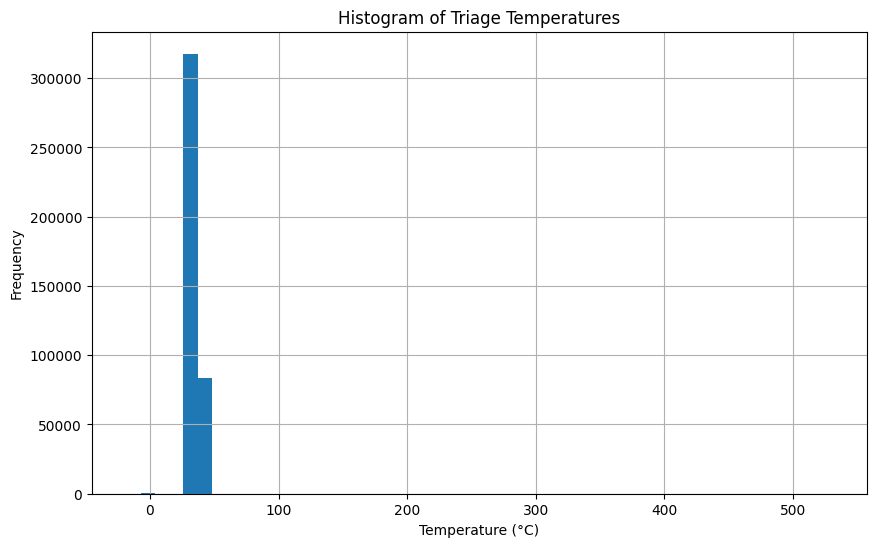

In [ ]:
# Create a histogram of triage temperatures
plt.figure(figsize=(10, 6))
triage_df['temperature'].hist(bins=50)  # Adjust the number of bins as needed
plt.xlabel('Temperature (°C)')
plt.ylabel('Frequency')
plt.title('Histogram of Triage Temperatures')
plt.show()


In [ ]:
# define a function to print out the # values in each of outlier categories ....
def display_outliers_count(df_master, vitals_valid_range):
    display_df = pd.DataFrame(columns=['variable', '< outlier_low', '[outlier_low, valid_low)',
                                       '[valid_low, valid_high]', '(valid_high, outlier_high]', '> outlier_high'])
    for column in df_master.columns:
        #print(f"Processing column: {column}")
        if column in vitals_valid_range:
            column_range = vitals_valid_range[column]
            #print(f"Column range: {column_range}")
            # Convert the column to numeric if possible
            df_master[column] = pd.to_numeric(df_master[column], errors='coerce')
            # Create a temporary DataFrame with the new row data
            new_row_df = pd.DataFrame([{'variable': column,
                                        '< outlier_low': len(df_master[df_master[column] < column_range['outlier_low']]),
                                        '[outlier_low, valid_low)': len(df_master[(column_range['outlier_low'] <= df_master[column])
                                                                                  & (df_master[column] < column_range['valid_low'])]),
                                        '[valid_low, valid_high]': len(df_master[(column_range['valid_low'] <= df_master[column])
                                                                                & (df_master[column] <= column_range['valid_high'])]),
                                        '(valid_high, outlier_high]': len(df_master[(column_range['valid_high'] < df_master[column])
                                                                                    & (df_master[column] <= column_range['outlier_high'])]),
                                        '> outlier_high': len(df_master[df_master[column] > column_range['outlier_high']])
                                        }])
            # Use pd.concat to add the new row to display_df
            display_df = pd.concat([display_df, new_row_df], ignore_index=True)
    return display_df

In [ ]:
# display summary of the # outliers per category ...
display_outliers_count(triage_df, vitals_valid_range)

,variable,< outlier_low,"[outlier_low, valid_low)","[valid_low, valid_high]","(valid_high, outlier_high]",> outlier_high
0,temperature,479,29,401155,0,9
1,heartrate,0,0,407990,0,7
2,resprate,0,0,404731,0,3
3,o2sat,0,0,404444,6,41
4,sbp,0,0,406780,0,16
5,dbp,0,0,405601,0,395
6,pain,2,0,385769,0,11202
7,acuity,0,0,418100,0,0


In [ ]:
# function to remove the outliers
def remove_outliers(df_master, vitals_valid_range):
    for column in df_master.columns:
        if column in vitals_valid_range:
            df_master[column] = pd.to_numeric(df_master[column], errors='coerce')
            df_master[column] = df_master[column].apply(outlier_removal_imputation(column, vitals_valid_range))
    return df_master

In [ ]:
# function to impute values
# if value outside the outlier high/low then set it = missing / null
# else if value is less than valid low or greater than valid high, then set it = valid low / high
# else keep the existing value
def outlier_removal_imputation(column, vitals_valid_range):
    column_range = vitals_valid_range[column]
    def outlier_removal_imputation_single_value(x):
        if x < column_range['outlier_low'] or x > column_range['outlier_high']:
            # set as missing
            return np.nan
        elif x < column_range['valid_low']:
            # impute with nearest valid value
            return column_range['valid_low']
        elif x > column_range['valid_high']:
            # impute with nearest valid value
            return column_range['valid_high']
        else:
            return x
    return outlier_removal_imputation_single_value

In [ ]:
# remove the outliers
triage_df = remove_outliers(triage_df, vitals_valid_range)

In [ ]:
# display new summary of the outliers ...
display_outliers_count(triage_df, vitals_valid_range)

,variable,< outlier_low,"[outlier_low, valid_low)","[valid_low, valid_high]","(valid_high, outlier_high]",> outlier_high
0,temperature,0,0,401184,0,0
1,heartrate,0,0,407990,0,0
2,resprate,0,0,404731,0,0
3,o2sat,0,0,404450,0,0
4,sbp,0,0,406780,0,0
5,dbp,0,0,405601,0,0
6,pain,0,0,385769,0,0
7,acuity,0,0,418100,0,0


In [ ]:
# display a few rows to check it all looks ok
triage_df.head()

,subject_id,stay_id,temperature,heartrate,resprate,o2sat,sbp,dbp,pain,acuity,chiefcomplaint
0,10000032,32952584,36.555556,87.0,14.0,97.0,71.0,43.0,7.0,2.0,Hypotension
1,10000032,33258284,36.888889,70.0,16.0,97.0,106.0,63.0,0.0,3.0,"Abd pain, Abdominal distention"
2,10000032,35968195,37.444444,105.0,18.0,96.0,106.0,57.0,10.0,3.0,"n/v/d, Abd pain"
3,10000032,38112554,37.166667,88.0,18.0,97.0,116.0,88.0,10.0,3.0,Abdominal distention
4,10000032,39399961,37.055556,77.0,16.0,98.0,96.0,50.0,NaN,2.0,"Abdominal distention, Abd pain, LETHAGIC"


In [ ]:
# Set non-numeric values in the 'acuity' and 'pain' columns to NaN
triage_df['acuity'] = pd.to_numeric(triage_df['acuity'], errors='coerce')
triage_df['pain'] = pd.to_numeric(triage_df['pain'], errors='coerce')

In [ ]:
triage_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 425087 entries, 0 to 425086
Data columns (total 11 columns):
 #   Column          Non-Null Count   Dtype  
---  ------          --------------   -----  
 0   subject_id      425087 non-null  int64  
 1   stay_id         425087 non-null  int64  
 2   temperature     401184 non-null  float64
 3   heartrate       407990 non-null  float64
 4   resprate        404731 non-null  float64
 5   o2sat           404450 non-null  float64
 6   sbp             406780 non-null  float64
 7   dbp             405601 non-null  float64
 8   pain            385769 non-null  float64
 9   acuity          418100 non-null  float64
 10  chiefcomplaint  425064 non-null  object 
dtypes: float64(8), int64(2), object(1)
memory usage: 35.7+ MB


In [ ]:
# Delete rows in triage_df where any of the columns have a null value
print(f"Number of rows before dropping nulls: {len(triage_df)}")
triage_df.dropna(inplace=True)
print(f"Number of rows after dropping nulls: {len(triage_df)}")

Number of rows before dropping nulls: 425087
Number of rows after dropping nulls: 369539


### 4.0.3 vitalsign

In [ ]:
# check the number of rows and the datatypes in vitalsign
vitalsign_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1564610 entries, 0 to 1564609
Data columns (total 11 columns):
 #   Column       Non-Null Count    Dtype         
---  ------       --------------    -----         
 0   subject_id   1564610 non-null  int64         
 1   stay_id      1564610 non-null  int64         
 2   charttime    1564610 non-null  datetime64[ns]
 3   temperature  999642 non-null   float64       
 4   heartrate    1494900 non-null  float64       
 5   resprate     1475217 non-null  float64       
 6   o2sat        1428774 non-null  float64       
 7   sbp          1483354 non-null  float64       
 8   dbp          1483354 non-null  float64       
 9   rhythm       59650 non-null    object        
 10  pain         1121344 non-null  object        
dtypes: datetime64[ns](1), float64(6), int64(2), object(2)
memory usage: 131.3+ MB


In [ ]:
# print out the min/max/mean etc using the describe function
vitalsign_df.describe()

,subject_id,stay_id,charttime,temperature,heartrate,resprate,o2sat,sbp,dbp
count,1.564610e+06,1.564610e+06,1564610,999642.000000,1.494900e+06,1.475217e+06,1.428774e+06,1.483354e+06,1.483354e+06
mean,1.500224e+07,3.500079e+07,2156-10-09 01:54:07.792989184,97.999308,8.122277e+01,1.777930e+01,9.791336e+01,1.284333e+02,7.435518e+01
min,1.000003e+07,3.000001e+07,2110-01-11 01:49:00,0.000000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
25%,1.251479e+07,3.249958e+07,2136-10-10 22:12:44.999999488,97.800000,6.900000e+01,1.600000e+01,9.700000e+01,1.130000e+02,6.300000e+01
50%,1.500674e+07,3.500071e+07,2156-09-07 11:16:00,98.100000,7.900000e+01,1.800000e+01,9.800000e+01,1.260000e+02,7.200000e+01
75%,1.748279e+07,3.750565e+07,2176-10-31 06:50:44.999999488,98.500000,9.100000e+01,1.800000e+01,1.000000e+02,1.420000e+02,8.200000e+01
max,1.999999e+07,3.999996e+07,2212-04-06 12:20:00,989.000000,1.109000e+03,9.445200e+04,9.997000e+03,1.234000e+03,9.710000e+04
std,2.873032e+06,2.888296e+06,NaN,8.193808,1.795872e+01,7.840819e+01,1.474334e+01,2.294265e+01,1.799864e+02


In [ ]:
# print out the % of missing values (i.e. nulls) in each of temperature, heartrate, resprate, 02sat, sbp, dbp, pain, accuity and chiefcomplaint

cols_to_check = ['temperature', 'heartrate', 'resprate', 'o2sat', 'sbp', 'dbp', 'pain']

for col in cols_to_check:
  if col in vitalsign_df.columns:
    missing_percent = vitalsign_df[col].isnull().sum() / len(vitalsign_df) * 100
    print(f"Percentage of missing values in {col}: {missing_percent:.2f}%")
  else:
    print(f"Column '{col}' not found in the DataFrame.")

Percentage of missing values in temperature: 36.11%
Percentage of missing values in heartrate: 4.46%
Percentage of missing values in resprate: 5.71%
Percentage of missing values in o2sat: 8.68%
Percentage of missing values in sbp: 5.19%
Percentage of missing values in dbp: 5.19%
Percentage of missing values in pain: 28.33%


In [ ]:
# print out the % of values which are non-numeric and not null in each of temperature, heartrate, resprate, 02sat, sbp, dbp, pain

# Assuming 'triage_df' is already loaded as in the provided code.
cols_to_check = ['temperature', 'heartrate', 'resprate', 'o2sat', 'sbp', 'dbp', 'pain']

for col in cols_to_check:
  if col in vitalsign_df.columns:
    # Calculate the percentage of non-numeric and non-null values
    non_numeric_non_null = vitalsign_df[~pd.to_numeric(vitalsign_df[col], errors='coerce').notnull()][col].notnull().sum()
    total_non_null = vitalsign_df[col].notnull().sum()
    if total_non_null > 0:  # Avoid division by zero if all values are null
      percentage = (non_numeric_non_null / total_non_null) * 100
      print(f"Percentage of non-numeric and not null values in {col}: {percentage:.2f}%")
    else:
      print(f"All values in '{col}' are null")
  else:
    print(f"Column '{col}' not found in the DataFrame.")


Percentage of non-numeric and not null values in temperature: 0.00%
Percentage of non-numeric and not null values in heartrate: 0.00%
Percentage of non-numeric and not null values in resprate: 0.00%
Percentage of non-numeric and not null values in o2sat: 0.00%
Percentage of non-numeric and not null values in sbp: 0.00%
Percentage of non-numeric and not null values in dbp: 0.00%
Percentage of non-numeric and not null values in pain: 10.63%


In [ ]:
# Convert temperature from Fahrenheit to Celsius in triage_df
vitalsign_df['temperature'] = (vitalsign_df['temperature'] - 32) * 5/9

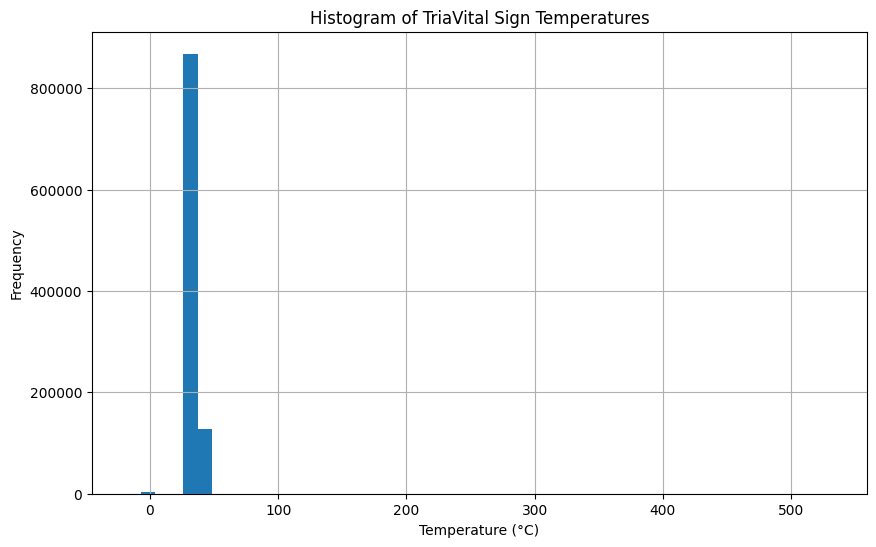

In [ ]:
# Create a histogram of triage temperatures
plt.figure(figsize=(10, 6))
vitalsign_df['temperature'].hist(bins=50)  # Adjust the number of bins as needed
plt.xlabel('Temperature (°C)')
plt.ylabel('Frequency')
plt.title('Histogram of TriaVital Sign Temperatures')
plt.show()


In [ ]:
# display summary of the # outliers per category ...
display_outliers_count(vitalsign_df, vitals_valid_range)

,variable,< outlier_low,"[outlier_low, valid_low)","[valid_low, valid_high]","(valid_high, outlier_high]",> outlier_high
0,temperature,4203,101,995247,3,88
1,heartrate,0,0,1494890,0,10
2,resprate,0,0,1475212,0,5
3,o2sat,0,0,1428736,5,33
4,sbp,0,0,1483350,0,4
5,dbp,0,0,1482476,0,878
6,pain,0,0,1002133,0,42


In [ ]:
# remove the outliers
vitalsign_df = remove_outliers(vitalsign_df, vitals_valid_range)

In [ ]:
# display new summary of the outliers ...
display_outliers_count(triage_df, vitals_valid_range)

,variable,< outlier_low,"[outlier_low, valid_low)","[valid_low, valid_high]","(valid_high, outlier_high]",> outlier_high
0,temperature,0,0,369539,0,0
1,heartrate,0,0,369539,0,0
2,resprate,0,0,369539,0,0
3,o2sat,0,0,369539,0,0
4,sbp,0,0,369539,0,0
5,dbp,0,0,369539,0,0
6,pain,0,0,369539,0,0
7,acuity,0,0,369539,0,0


In [ ]:
# display a few rows to check it all looks ok
vitalsign_df.head()

,subject_id,stay_id,charttime,temperature,heartrate,resprate,o2sat,sbp,dbp,rhythm,pain
0,10000032,32952584,2180-07-22 16:36:00,NaN,83.0,24.0,97.0,90.0,51.0,NaN,0.0
1,10000032,32952584,2180-07-22 16:43:00,NaN,85.0,22.0,98.0,76.0,39.0,NaN,0.0
2,10000032,32952584,2180-07-22 16:45:00,NaN,84.0,22.0,97.0,75.0,39.0,NaN,0.0
3,10000032,32952584,2180-07-22 17:56:00,NaN,84.0,20.0,99.0,86.0,51.0,NaN,NaN
4,10000032,32952584,2180-07-22 18:37:00,36.888889,86.0,20.0,98.0,65.0,37.0,NaN,NaN


In [ ]:
# Set non-numeric values in the 'pain' columns to NaN
vitalsign_df['pain'] = pd.to_numeric(vitalsign_df['pain'], errors='coerce')

In [ ]:
# drop the rhythym column
if 'rhythm' in vitalsign_df.columns:
  vitalsign_df = vitalsign_df.drop('rhythm', axis=1)

In [ ]:
vitalsign_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1564610 entries, 0 to 1564609
Data columns (total 10 columns):
 #   Column       Non-Null Count    Dtype         
---  ------       --------------    -----         
 0   subject_id   1564610 non-null  int64         
 1   stay_id      1564610 non-null  int64         
 2   charttime    1564610 non-null  datetime64[ns]
 3   temperature  995351 non-null   float64       
 4   heartrate    1494890 non-null  float64       
 5   resprate     1475212 non-null  float64       
 6   o2sat        1428741 non-null  float64       
 7   sbp          1483350 non-null  float64       
 8   dbp          1482476 non-null  float64       
 9   pain         1002133 non-null  float64       
dtypes: datetime64[ns](1), float64(7), int64(2)
memory usage: 119.4 MB


In [ ]:
# Delete rows in vitalsign_df where any of the columns have a null value
print(f"Number of rows before dropping nulls: {len(vitalsign_df)}")
vitalsign_df.dropna(inplace=True)
print(f"Number of rows after dropping nulls: {len(vitalsign_df)}")

Number of rows before dropping nulls: 1564610
Number of rows after dropping nulls: 667926


In [ ]:
# check for number of nulls and datatypes
vitalsign_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 667926 entries, 6 to 1564606
Data columns (total 10 columns):
 #   Column       Non-Null Count   Dtype         
---  ------       --------------   -----         
 0   subject_id   667926 non-null  int64         
 1   stay_id      667926 non-null  int64         
 2   charttime    667926 non-null  datetime64[ns]
 3   temperature  667926 non-null  float64       
 4   heartrate    667926 non-null  float64       
 5   resprate     667926 non-null  float64       
 6   o2sat        667926 non-null  float64       
 7   sbp          667926 non-null  float64       
 8   dbp          667926 non-null  float64       
 9   pain         667926 non-null  float64       
dtypes: datetime64[ns](1), float64(7), int64(2)
memory usage: 56.1 MB


In [ ]:
# prompt: for every row in edstays_df, do a count of the number of records in vitalsign_df which match on stay_id and add this as an extra column to edstays_df

# Group vitalsign_df by 'stay_id' and count the occurrences
vitalsign_counts = vitalsign_df.groupby('stay_id')['stay_id'].count().reset_index(name='vitalsign_count')

# Merge the counts back into edstays_df
edstays_df = pd.merge(edstays_df, vitalsign_counts, on='stay_id', how='left')

# Fill NaN values in 'vitalsign_count' with 0 (if a stay_id is not found in vitalsign_df)
edstays_df['vitalsign_count'].fillna(0, inplace=True)


<ipython-input-78-724300ae94b1>:10: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  edstays_df['vitalsign_count'].fillna(0, inplace=True)


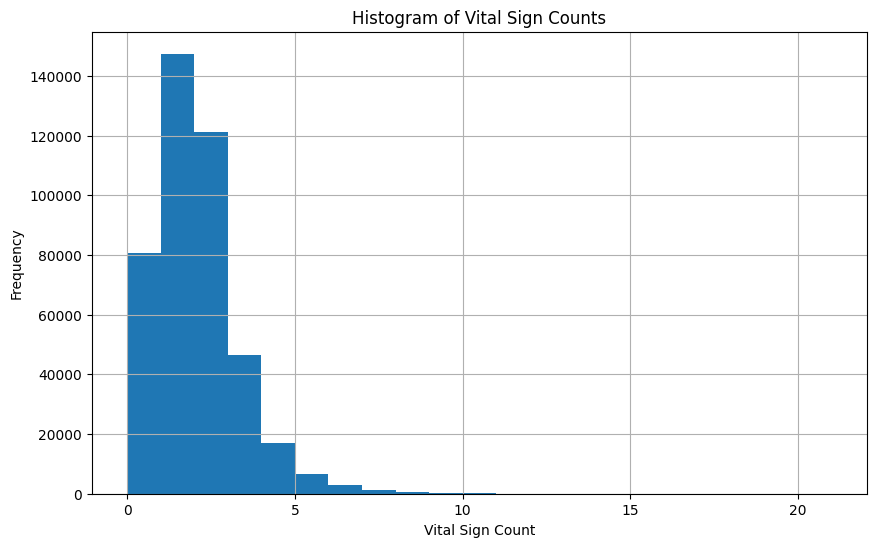

In [ ]:
# how a histogram for edstays_df['vitalsign_count'] with a bin size of 1
plt.figure(figsize=(10, 6))
edstays_df['vitalsign_count'].hist(bins=range(int(edstays_df['vitalsign_count'].min()), int(edstays_df['vitalsign_count'].max()) + 2))
plt.xlabel('Vital Sign Count')
plt.ylabel('Frequency')
plt.title('Histogram of Vital Sign Counts')
plt.show()


In [ ]:
# print out a count of records in edstays_df for each value in vitalsign_count ascending

# Group by 'vitalsign_count' and count the occurrences
vitalsign_count_summary = edstays_df.groupby('vitalsign_count')['vitalsign_count'].count().reset_index(name='record_count')

# Sort by 'vitalsign_count' in ascending order
vitalsign_count_summary = vitalsign_count_summary.sort_values('vitalsign_count')

# Print the summary
vitalsign_count_summary


,vitalsign_count,record_count
0,0.0,80573
1,1.0,147448
2,2.0,121378
3,3.0,46366
4,4.0,16936
5,5.0,6747
6,6.0,2799
7,7.0,1217
8,8.0,611
9,9.0,310


##4.1 Feature Engineering

In this section we perform feature engineering that incudes
*   edstays - new column for stay time in hours
*   edstays - new column to calculate the real patient age on day of ED visit, using the anchor age in the patient table   
   (and dropping any edstays record if the corresponding patient record is missing)
*   edstays - number of ED visits in the last 30/90/365 days - calculate these values and record in 3 x new columns
*   edstays - new column for race group
*   triage - new columns to show the number of characters and words in chief complaint
* triage - new column for chief complain class (using the classification generated separately by ChatGPT 4o)
* vitalsigns - creation of new dataframe to hold the values of the latest set of vital signs for each ED stay_id
*   medrecon - creation of a new dataframe to hold the count of previous medications for each ED stay_id
*   pyxis - creation of a new dataframe to hold the count of medications given while patient is in the ED for each stay_id
*   admissions - number of hospital admissions in the last 30/90/365 days - calculate these values and record in 3 x new columns
*   icu - number of ICU stays in the last 30/90/365 days - calculate these values and record in 3 x new columns






### 4.1.1 edstays / patient

#### Stay Time Hours

In [ ]:
# convert intime and outtime to datetime objects
edstays_df['intime'] = pd.to_datetime(edstays_df['intime'], format='%Y-%m-%d %H:%M:%S', errors='coerce')
edstays_df['outtime'] = pd.to_datetime(edstays_df['outtime'], format='%Y-%m-%d %H:%M:%S', errors='coerce')

In [ ]:
# calculate stay_time = outime - intime in hours
edstays_df['stay_time_hours'] = (edstays_df['outtime'] - edstays_df['intime']).dt.seconds / 3600


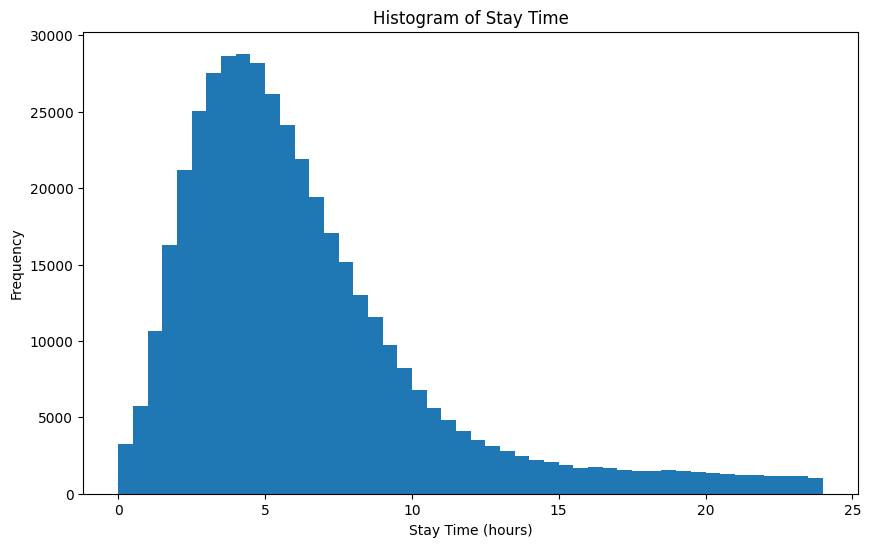

In [ ]:
# create a histogram for stay_time_hours with buckets of size 0.5 hours
plt.figure(figsize=(10, 6))
plt.hist(edstays_df['stay_time_hours'], bins=np.arange(edstays_df['stay_time_hours'].min(), edstays_df['stay_time_hours'].max() + 0.5, 0.5))
plt.xlabel('Stay Time (hours)')
plt.ylabel('Frequency')
plt.title('Histogram of Stay Time')
plt.show()

#### Age

In [ ]:
# print out a list of records in edstays_df where there is no matching record in patients_df,  using subject_id as the matching key

# Find rows in edstays_df with no matching subject_id in patients_df
missing_patients = edstays_df[~edstays_df['subject_id'].isin(patients_df['subject_id'])]

# Print the list of subject_ids from edstays_df that are not present in patients_df
missing_patients


,subject_id,hadm_id,stay_id,intime,outtime,gender,race,arrival_transport,disposition,vitalsign_count,stay_time_hours
478,10010663,22209635,38069845,2146-09-28 04:48:00,2146-09-28 23:55:39,F,HISPANIC/LATINO - GUATEMALAN,WALK IN,ADMITTED,1.0,19.127500
479,10010663,<NA>,32541009,2148-11-16 21:56:00,2148-11-17 03:13:00,F,HISPANIC/LATINO - GUATEMALAN,WALK IN,HOME,1.0,5.283333
480,10010663,<NA>,34448503,2144-11-19 18:05:00,2144-11-19 21:22:00,F,HISPANIC/LATINO - GUATEMALAN,WALK IN,HOME,1.0,3.283333
481,10010663,<NA>,37342540,2146-09-27 03:15:00,2146-09-27 08:29:00,F,HISPANIC/LATINO - GUATEMALAN,WALK IN,HOME,3.0,5.233333
9949,10246884,20330558,30078457,2172-03-24 01:42:00,2172-03-24 08:08:00,M,BLACK/AFRICAN AMERICAN,AMBULANCE,HOME,2.0,6.433333
...,...,...,...,...,...,...,...,...,...,...,...
381456,18971568,<NA>,30197314,2130-05-05 15:06:00,2130-05-05 19:21:00,F,WHITE,WALK IN,HOME,2.0,4.250000
382242,18992882,<NA>,39149470,2168-02-25 18:02:00,2168-02-25 21:27:00,M,OTHER,AMBULANCE,HOME,0.0,3.416667
393333,19257662,<NA>,39920504,2185-10-22 18:36:00,2185-10-22 22:36:00,F,OTHER,WALK IN,HOME,2.0,4.000000
423308,19965819,28425094,38077665,2164-02-08 04:10:00,2164-02-08 08:06:00,F,WHITE,AMBULANCE,ADMITTED,2.0,3.933333


In [ ]:
# do a merge with patients dataframe to bring in the anchor age and anchor age year  (note: how = inner means the 76 rows above will be dropped)
edstays_df = pd.merge(edstays_df, patients_df[['subject_id', 'anchor_age', 'anchor_year']], on='subject_id', how='inner')

In [ ]:
# calculate a new column called stay_age as the year part of intime - anchor year + anchor age.  the new column should have datatype of int64
edstays_df['stay_age'] = edstays_df['intime'].dt.year - edstays_df['anchor_year'] + edstays_df['anchor_age']

# Convert 'stay_age' to int64
edstays_df['stay_age'] = edstays_df['stay_age'].astype('Int64')

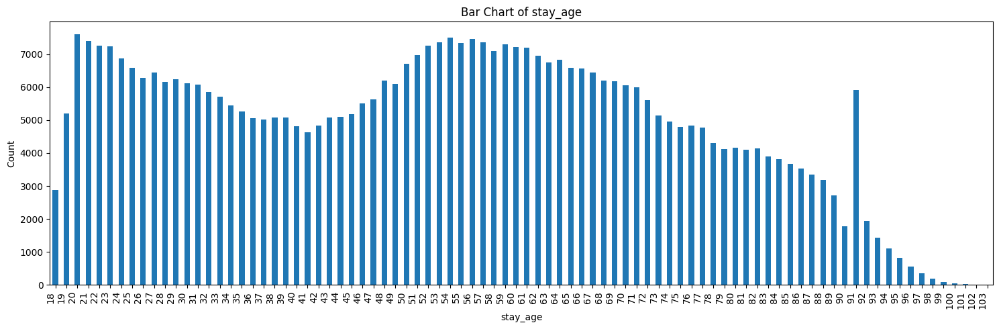

In [ ]:
# create bar chart for stay_age. adjust the x labels by 90 degrees. for numeric columns, order the bars by label value ascending (not by count) ...

# Define the columns to create bar charts for
categorical_cols = []
numeric_cols = ['stay_age']

# Create a 1x1 grid for the subplots
fig, ax = plt.subplots(1, 1, figsize=(15, 5))  # Changed axes to ax since it's a single subplot

# Iterate through the columns and create bar charts
edstays_df[numeric_cols[0]].value_counts().sort_index().plot(kind='bar', ax=ax)

ax.set_title(f'Bar Chart of {numeric_cols[0]}')
ax.set_xlabel(numeric_cols[0])
ax.set_ylabel('Count')
plt.setp(ax.get_xticklabels(), rotation=90, ha="right")

plt.tight_layout()
plt.show()

#### Number of ED Visits in Last 30/90/365 Days

In [ ]:
# for each record in edstays, create a merged dataframe also on edstays using subject_id and then for each edstay record, count the # od edstays past 30, 90, 365 days.
# use the intime column in edstays and the admittime column in admissions for this calculation.  store the 30, 90, 365 counts as additional columns in the edstays dataframe

# Ensure datetime format for both dataframes
edstays_df['intime'] = pd.to_datetime(edstays_df['intime'])

# Create a cross-dataframe with necessary info
# First create a merged dataframe of all possible combinations
merged_df = pd.merge(
    edstays_df[['subject_id', 'stay_id', 'intime']],
    edstays_df[['subject_id', 'intime']],
    on='subject_id'
)

In [ ]:
merged_df.head(50)

,subject_id,stay_id,intime_x,intime_y
0,10000032,33258284,2180-05-06 19:17:00,2180-05-06 19:17:00
1,10000032,33258284,2180-05-06 19:17:00,2180-06-26 15:54:00
2,10000032,33258284,2180-05-06 19:17:00,2180-08-05 20:58:00
3,10000032,33258284,2180-05-06 19:17:00,2180-07-22 16:24:00
4,10000032,33258284,2180-05-06 19:17:00,2180-07-23 05:54:00
5,10000032,38112554,2180-06-26 15:54:00,2180-05-06 19:17:00
6,10000032,38112554,2180-06-26 15:54:00,2180-06-26 15:54:00
7,10000032,38112554,2180-06-26 15:54:00,2180-08-05 20:58:00
8,10000032,38112554,2180-06-26 15:54:00,2180-07-22 16:24:00
9,10000032,38112554,2180-06-26 15:54:00,2180-07-23 05:54:00


In [ ]:
# Calculate time difference in days
merged_df['days_diff'] = (merged_df['intime_x'] - merged_df['intime_y']).dt.total_seconds() / (24 * 3600)

In [ ]:
# Keep only past admissions (positive days difference)
merged_df = merged_df[merged_df['days_diff'] > 0]

In [ ]:
# Create a function to calculate counts based on time windows
def calculate_counts(df):
#    Group by edstay's identifiers
    counts = df.groupby(['stay_id']).apply(
        lambda x: pd.Series({
            'ed_prev_30d_count': sum((x['days_diff'] <= 30)),
            'ed_prev_90d_count': sum((x['days_diff'] > 30) & (x['days_diff'] <= 90)),
            'ed_prev_365d_count': sum((x['days_diff'] > 90) & (x['days_diff'] <= 365))
        })
    ).reset_index()

    return counts

In [ ]:
# Calculate counts
counts_df = calculate_counts(merged_df)

<ipython-input-92-52f7c7eed1f6>:4: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  counts = df.groupby(['stay_id']).apply(


In [ ]:
counts_df.head()

,stay_id,ed_prev_30d_count,ed_prev_90d_count,ed_prev_365d_count
0,30000012,1,1,0
1,30000017,1,1,0
2,30000038,0,0,0
3,30000055,0,0,1
4,30000112,0,0,1


In [ ]:
# Merge the counts back to the original edstays dataframe
result_df = pd.merge(
    edstays_df,
    counts_df,
    on=['stay_id'],
    how='left'
)

In [ ]:
# Fill NaN values with 0 (for edstays with no prior admissions)
result_df['ed_prev_30d_count'] = result_df['ed_prev_30d_count'].fillna(0).astype(int)
result_df['ed_prev_90d_count'] = result_df['ed_prev_90d_count'].fillna(0).astype(int)
result_df['ed_prev_365d_count'] = result_df['ed_prev_365d_count'].fillna(0).astype(int)

In [ ]:
# Set edstays_df to now = the result_df with the counts
edstays_df = result_df

In [ ]:
edstays_df.head()

,subject_id,hadm_id,stay_id,intime,outtime,gender,race,arrival_transport,disposition,vitalsign_count,stay_time_hours,anchor_age,anchor_year,stay_age,ed_prev_30d_count,ed_prev_90d_count,ed_prev_365d_count
0,10000032,22595853,33258284,2180-05-06 19:17:00,2180-05-06 23:30:00,F,WHITE,AMBULANCE,ADMITTED,1.0,4.216667,52,2180,52,0,0,0
1,10000032,22841357,38112554,2180-06-26 15:54:00,2180-06-26 21:31:00,F,WHITE,AMBULANCE,ADMITTED,1.0,5.616667,52,2180,52,0,1,0
2,10000032,25742920,35968195,2180-08-05 20:58:00,2180-08-06 01:44:00,F,WHITE,AMBULANCE,ADMITTED,0.0,4.766667,52,2180,52,2,1,1
3,10000032,29079034,32952584,2180-07-22 16:24:00,2180-07-23 05:54:00,F,WHITE,AMBULANCE,HOME,1.0,13.500000,52,2180,52,1,1,0
4,10000032,29079034,39399961,2180-07-23 05:54:00,2180-07-23 14:00:00,F,WHITE,AMBULANCE,ADMITTED,0.0,8.100000,52,2180,52,2,1,0


In [ ]:
edstays_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 424627 entries, 0 to 424626
Data columns (total 17 columns):
 #   Column              Non-Null Count   Dtype         
---  ------              --------------   -----         
 0   subject_id          424627 non-null  int64         
 1   hadm_id             202990 non-null  Int64         
 2   stay_id             424627 non-null  int64         
 3   intime              424627 non-null  datetime64[ns]
 4   outtime             424627 non-null  datetime64[ns]
 5   gender              424627 non-null  object        
 6   race                424627 non-null  object        
 7   arrival_transport   424627 non-null  object        
 8   disposition         424627 non-null  object        
 9   vitalsign_count     424627 non-null  float64       
 10  stay_time_hours     424627 non-null  float64       
 11  anchor_age          424627 non-null  int64         
 12  anchor_year         424627 non-null  int64         
 13  stay_age            424627 no

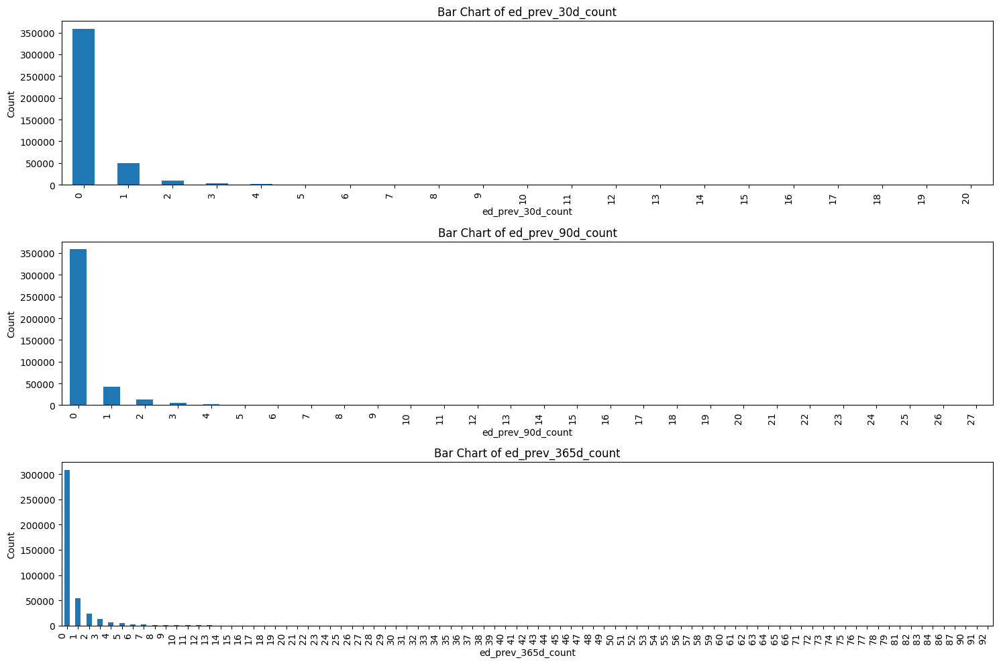

In [ ]:
# create bar charts for each 30/90/365 counts.  place them in a 3 x 1 grid.  adjust the x labels by 90 degrees. for numeric columns, order the bars by label value ascending (not by count) ...

# Define the columns to create bar charts for
categorical_cols = []
numeric_cols = ['ed_prev_30d_count', 'ed_prev_90d_count', 'ed_prev_365d_count']

# Create a 6x1 grid for the subplots
fig, axes = plt.subplots(3, 1, figsize=(15, 10))

# Iterate through the columns and create bar charts
for i, col in enumerate(categorical_cols + numeric_cols):
  ax = axes[i]
  if col in categorical_cols:
    edstays_df[col].value_counts().plot(kind='bar', ax=ax)
  else:
    # For numeric columns, order the bars by label value
    edstays_df[col].value_counts().sort_index().plot(kind='bar', ax=ax)

  ax.set_title(f'Bar Chart of {col}')
  ax.set_xlabel(col)
  ax.set_ylabel('Count')
  plt.setp(ax.get_xticklabels(), rotation=90, ha="right")

plt.tight_layout()
plt.show()


In [ ]:
# check the min/max/mean etc using the describe function
edstays_df.describe()

,subject_id,hadm_id,stay_id,intime,outtime,vitalsign_count,stay_time_hours,anchor_age,anchor_year,stay_age,ed_prev_30d_count,ed_prev_90d_count,ed_prev_365d_count
count,4.246270e+05,202990.0,4.246270e+05,424627,424627,424627.000000,424627.000000,424627.000000,424627.000000,424627.0,424627.000000,424627.000000,424627.000000
mean,1.500866e+07,24994989.068925,3.499733e+07,2156-05-16 20:13:54.565724160,2156-05-17 03:23:22.004151296,1.571259,6.388325,50.339894,2153.342680,52.870018,0.238303,0.290921,0.874000
min,1.000003e+07,20000019.0,3.000001e+07,2110-01-11 01:45:00,2110-01-11 07:04:00,0.000000,0.000000,18.000000,2110.000000,18.0,0.000000,0.000000,0.000000
25%,1.251803e+07,22489808.5,3.249806e+07,2136-05-05 21:46:30,2136-05-06 10:20:00,1.000000,3.433333,32.000000,2133.000000,35.0,0.000000,0.000000,0.000000
50%,1.501590e+07,24999394.0,3.499411e+07,2156-05-06 14:34:00,2156-05-06 23:07:00,1.000000,5.316667,50.000000,2153.000000,54.0,0.000000,0.000000,0.000000
75%,1.749874e+07,27493895.75,3.750380e+07,2176-06-22 17:15:30,2176-06-22 21:57:00,2.000000,7.966667,66.000000,2173.000000,69.0,0.000000,0.000000,1.000000
max,1.999999e+07,29999809.0,3.999996e+07,2212-04-05 23:23:00,2212-04-06 14:20:00,20.000000,23.989722,91.000000,2208.000000,103.0,20.000000,27.000000,92.000000
std,2.878381e+06,2888734.388036,2.888349e+06,NaN,NaN,1.289712,4.394396,20.098135,23.745405,20.620131,0.783202,1.045246,3.011681


#### Race Group

In [ ]:
# Created a new feature column group_race by consolidating 30+ original race categories into
# 6 broader groups: White, Black/African American, Hispanic/Latino, Asian, Other, and Unknown.

def race_group(race):
    if 'WHITE' in race:
        return 'White'
    elif 'BLACK' in race or 'AFRICAN' in race:
        return 'Black/African American'
    elif 'HISPANIC' in race or 'LATINO' in race:
        return 'Hispanic/Latino'
    elif 'ASIAN' in race:
        return 'Asian'
    elif 'UNKNOWN' in race or 'UNABLE' in race or 'DECLINED' in race or 'MULTIPLE' in race or 'OTHER' in race:
        return 'Unknown'
    else:
        return 'Other'

edstays_df['race_group'] = edstays_df['race'].apply(race_group)

### 4.1.2   triage

In [ ]:
# calculate the number of characters and the number of words in chiefcomplaint and add these as further columns in triage_df called cc_num_chars and cc_num_words

# Calculate the number of characters and words in the 'chiefcomplaint' column
triage_df['cc_num_chars'] = triage_df['chiefcomplaint'].str.len()
triage_df['cc_num_words'] = triage_df['chiefcomplaint'].str.split().str.len()


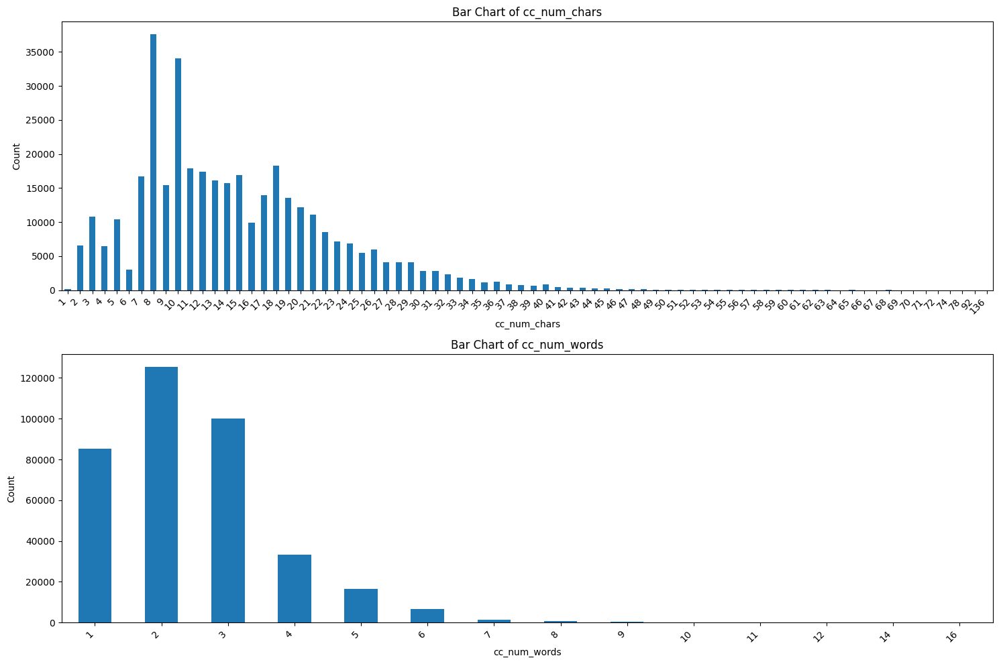

In [ ]:
# create bar charts for cc_num_chars and cc_num_words. place them in a 2 x 1 grid.

# Create a 3x1 grid for the subplots
fig, axes = plt.subplots(2, 1, figsize=(15, 10))

# Bar chart for cc_num_chars
triage_df['cc_num_chars'].value_counts().sort_index().plot(kind='bar', ax=axes[0])
axes[0].set_title('Bar Chart of cc_num_chars')
axes[0].set_xlabel('cc_num_chars')
axes[0].set_ylabel('Count')
plt.setp(axes[0].get_xticklabels(), rotation=45, ha="right")

# Bar chart for cc_num_words
triage_df['cc_num_words'].value_counts().sort_index().plot(kind='bar', ax=axes[1])
axes[1].set_title('Bar Chart of cc_num_words')
axes[1].set_xlabel('cc_num_words')
axes[1].set_ylabel('Count')
plt.setp(axes[1].get_xticklabels(), rotation=45, ha="right")

plt.tight_layout()
plt.show()


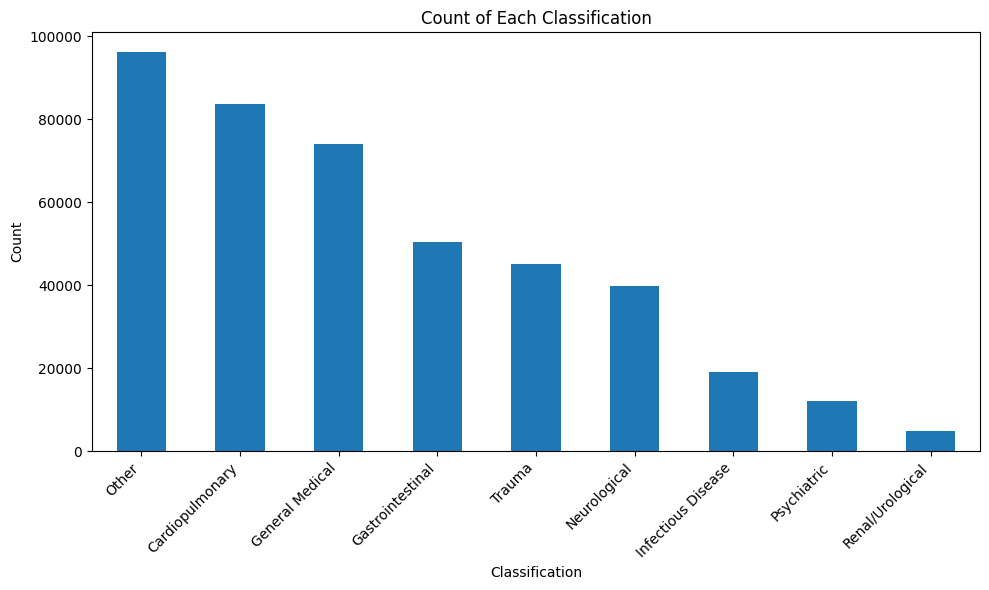

In [ ]:
# create a bar chart usiing triage_cc_classified_df with a bar for each value in "classification" column and a count of number of rows with that value

# Count occurrences of each classification
classification_counts = triage_cc_classified_df['classification'].value_counts()

# Create the bar chart
plt.figure(figsize=(10, 6))
classification_counts.plot(kind='bar')
plt.xlabel("Classification")
plt.ylabel("Count")
plt.title("Count of Each Classification")
plt.xticks(rotation=45, ha='right')  # Rotate x-axis labels for readability
plt.tight_layout()
plt.show()


In [ ]:
# merge triage_df with triage_cc_classified_df on stay_id and include just the classification column from triage_cc_classified_df
triage_df = pd.merge(triage_df, triage_cc_classified_df[['stay_id', 'classification']], on='stay_id', how='left')
triage_df.head()

,subject_id,stay_id,temperature,heartrate,resprate,o2sat,sbp,dbp,pain,acuity,chiefcomplaint,cc_num_chars,cc_num_words,classification
0,10000032,32952584,36.555556,87.0,14.0,97.0,71.0,43.0,7.0,2.0,Hypotension,11,1,General Medical
1,10000032,33258284,36.888889,70.0,16.0,97.0,106.0,63.0,0.0,3.0,"Abd pain, Abdominal distention",30,4,Cardiopulmonary
2,10000032,35968195,37.444444,105.0,18.0,96.0,106.0,57.0,10.0,3.0,"n/v/d, Abd pain",15,3,Gastrointestinal
3,10000032,38112554,37.166667,88.0,18.0,97.0,116.0,88.0,10.0,3.0,Abdominal distention,20,2,Cardiopulmonary
4,10000084,35203156,36.388889,78.0,16.0,100.0,114.0,71.0,0.0,2.0,"Confusion, Hallucinations",25,2,Neurological


In [ ]:
# rename all columns in triage_df that do not end with "_id" to have a prefix of "triage_" at the start of their column name

# Rename columns in triage_df
for col in triage_df.columns:
  if not col.endswith('_id'):
    triage_df = triage_df.rename(columns={col: 'triage_' + col})


In [ ]:
# rename triage_classification column to be called "triage_chief_complaint_class"

triage_df = triage_df.rename(columns={'triage_classification': 'triage_chiefcomplaint_class'})

In [ ]:
triage_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 369539 entries, 0 to 369538
Data columns (total 14 columns):
 #   Column                       Non-Null Count   Dtype  
---  ------                       --------------   -----  
 0   subject_id                   369539 non-null  int64  
 1   stay_id                      369539 non-null  int64  
 2   triage_temperature           369539 non-null  float64
 3   triage_heartrate             369539 non-null  float64
 4   triage_resprate              369539 non-null  float64
 5   triage_o2sat                 369539 non-null  float64
 6   triage_sbp                   369539 non-null  float64
 7   triage_dbp                   369539 non-null  float64
 8   triage_pain                  369539 non-null  float64
 9   triage_acuity                369539 non-null  float64
 10  triage_chiefcomplaint        369539 non-null  object 
 11  triage_cc_num_chars          369539 non-null  int64  
 12  triage_cc_num_words          369539 non-null  int64  
 13 

### 4.1.3 vitalsigns

In [ ]:
# create a new dataframe called vitalsign_info with first column stay_id and then a second column called count_of_signs which is a count of the number of records in vitalsign_df that given stay_id
vitalsign_count = vitalsign_df.groupby('stay_id')['stay_id'].count().reset_index(name='count_of_signs')

In [ ]:
vitalsign_count.head()

,stay_id,count_of_signs
0,30000012,2
1,30000017,1
2,30000038,2
3,30000039,2
4,30000094,2


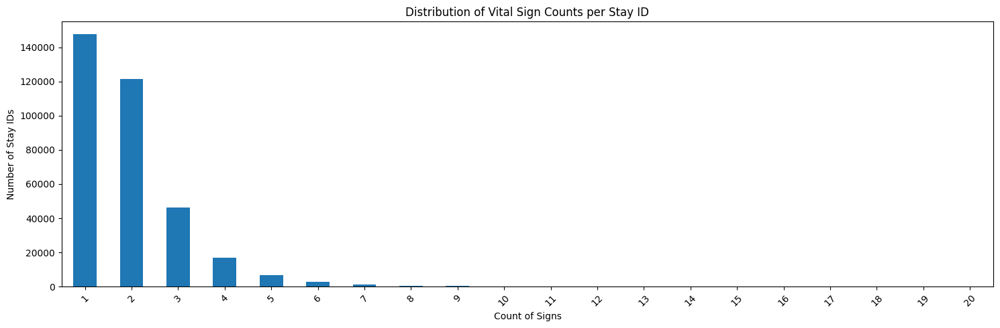

In [ ]:
# create a bar chart that shows the values of count_of_signs on the x axis and a count of the number of stay_ids with that value on the y

# Create the bar chart
plt.figure(figsize=(15, 5))
vitalsign_count['count_of_signs'].value_counts().sort_index().plot(kind='bar')
plt.xlabel('Count of Signs')
plt.ylabel('Number of Stay IDs')
plt.title('Distribution of Vital Sign Counts per Stay ID')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()


In [ ]:
# create a new dataframe to contain the last vital signs only

# first sort by stay_id and charttime in descending order
sorted_vitalsign_df = vitalsign_df.sort_values(['stay_id', 'charttime'], ascending=[True, False])

# then group by stay_id and get the first row of each group (which will be the latest record)
vitalsign_last_df = sorted_vitalsign_df.groupby('stay_id').first().reset_index()

In [ ]:
# print out a few rows ...
vitalsign_last_df.head()

,stay_id,subject_id,charttime,temperature,heartrate,resprate,o2sat,sbp,dbp,pain
0,30000012,11714491,2126-02-15 00:50:00,37.000000,88.0,16.0,100.0,135.0,51.0,0.0
1,30000017,14230614,2185-06-18 15:00:00,36.500000,70.0,20.0,97.0,142.0,90.0,0.0
2,30000038,13821532,2152-12-07 20:38:00,37.555556,80.0,20.0,96.0,144.0,59.0,5.0
3,30000039,13340997,2165-10-06 19:01:00,36.722222,81.0,22.0,97.0,147.0,85.0,0.0
4,30000094,19862552,2183-09-04 23:55:00,36.611111,79.0,20.0,98.0,129.0,75.0,0.0


In [ ]:
# test - print out the row from vitalsign_latest_df with stay_id = 32952584 - should show charttime of 19:47
print(vitalsign_last_df[vitalsign_last_df['stay_id'] == 32952584])


         stay_id  subject_id           charttime  temperature  heartrate  \
101851  32952584    10000032 2180-07-22 19:47:00    36.777778       85.0   

        resprate  o2sat   sbp   dbp  pain  
101851      18.0   98.0  81.0  38.0   0.0  


In [ ]:
# rename all columns that don't end in "_id" to have a prefix of "last_" at the start of their new column name

# Rename columns not ending in "_id" with "latest_" prefix
for col in vitalsign_last_df.columns:
    if not col.endswith("_id"):
        vitalsign_last_df.rename(columns={col: "last_" + col}, inplace=True)


In [ ]:
# check the data types
vitalsign_last_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 344427 entries, 0 to 344426
Data columns (total 10 columns):
 #   Column            Non-Null Count   Dtype         
---  ------            --------------   -----         
 0   stay_id           344427 non-null  int64         
 1   subject_id        344427 non-null  int64         
 2   last_charttime    344427 non-null  datetime64[ns]
 3   last_temperature  344427 non-null  float64       
 4   last_heartrate    344427 non-null  float64       
 5   last_resprate     344427 non-null  float64       
 6   last_o2sat        344427 non-null  float64       
 7   last_sbp          344427 non-null  float64       
 8   last_dbp          344427 non-null  float64       
 9   last_pain         344427 non-null  float64       
dtypes: datetime64[ns](1), float64(7), int64(2)
memory usage: 26.3 MB


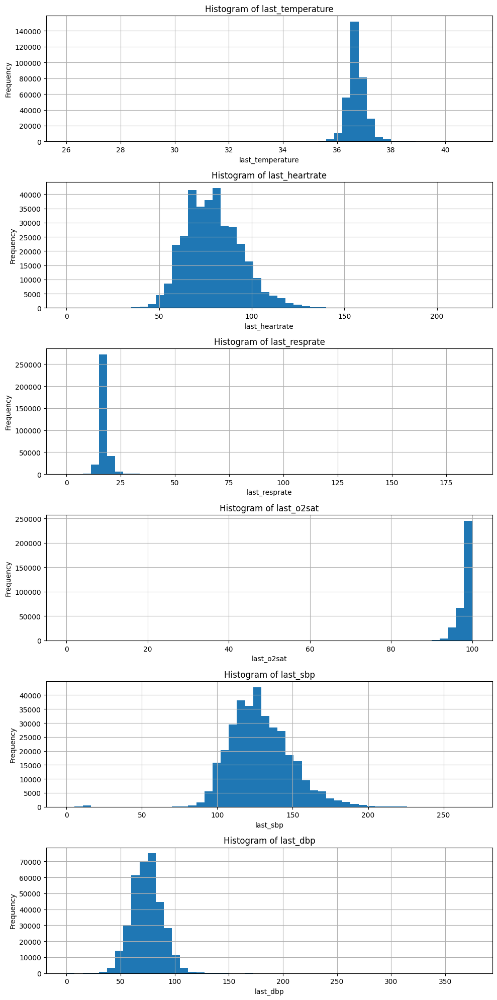

In [ ]:
# create histograms for each of temperature, heartrate, resprate, o2sat, sbp, dbp.  place them in a 6 x 1 grid.  ensure each histogram has 50 bins that are sized to include min and max values

# Define the columns for histograms
cols = ['last_temperature', 'last_heartrate', 'last_resprate', 'last_o2sat', 'last_sbp', 'last_dbp']

# Create a 6x1 grid for the subplots
fig, axes = plt.subplots(6, 1, figsize=(10, 20))

# Iterate through the columns and create histograms
for i, col in enumerate(cols):
    ax = axes[i]
    # Calculate the number of bins dynamically based on min and max values
    min_val = vitalsign_last_df[col].min()
    max_val = vitalsign_last_df[col].max()
    bin_width = (max_val - min_val) / 50
    bins = np.arange(min_val, max_val + bin_width, bin_width)

    vitalsign_last_df[col].hist(bins=bins, ax=ax)
    ax.set_title(f'Histogram of {col}')
    ax.set_xlabel(col)
    ax.set_ylabel('Frequency')

plt.tight_layout()
plt.show()


In [ ]:
# add columns to vitalsign_last_df for the min, max and average of the following columns in vitalsign_df - temperature, heartrate, resprate, o2sat, sbp, dbp, pain using stay_id to match between the two dataframes

columns_to_aggregate = ['temperature', 'heartrate', 'resprate', 'o2sat', 'sbp', 'dbp', 'pain']

for col in columns_to_aggregate:
    # Calculate min, max, and average for each stay_id in vitalsign_df
    agg_results = vitalsign_df.groupby('stay_id')[col].agg(['min', 'max', 'mean']).reset_index()

    # Rename the aggregated columns to avoid naming conflicts
    agg_results.rename(columns={
        'min': f'min_{col}',
        'max': f'max_{col}',
        'mean': f'avg_{col}'
    }, inplace=True)

    # Merge the aggregation results with vitalsign_last_df
    vitalsign_last_df = pd.merge(vitalsign_last_df, agg_results, on='stay_id', how='left')


In [ ]:
vitalsign_last_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 344427 entries, 0 to 344426
Data columns (total 31 columns):
 #   Column            Non-Null Count   Dtype         
---  ------            --------------   -----         
 0   stay_id           344427 non-null  int64         
 1   subject_id        344427 non-null  int64         
 2   last_charttime    344427 non-null  datetime64[ns]
 3   last_temperature  344427 non-null  float64       
 4   last_heartrate    344427 non-null  float64       
 5   last_resprate     344427 non-null  float64       
 6   last_o2sat        344427 non-null  float64       
 7   last_sbp          344427 non-null  float64       
 8   last_dbp          344427 non-null  float64       
 9   last_pain         344427 non-null  float64       
 10  min_temperature   344427 non-null  float64       
 11  max_temperature   344427 non-null  float64       
 12  avg_temperature   344427 non-null  float64       
 13  min_heartrate     344427 non-null  float64       
 14  max_

In [ ]:
vitalsign_last_df.head()

,stay_id,subject_id,last_charttime,last_temperature,last_heartrate,last_resprate,last_o2sat,last_sbp,last_dbp,last_pain,...,avg_o2sat,min_sbp,max_sbp,avg_sbp,min_dbp,max_dbp,avg_dbp,min_pain,max_pain,avg_pain
0,30000012,11714491,2126-02-15 00:50:00,37.000000,88.0,16.0,100.0,135.0,51.0,0.0,...,96.5,135.0,160.0,147.5,51.0,54.0,52.5,0.0,0.0,0.0
1,30000017,14230614,2185-06-18 15:00:00,36.500000,70.0,20.0,97.0,142.0,90.0,0.0,...,97.0,142.0,142.0,142.0,90.0,90.0,90.0,0.0,0.0,0.0
2,30000038,13821532,2152-12-07 20:38:00,37.555556,80.0,20.0,96.0,144.0,59.0,5.0,...,95.5,143.0,144.0,143.5,59.0,73.0,66.0,0.0,5.0,2.5
3,30000039,13340997,2165-10-06 19:01:00,36.722222,81.0,22.0,97.0,147.0,85.0,0.0,...,96.5,147.0,160.0,153.5,75.0,85.0,80.0,0.0,0.0,0.0
4,30000094,19862552,2183-09-04 23:55:00,36.611111,79.0,20.0,98.0,129.0,75.0,0.0,...,96.0,120.0,129.0,124.5,75.0,95.0,85.0,0.0,2.0,1.0


### 4.1.4 medrecon

In [ ]:
# create a new dataframe called gsn_count based on medrecon_df.  the first column is stay_id and then add a second column called count_of_gsns which is a count of the number unique values of gsn in medrecon for each stay_id

medrecon_gsn_count = medrecon_df.groupby('stay_id')['gsn'].nunique().reset_index(name='medrecon_gsn_count')
print(medrecon_gsn_count.head())


    stay_id  medrecon_gsn_count
0  30000012                   9
1  30000038                  10
2  30000039                   2
3  30000055                   1
4  30000094                   5


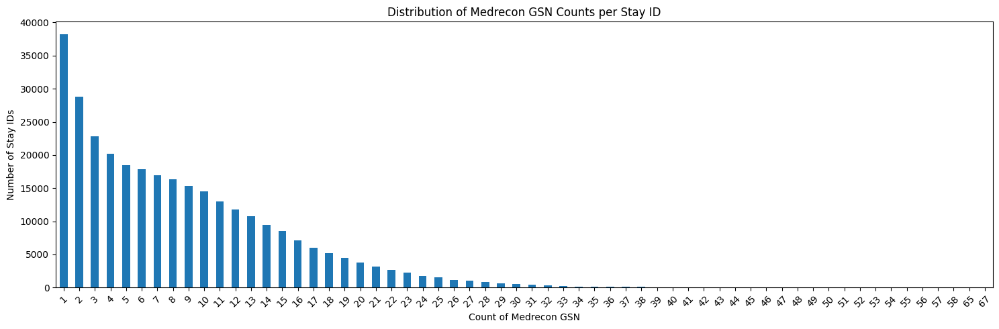

In [ ]:
# create a bar chart that shows the values of count_of_gsns on the x axis and a count of the number of stay_ids with that value on the y

# Create the bar chart
plt.figure(figsize=(15, 5))
medrecon_gsn_count['medrecon_gsn_count'].value_counts().sort_index().plot(kind='bar')
plt.xlabel('Count of Medrecon GSN')
plt.ylabel('Number of Stay IDs')
plt.title('Distribution of Medrecon GSN Counts per Stay ID')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()


In [ ]:
# create a new dataframe called etc_count based on medrecon_df.  the first column is stay_id and then add a second column called count_of_etcs which is a count of the number unique values of etccode in medrecon for each stay_id

medrecon_etc_count = medrecon_df.groupby('stay_id')['etccode'].nunique().reset_index(name='medrecon_etc_count')
print(medrecon_etc_count.head())

    stay_id  medrecon_etc_count
0  30000012                   9
1  30000038                  11
2  30000039                   2
3  30000055                   1
4  30000094                   6


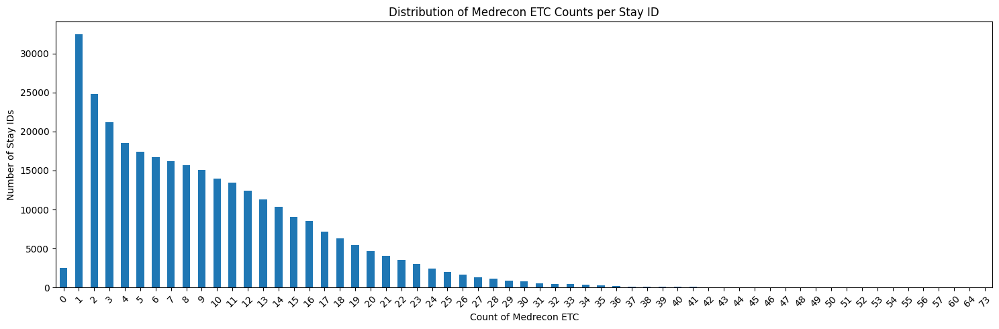

In [ ]:
# create a bar chart that shows the values of count_of_etcs on the x axis and a count of the number of stay_ids with that value on the y

# Create the bar chart
plt.figure(figsize=(15, 5))
medrecon_etc_count['medrecon_etc_count'].value_counts().sort_index().plot(kind='bar')
plt.xlabel('Count of Medrecon ETC')
plt.ylabel('Number of Stay IDs')
plt.title('Distribution of Medrecon ETC Counts per Stay ID')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

### 4.1.5 pyxis

In [ ]:
# create a new dataframe called gsn_count based on pyxis_df.  the first column is stay_id and then add a second column called count_of_gsns which is a count of the number unique values of gsn in pyxis_df for each stay_id

pyxis_gsn_count = pyxis_df.groupby('stay_id')['gsn'].nunique().reset_index(name='pyxis_gsn_count')
print(pyxis_gsn_count.head())


    stay_id  pyxis_gsn_count
0  30000012                2
1  30000017                6
2  30000038                0
3  30000039                3
4  30000094                1


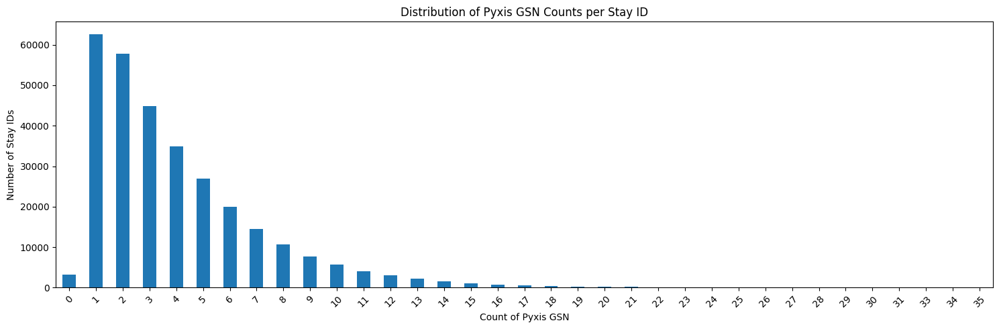

In [ ]:
# create a bar chart that shows the values of count_of_gsns on the x axis and a count of the number of stay_ids with that value on the y

# Create the bar chart
plt.figure(figsize=(15, 5))
pyxis_gsn_count['pyxis_gsn_count'].value_counts().sort_index().plot(kind='bar')
plt.xlabel('Count of Pyxis GSN')
plt.ylabel('Number of Stay IDs')
plt.title('Distribution of Pyxis GSN Counts per Stay ID')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()


In [ ]:
# create a new dataframe called icd_count based on diagnosis_df.  the first column is stay_id and then add a second column called count_of_icds which is a count of the number unique values of icd_code for each stay_id

icd_count = diagnosis_df.groupby('stay_id')['icd_code'].nunique().reset_index(name='count_of_icds')
print(icd_count.head())


    stay_id  count_of_icds
0  30000012              2
1  30000017              5
2  30000038              1
3  30000039              4
4  30000055              2


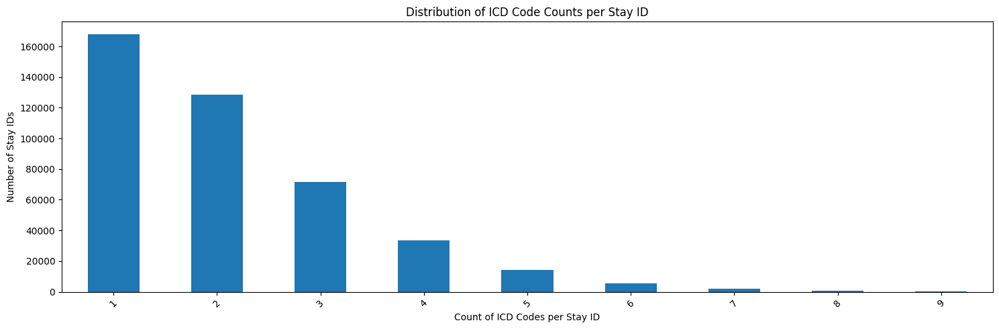

In [ ]:
# create a bar chart that shows the values of count_of_icds on the x axis and a count of the number of stay_ids with that value on the y

# Create the bar chart
plt.figure(figsize=(15, 5))
icd_count['count_of_icds'].value_counts().sort_index().plot(kind='bar')
plt.xlabel('Count of ICD Codes per Stay ID')
plt.ylabel('Number of Stay IDs')
plt.title('Distribution of ICD Code Counts per Stay ID')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()


### 4.1.6 admissions

In [ ]:
# for each record in edstays, count the records in admissions which match on subject_id and which occur in the past 30, 90, 365 days.
# use the intime column in edstays and the admittime column in admissions for this calculation.  store the 30, 90, 365 counts as additional columns in the edstays dataframe

# Ensure datetime format for both dataframes
edstays_df['intime'] = pd.to_datetime(edstays_df['intime'])
admissions_df['admittime'] = pd.to_datetime(admissions_df['admittime'])

# Create a cross-dataframe with necessary info
# First create a merged dataframe of all possible combinations
merged_df = pd.merge(
    edstays_df[['subject_id', 'stay_id', 'intime']],
    admissions_df[['subject_id', 'admittime']],
    on='subject_id'
)

# Calculate time difference in days
merged_df['days_diff'] = (merged_df['intime'] - merged_df['admittime']).dt.total_seconds() / (24 * 3600)

# Keep only past admissions (positive days difference)
merged_df = merged_df[merged_df['days_diff'] > 0]

# Create a function to calculate counts based on time windows
def calculate_counts(df):
    # Group by edstay's identifiers
    counts = df.groupby(['stay_id']).apply(
        lambda x: pd.Series({
            'admit_prev_30d_count': sum((x['days_diff'] <= 30)),
            'admit_prev_90d_count': sum((x['days_diff'] > 30) & (x['days_diff'] <= 90)),
            'admit_prev_365d_count': sum((x['days_diff'] > 90) & (x['days_diff'] <= 365))
        })
    ).reset_index()

    return counts

# Calculate counts
counts_df = calculate_counts(merged_df)

# Merge the counts back to the original edstays dataframe
result_df = pd.merge(
    edstays_df,
    counts_df,
    on=['stay_id'],
    how='left'
)

# Fill NaN values with 0 (for edstays with no prior admissions)
result_df['admit_prev_30d_count'] = result_df['admit_prev_30d_count'].fillna(0).astype(int)
result_df['admit_prev_90d_count'] = result_df['admit_prev_90d_count'].fillna(0).astype(int)
result_df['admit_prev_365d_count'] = result_df['admit_prev_365d_count'].fillna(0).astype(int)

# If you want to update the original dataframe
edstays_df = result_df

<ipython-input-130-71eea34a93cd>:25: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  counts = df.groupby(['stay_id']).apply(


In [ ]:
edstays_df.head(20)

,subject_id,hadm_id,stay_id,intime,outtime,gender,race,arrival_transport,disposition,vitalsign_count,...,anchor_age,anchor_year,stay_age,ed_prev_30d_count,ed_prev_90d_count,ed_prev_365d_count,race_group,admit_prev_30d_count,admit_prev_90d_count,admit_prev_365d_count
0,10000032,22595853,33258284,2180-05-06 19:17:00,2180-05-06 23:30:00,F,WHITE,AMBULANCE,ADMITTED,1.0,...,52,2180,52,0,0,0,White,0,0,0
1,10000032,22841357,38112554,2180-06-26 15:54:00,2180-06-26 21:31:00,F,WHITE,AMBULANCE,ADMITTED,1.0,...,52,2180,52,0,1,0,White,0,1,0
2,10000032,25742920,35968195,2180-08-05 20:58:00,2180-08-06 01:44:00,F,WHITE,AMBULANCE,ADMITTED,0.0,...,52,2180,52,2,1,1,White,1,1,1
3,10000032,29079034,32952584,2180-07-22 16:24:00,2180-07-23 05:54:00,F,WHITE,AMBULANCE,HOME,1.0,...,52,2180,52,1,1,0,White,1,1,0
4,10000032,29079034,39399961,2180-07-23 05:54:00,2180-07-23 14:00:00,F,WHITE,AMBULANCE,ADMITTED,0.0,...,52,2180,52,2,1,0,White,1,1,0
5,10000084,23052089,35203156,2160-11-20 20:36:00,2160-11-21 03:20:00,M,WHITE,WALK IN,ADMITTED,3.0,...,72,2160,72,0,0,0,White,0,0,0
6,10000084,29888819,36954971,2160-12-27 18:32:00,2160-12-28 16:07:00,M,WHITE,AMBULANCE,HOME,2.0,...,72,2160,72,0,1,0,White,0,1,0
7,10000108,27250926,36533795,2163-09-27 16:18:00,2163-09-28 09:04:00,M,WHITE,WALK IN,HOME,0.0,...,25,2163,25,2,0,0,White,0,0,0
8,10000108,<NA>,32522732,2163-09-16 16:34:00,2163-09-16 18:13:00,M,WHITE,WALK IN,HOME,1.0,...,25,2163,25,0,0,0,White,0,0,0
9,10000108,<NA>,39513268,2163-09-24 16:14:00,2163-09-24 21:02:00,M,WHITE,WALK IN,HOME,1.0,...,25,2163,25,1,0,0,White,0,0,0


### 4.1.7 icu_stays

In [ ]:
# for each record in edstays, count the records in icustays which match on subject_id and which occur in the past 30, 90, 365 days.
# use the intime column in edstays and the intime column in icustays for this calculation.  store the 30, 90, 365 counts as additional columns in the edstays dataframe

# Ensure datetime format for both dataframes
edstays_df['intime'] = pd.to_datetime(edstays_df['intime'])
icustays_df['intime'] = pd.to_datetime(icustays_df['intime'])

# Create a cross-dataframe with necessary info
# First create a merged dataframe of all possible combinations
merged_df = pd.merge(
    edstays_df[['subject_id', 'stay_id', 'intime']],
    icustays_df[['subject_id', 'intime']],
    on='subject_id',
    suffixes =('_ed', '_icu')
)

# Calculate time difference in days
merged_df['days_diff'] = (merged_df['intime_ed'] - merged_df['intime_icu']).dt.total_seconds() / (24 * 3600)

# Keep only past admissions (positive days difference)
merged_df = merged_df[merged_df['days_diff'] > 0]

# Create a function to calculate counts based on time windows
def calculate_counts(df):
    # Group by edstay's identifiers
    counts = df.groupby(['stay_id']).apply(
        lambda x: pd.Series({
            'icu_prev_30d_count': sum((x['days_diff'] <= 30)),
            'icu_prev_90d_count': sum((x['days_diff'] > 30) & (x['days_diff'] <= 90)),
            'icu_prev_365d_count': sum((x['days_diff'] > 90) & (x['days_diff'] <= 365))
        })
    ).reset_index()

    return counts

# Calculate counts
counts_df = calculate_counts(merged_df)

# Merge the counts back to the original edstays dataframe
result_df = pd.merge(
    edstays_df,
    counts_df,
    on=['stay_id'],
    how='left'
)

# Fill NaN values with 0 (for edstays with no prior admissions)
result_df['icu_prev_30d_count'] = result_df['icu_prev_30d_count'].fillna(0).astype(int)
result_df['icu_prev_90d_count'] = result_df['icu_prev_90d_count'].fillna(0).astype(int)
result_df['icu_prev_365d_count'] = result_df['icu_prev_365d_count'].fillna(0).astype(int)

# If you want to update the original dataframe
edstays_df = result_df

<ipython-input-132-6c5d20491036>:26: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  counts = df.groupby(['stay_id']).apply(


In [ ]:
merged_df.head()

,subject_id,stay_id,intime_ed,intime_icu,days_diff
2,10000032,35968195,2180-08-05 20:58:00,2180-07-23 14:00:00,13.290278
5,10000980,31236252,2193-08-14 21:25:00,2189-06-27 08:42:00,1509.529861
6,10000980,35392246,2190-11-06 15:30:00,2189-06-27 08:42:00,497.283333
7,10000980,38221815,2191-04-03 12:36:00,2189-06-27 08:42:00,645.162500
8,10000980,39129310,2191-05-22 16:06:00,2189-06-27 08:42:00,694.308333


In [ ]:
counts_df.head()

,stay_id,icu_prev_30d_count,icu_prev_90d_count,icu_prev_365d_count
0,30000012,1,0,0
1,30000177,0,1,4
2,30000275,0,0,0
3,30000317,0,0,0
4,30000535,0,0,1


In [ ]:
edstays_df.head(50)

,subject_id,hadm_id,stay_id,intime,outtime,gender,race,arrival_transport,disposition,vitalsign_count,...,ed_prev_30d_count,ed_prev_90d_count,ed_prev_365d_count,race_group,admit_prev_30d_count,admit_prev_90d_count,admit_prev_365d_count,icu_prev_30d_count,icu_prev_90d_count,icu_prev_365d_count
0,10000032,22595853,33258284,2180-05-06 19:17:00,2180-05-06 23:30:00,F,WHITE,AMBULANCE,ADMITTED,1.0,...,0,0,0,White,0,0,0,0,0,0
1,10000032,22841357,38112554,2180-06-26 15:54:00,2180-06-26 21:31:00,F,WHITE,AMBULANCE,ADMITTED,1.0,...,0,1,0,White,0,1,0,0,0,0
2,10000032,25742920,35968195,2180-08-05 20:58:00,2180-08-06 01:44:00,F,WHITE,AMBULANCE,ADMITTED,0.0,...,2,1,1,White,1,1,1,1,0,0
3,10000032,29079034,32952584,2180-07-22 16:24:00,2180-07-23 05:54:00,F,WHITE,AMBULANCE,HOME,1.0,...,1,1,0,White,1,1,0,0,0,0
4,10000032,29079034,39399961,2180-07-23 05:54:00,2180-07-23 14:00:00,F,WHITE,AMBULANCE,ADMITTED,0.0,...,2,1,0,White,1,1,0,0,0,0
5,10000084,23052089,35203156,2160-11-20 20:36:00,2160-11-21 03:20:00,M,WHITE,WALK IN,ADMITTED,3.0,...,0,0,0,White,0,0,0,0,0,0
6,10000084,29888819,36954971,2160-12-27 18:32:00,2160-12-28 16:07:00,M,WHITE,AMBULANCE,HOME,2.0,...,0,1,0,White,0,1,0,0,0,0
7,10000108,27250926,36533795,2163-09-27 16:18:00,2163-09-28 09:04:00,M,WHITE,WALK IN,HOME,0.0,...,2,0,0,White,0,0,0,0,0,0
8,10000108,<NA>,32522732,2163-09-16 16:34:00,2163-09-16 18:13:00,M,WHITE,WALK IN,HOME,1.0,...,0,0,0,White,0,0,0,0,0,0
9,10000108,<NA>,39513268,2163-09-24 16:14:00,2163-09-24 21:02:00,M,WHITE,WALK IN,HOME,1.0,...,1,0,0,White,0,0,0,0,0,0


In [ ]:
edstays_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 424627 entries, 0 to 424626
Data columns (total 24 columns):
 #   Column                 Non-Null Count   Dtype         
---  ------                 --------------   -----         
 0   subject_id             424627 non-null  int64         
 1   hadm_id                202990 non-null  Int64         
 2   stay_id                424627 non-null  int64         
 3   intime                 424627 non-null  datetime64[ns]
 4   outtime                424627 non-null  datetime64[ns]
 5   gender                 424627 non-null  object        
 6   race                   424627 non-null  object        
 7   arrival_transport      424627 non-null  object        
 8   disposition            424627 non-null  object        
 9   vitalsign_count        424627 non-null  float64       
 10  stay_time_hours        424627 non-null  float64       
 11  anchor_age             424627 non-null  int64         
 12  anchor_year            424627 non-null  int6

## 4.2 Master Dataframe (Draft)

In this section, we create the master dataframe by joining the edstays dataframe (using stay_id) with the other dataframes holding the additional features we want to include.

In [ ]:
# merge edstays_df with triage_df to create master_df.  use stay_id as the key to join on
master_df = pd.merge(edstays_df, triage_df, on='stay_id', how='inner')
master_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 369145 entries, 0 to 369144
Data columns (total 37 columns):
 #   Column                       Non-Null Count   Dtype         
---  ------                       --------------   -----         
 0   subject_id_x                 369145 non-null  int64         
 1   hadm_id                      166068 non-null  Int64         
 2   stay_id                      369145 non-null  int64         
 3   intime                       369145 non-null  datetime64[ns]
 4   outtime                      369145 non-null  datetime64[ns]
 5   gender                       369145 non-null  object        
 6   race                         369145 non-null  object        
 7   arrival_transport            369145 non-null  object        
 8   disposition                  369145 non-null  object        
 9   vitalsign_count              369145 non-null  float64       
 10  stay_time_hours              369145 non-null  float64       
 11  anchor_age                

In [ ]:
# merge master_df with vitalsign_latest_df.  use stay_id as the key to join on
master_df = pd.merge(master_df, vitalsign_last_df, on='stay_id', how='left')
master_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 369145 entries, 0 to 369144
Data columns (total 67 columns):
 #   Column                       Non-Null Count   Dtype         
---  ------                       --------------   -----         
 0   subject_id_x                 369145 non-null  int64         
 1   hadm_id                      166068 non-null  Int64         
 2   stay_id                      369145 non-null  int64         
 3   intime                       369145 non-null  datetime64[ns]
 4   outtime                      369145 non-null  datetime64[ns]
 5   gender                       369145 non-null  object        
 6   race                         369145 non-null  object        
 7   arrival_transport            369145 non-null  object        
 8   disposition                  369145 non-null  object        
 9   vitalsign_count              369145 non-null  float64       
 10  stay_time_hours              369145 non-null  float64       
 11  anchor_age                

In [ ]:
# merge master_df with medrecon_gsn_count.  use stay_id as the key to join on
master_df = pd.merge(master_df, medrecon_gsn_count, on='stay_id', how='left')
master_df.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 369145 entries, 0 to 369144
Data columns (total 68 columns):
 #   Column                       Non-Null Count   Dtype         
---  ------                       --------------   -----         
 0   subject_id_x                 369145 non-null  int64         
 1   hadm_id                      166068 non-null  Int64         
 2   stay_id                      369145 non-null  int64         
 3   intime                       369145 non-null  datetime64[ns]
 4   outtime                      369145 non-null  datetime64[ns]
 5   gender                       369145 non-null  object        
 6   race                         369145 non-null  object        
 7   arrival_transport            369145 non-null  object        
 8   disposition                  369145 non-null  object        
 9   vitalsign_count              369145 non-null  float64       
 10  stay_time_hours              369145 non-null  float64       
 11  anchor_age                

In [ ]:
# Replace null values in 'medrecon_gsn_count' with 0
master_df['medrecon_gsn_count'] = master_df['medrecon_gsn_count'].fillna(0)


In [ ]:
# merge master_df with pyxis_gsn_count.  use stay_id as the key to join on
master_df = pd.merge(master_df, pyxis_gsn_count, on='stay_id', how='left')
master_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 369145 entries, 0 to 369144
Data columns (total 69 columns):
 #   Column                       Non-Null Count   Dtype         
---  ------                       --------------   -----         
 0   subject_id_x                 369145 non-null  int64         
 1   hadm_id                      166068 non-null  Int64         
 2   stay_id                      369145 non-null  int64         
 3   intime                       369145 non-null  datetime64[ns]
 4   outtime                      369145 non-null  datetime64[ns]
 5   gender                       369145 non-null  object        
 6   race                         369145 non-null  object        
 7   arrival_transport            369145 non-null  object        
 8   disposition                  369145 non-null  object        
 9   vitalsign_count              369145 non-null  float64       
 10  stay_time_hours              369145 non-null  float64       
 11  anchor_age                

In [ ]:
# Replace null values in 'pyxis_gsn_count' with 0
master_df['pyxis_gsn_count'] = master_df['pyxis_gsn_count'].fillna(0)

In [ ]:
# change the datatype of columns triage_acuity, medrecon_gsn_count and pyxis_gsn_count to be int64

# Convert specified columns to int64, handling potential errors
for col in ['triage_acuity', 'medrecon_gsn_count', 'pyxis_gsn_count']:
    if col in master_df.columns:
        master_df[col] = pd.to_numeric(master_df[col], errors='coerce').astype('Int64')
    else:
        print(f"Warning: Column '{col}' not found in the DataFrame.")

master_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 369145 entries, 0 to 369144
Data columns (total 69 columns):
 #   Column                       Non-Null Count   Dtype         
---  ------                       --------------   -----         
 0   subject_id_x                 369145 non-null  int64         
 1   hadm_id                      166068 non-null  Int64         
 2   stay_id                      369145 non-null  int64         
 3   intime                       369145 non-null  datetime64[ns]
 4   outtime                      369145 non-null  datetime64[ns]
 5   gender                       369145 non-null  object        
 6   race                         369145 non-null  object        
 7   arrival_transport            369145 non-null  object        
 8   disposition                  369145 non-null  object        
 9   vitalsign_count              369145 non-null  float64       
 10  stay_time_hours              369145 non-null  float64       
 11  anchor_age                

In [ ]:
# drop columns called subject_id and subject_id_y
if 'subject_id' in master_df.columns:
  master_df = master_df.drop(columns=['subject_id'])
if 'subject_id_y' in master_df.columns:
  master_df = master_df.drop(columns=['subject_id_y'])

In [ ]:
# Rename the column 'subject_id_x' to 'subject_id'
master_df = master_df.rename(columns={'subject_id_x': 'subject_id'})


In [ ]:
# move the column in master_df called "disposition" so it is the last column but make sure not to lose the data in it
if 'disposition' in master_df.columns:
  disposition_col = master_df['disposition']
  master_df = master_df.drop(columns=['disposition'])
  master_df['disposition'] = disposition_col

In [ ]:
# print out all the master columns and datatypes
master_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 369145 entries, 0 to 369144
Data columns (total 67 columns):
 #   Column                       Non-Null Count   Dtype         
---  ------                       --------------   -----         
 0   subject_id                   369145 non-null  int64         
 1   hadm_id                      166068 non-null  Int64         
 2   stay_id                      369145 non-null  int64         
 3   intime                       369145 non-null  datetime64[ns]
 4   outtime                      369145 non-null  datetime64[ns]
 5   gender                       369145 non-null  object        
 6   race                         369145 non-null  object        
 7   arrival_transport            369145 non-null  object        
 8   vitalsign_count              369145 non-null  float64       
 9   stay_time_hours              369145 non-null  float64       
 10  anchor_age                   369145 non-null  int64         
 11  anchor_year               

In [ ]:
# drop columns that will not be needed or used by the ML models we are going to develop
# columns to drop = 'subject_id', 'hadm_id', 'intime', 'outtime', 'vital_sign_count', 'anchor_age', 'anchor_year', 'race', 'last_charttime', 'triage_cc_num_chars', 'triage_cc_num_words', 'triage_chief_complaint'
columns_to_drop = ['subject_id', 'hadm_id', 'intime', 'outtime', 'vitalsign_count', 'anchor_age', 'anchor_year', 'race', 'last_charttime', 'triage_cc_num_chars', 'triage_cc_num_words', 'triage_chiefcomplaint']
master_df = master_df.drop(columns=columns_to_drop, errors='ignore')


In [ ]:
master_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 369145 entries, 0 to 369144
Data columns (total 55 columns):
 #   Column                       Non-Null Count   Dtype  
---  ------                       --------------   -----  
 0   stay_id                      369145 non-null  int64  
 1   gender                       369145 non-null  object 
 2   arrival_transport            369145 non-null  object 
 3   stay_time_hours              369145 non-null  float64
 4   stay_age                     369145 non-null  Int64  
 5   ed_prev_30d_count            369145 non-null  int64  
 6   ed_prev_90d_count            369145 non-null  int64  
 7   ed_prev_365d_count           369145 non-null  int64  
 8   race_group                   369145 non-null  object 
 9   admit_prev_30d_count         369145 non-null  int64  
 10  admit_prev_90d_count         369145 non-null  int64  
 11  admit_prev_365d_count        369145 non-null  int64  
 12  icu_prev_30d_count           369145 non-null  int64  
 13 

In [ ]:
# Drop rows where disposition is not "ADMITTED" or "HOME"
print(f"Number of rows before: {len(master_df)}")
master_df = master_df[master_df['disposition'].isin(['ADMITTED', 'HOME'])]
print(f"Number of rows after: {len(master_df)}")

Number of rows before: 369145
Number of rows after: 347975


In [ ]:
# Drop any rows with Nulls (this will impact stay_ids which did not have any vitalsigns records ....)
print(f"Number of rows before: {len(master_df)}")
master_df = master_df.dropna()
print(f"Number of rows after: {len(master_df)}")

Number of rows before: 347975
Number of rows after: 296274


## 4.3 Colinearity Checks

In this section, we assess the numeric columns for multicollinearity using the Panda's correlation function and the Variance Inflation Factor (VIF) function.  Any highly correlated columns will be removed later in Section 4.5.

#### 4.3.4.1 Correlation Matrix

In [ ]:
# Create a copy of master_df with only numeric columns
numeric_master_df = master_df.select_dtypes(include=np.number).copy()


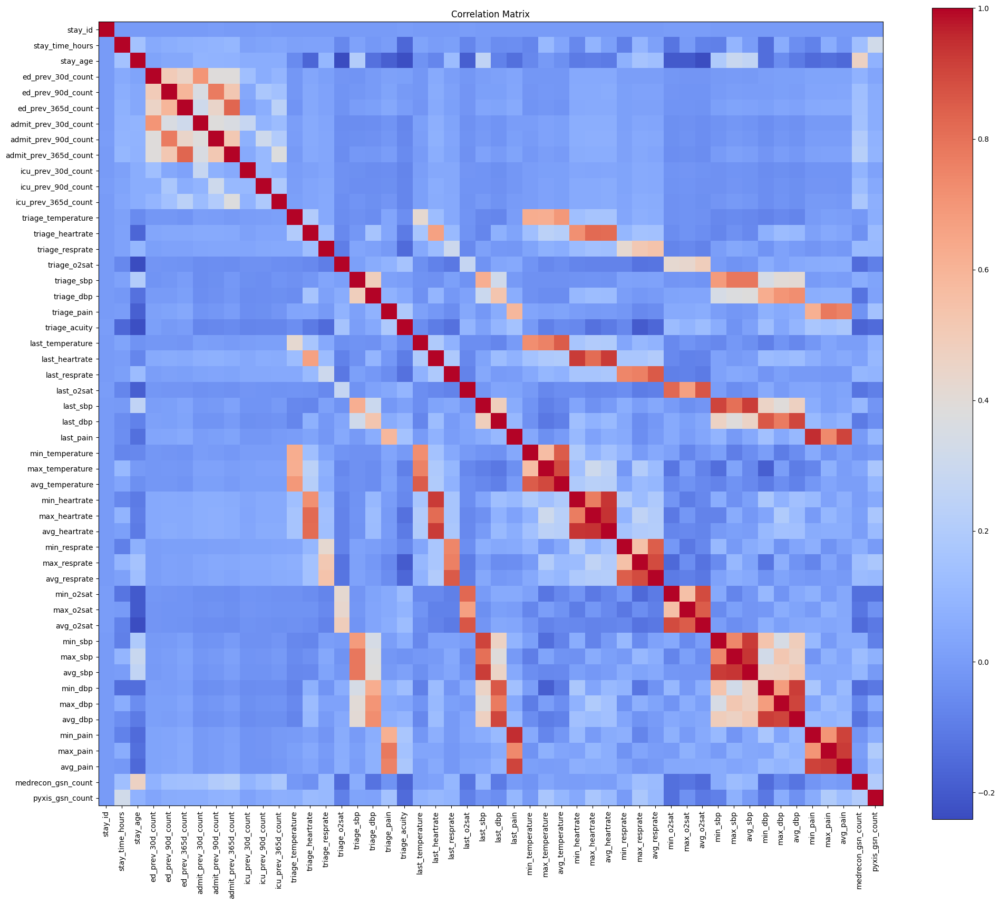

ed_prev_365d_count and admit_prev_365d_count are highly correlated: 0.83
admit_prev_365d_count and ed_prev_365d_count are highly correlated: 0.83
triage_heartrate and max_heartrate are highly correlated: 0.82
triage_heartrate and avg_heartrate are highly correlated: 0.81
last_temperature and avg_temperature are highly correlated: 0.85
last_heartrate and min_heartrate are highly correlated: 0.93
last_heartrate and max_heartrate are highly correlated: 0.81
last_heartrate and avg_heartrate are highly correlated: 0.93
last_resprate and avg_resprate are highly correlated: 0.86
last_o2sat and min_o2sat are highly correlated: 0.82
last_o2sat and avg_o2sat are highly correlated: 0.87
last_sbp and min_sbp are highly correlated: 0.90
last_sbp and max_sbp are highly correlated: 0.81
last_sbp and avg_sbp are highly correlated: 0.92
last_dbp and min_dbp are highly correlated: 0.86
last_dbp and avg_dbp are highly correlated: 0.90
last_pain and min_pain are highly correlated: 0.95
last_pain and avg_p

In [ ]:
# Correlation matrix

# Assuming your data is in a DataFrame called df
correlation_matrix = numeric_master_df.corr()

# Visualize the correlation matrix
plt.figure(figsize=(24, 20))
plt.imshow(correlation_matrix, cmap='coolwarm', interpolation='none')
plt.colorbar()
plt.title('Correlation Matrix')
plt.xticks(range(len(correlation_matrix.columns)), correlation_matrix.columns, rotation=90)
plt.yticks(range(len(correlation_matrix.index)), correlation_matrix.index)
plt.show()

# Optionally print highly correlated pairs
threshold = 0.8  # set threshold
high_corr = np.where((abs(correlation_matrix) > threshold) & (abs(correlation_matrix) < 1.0))
high_corr_pairs = [(correlation_matrix.index[x], correlation_matrix.columns[y], correlation_matrix.iloc[x, y]) for x, y in zip(*high_corr)]

for col1, col2, corr in high_corr_pairs:
    print(f"{col1} and {col2} are highly correlated: {corr:.2f}")

NOTE 1 - the matrix and the print out list of correlation scores shows high correlation for all the min/max/avg values from vital signs with each other and also with the corresponding sets of "last" values - so we will likely drop these from the final dataframe and just keep the set of vital signs from the actual Triage record itself.    

NOTE 2 - also seeing some correlation between the 30/90/365 day values for previous visits to ED/Hospital/ICU - but these could be represent valid events for patients who are regularly ill, so we will keep these in the data frame for the moment.

#### 4.3.4.2 Variance Inflation Factor (VIF)

In [ ]:
# Variance inflation factor (VIF)

def calculate_vif(df):

    # Only keep numeric columns and ensure they are of type float
    X = df.select_dtypes(include=[np.number]).astype(float)  # Explicitly convert to float

    # Add constant for stability (optional, but sometimes recommended)
    X = sm.add_constant(X)

    vif_data = pd.DataFrame()
    vif_data["Feature"] = X.columns
    vif_data["VIF"] = [variance_inflation_factor(X.values, i) for i in range(X.shape[1])]

    # Remove the constant from results if added
    vif_data = vif_data[vif_data["Feature"] != "const"]

    return vif_data

def categorize_vif(vif_data):
    low = vif_data[vif_data['VIF'] < 5]
    moderate = vif_data[(vif_data['VIF'] >= 5) & (vif_data['VIF'] < 10)]
    strong = vif_data[vif_data['VIF'] >= 10]

    print("\nLow Collinearity (VIF < 5):")
    print(low)

    print("\nModerate Collinearity (5 <= VIF < 10):")
    print(moderate)

    print("\nStrong Collinearity (VIF >= 10):")
    print(strong)

# Calculate VIF and show results
vif_results = calculate_vif(numeric_master_df)
categorize_vif(vif_results)



Low Collinearity (VIF < 5):
                  Feature       VIF
1                 stay_id  1.000165
2         stay_time_hours  1.231105
3                stay_age  1.689344
4       ed_prev_30d_count  2.485925
5       ed_prev_90d_count  3.463015
6      ed_prev_365d_count  4.145530
7    admit_prev_30d_count  2.311075
8    admit_prev_90d_count  3.165249
9   admit_prev_365d_count  4.157511
10     icu_prev_30d_count  1.114022
11     icu_prev_90d_count  1.162766
12    icu_prev_365d_count  1.236419
13     triage_temperature  2.473501
14       triage_heartrate  4.123222
15        triage_resprate  1.654972
16           triage_o2sat  1.533570
17             triage_sbp  4.044988
18             triage_dbp  3.149433
19            triage_pain  3.092051
20          triage_acuity  1.198125
21       last_temperature  4.579714
23          last_resprate  4.455158
24             last_o2sat  4.838996
49     medrecon_gsn_count  1.437066
50        pyxis_gsn_count  1.296987

Moderate Collinearity (5 <= VIF < 

## 4.4 Encodings

In this section, we perform one-hot encoding on our categorical variables

In [ ]:
# print out columns that are of type object
object_columns = master_df.select_dtypes(include=['object']).columns
object_columns


Index(['gender', 'arrival_transport', 'race_group',
       'triage_chiefcomplaint_class', 'disposition'],
      dtype='object')

In [ ]:
# Perform one-hot encoding on specified columns and drop the first category
categorical_cols = ['gender', 'arrival_transport', 'race_group', 'triage_chiefcomplaint_class']
master_df = pd.get_dummies(master_df, columns=categorical_cols, drop_first=True)


In [ ]:
# Perform one-hot encoding on disposition - don't drop first as we want to keep disposition_ADMITTED - and then we manually drop disposition_HOME
categorical_cols = ['disposition']
master_df = pd.get_dummies(master_df, columns=categorical_cols, drop_first=False)

In [ ]:
# drop the column 'disposition_HOME' from master_df
master_df = master_df.drop(columns=['disposition_HOME'], errors='ignore')


In [ ]:
master_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 296274 entries, 0 to 369143
Data columns (total 69 columns):
 #   Column                                          Non-Null Count   Dtype  
---  ------                                          --------------   -----  
 0   stay_id                                         296274 non-null  int64  
 1   stay_time_hours                                 296274 non-null  float64
 2   stay_age                                        296274 non-null  Int64  
 3   ed_prev_30d_count                               296274 non-null  int64  
 4   ed_prev_90d_count                               296274 non-null  int64  
 5   ed_prev_365d_count                              296274 non-null  int64  
 6   admit_prev_30d_count                            296274 non-null  int64  
 7   admit_prev_90d_count                            296274 non-null  int64  
 8   admit_prev_365d_count                           296274 non-null  int64  
 9   icu_prev_30d_count             

## 4.5 Final Master Dataframe

In this section, we build our final master data frame (dropping the highly correlated min/max/avg/last columns).    

We also decided to drop the columns for 'stay_time_hours' and 'pyxis_gsn_count' as our intial neural network experiments showed thay these were causing "leakage" and this model was over-fitting very quickly to the training data. We thus decided that our final data frame would contain just data values that are known at the actual time of triage and that our prediction would be based just on these (not including data on events and actions that happen in the ED later on during the stay).

In [ ]:
# write out the master_df to a CSV file
master_df.to_csv(path + 'master_df.csv', index=False)

In [ ]:
# create a new dataframe called reduced_master_df based on master_df but without any of the columns that begin with "min_", "max_", "avg_" or "last"

reduced_master_df = master_df.copy()  # Create a copy to avoid modifying the original

columns_to_drop = [col for col in reduced_master_df.columns
                   if col.startswith("min_") or col.startswith("max_") or col.startswith("avg_") or col.startswith("last_")]

reduced_master_df = reduced_master_df.drop(columns=columns_to_drop, errors='ignore')

print(reduced_master_df.info())


<class 'pandas.core.frame.DataFrame'>
Index: 296274 entries, 0 to 369143
Data columns (total 41 columns):
 #   Column                                          Non-Null Count   Dtype  
---  ------                                          --------------   -----  
 0   stay_id                                         296274 non-null  int64  
 1   stay_time_hours                                 296274 non-null  float64
 2   stay_age                                        296274 non-null  Int64  
 3   ed_prev_30d_count                               296274 non-null  int64  
 4   ed_prev_90d_count                               296274 non-null  int64  
 5   ed_prev_365d_count                              296274 non-null  int64  
 6   admit_prev_30d_count                            296274 non-null  int64  
 7   admit_prev_90d_count                            296274 non-null  int64  
 8   admit_prev_365d_count                           296274 non-null  int64  
 9   icu_prev_30d_count             

In [ ]:
# Drop the 'stay_id' column if it exists
if 'stay_id' in reduced_master_df.columns:
    reduced_master_df = reduced_master_df.drop(columns=['stay_id'])


In [ ]:
# Drop 'stay_time_hours' and 'pyxis_gsn_count' if they exist
reduced_master_df = reduced_master_df.drop(columns=['stay_time_hours', 'pyxis_gsn_count'], errors='ignore')

In [ ]:
print(reduced_master_df.info())

<class 'pandas.core.frame.DataFrame'>
Index: 296274 entries, 0 to 369143
Data columns (total 38 columns):
 #   Column                                          Non-Null Count   Dtype  
---  ------                                          --------------   -----  
 0   stay_age                                        296274 non-null  Int64  
 1   ed_prev_30d_count                               296274 non-null  int64  
 2   ed_prev_90d_count                               296274 non-null  int64  
 3   ed_prev_365d_count                              296274 non-null  int64  
 4   admit_prev_30d_count                            296274 non-null  int64  
 5   admit_prev_90d_count                            296274 non-null  int64  
 6   admit_prev_365d_count                           296274 non-null  int64  
 7   icu_prev_30d_count                              296274 non-null  int64  
 8   icu_prev_90d_count                              296274 non-null  int64  
 9   icu_prev_365d_count            

In [ ]:
# write out the reduced master_df to a CSV file
reduced_master_df.to_csv(path + 'reduced_master_df.csv', index=False)

## 4.6 Further Visualizations on Final Master Dataframe

This section includes some summary visualizations for our final dataframe.

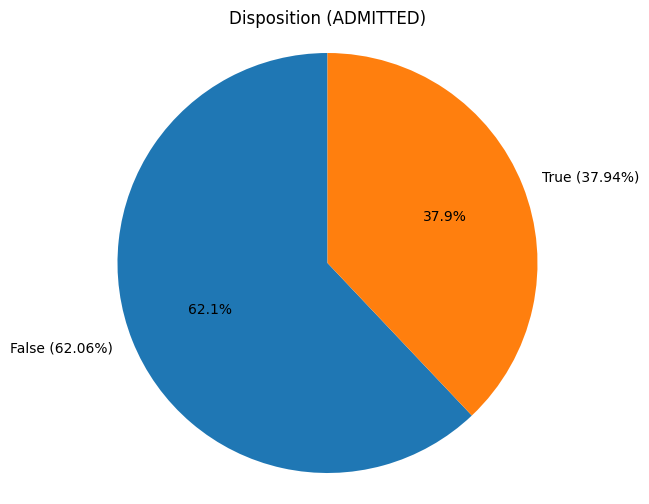

In [ ]:
# print out a simple pie chart showing the number and % of records with disposition_ADMITTED = 1 and = 0

# Assuming 'reduced master_df' is your DataFrame and 'disposition_ADMITTED' is a column.
# Count the occurrences of disposition_ADMITTED = 1 and 0
disposition_counts = reduced_master_df['disposition_ADMITTED'].value_counts()

# Calculate percentages
disposition_percentages = (disposition_counts / disposition_counts.sum()) * 100

# Create the pie chart
plt.figure(figsize=(8, 6))
plt.pie(disposition_counts, labels=[f"{label} ({percentage:.2f}%)" for label, percentage in zip(disposition_counts.index, disposition_percentages)], autopct='%1.1f%%', startangle=90)
plt.title('Disposition (ADMITTED)')
plt.axis('equal')  # Equal aspect ratio ensures that pie is drawn as a circle.
plt.show()


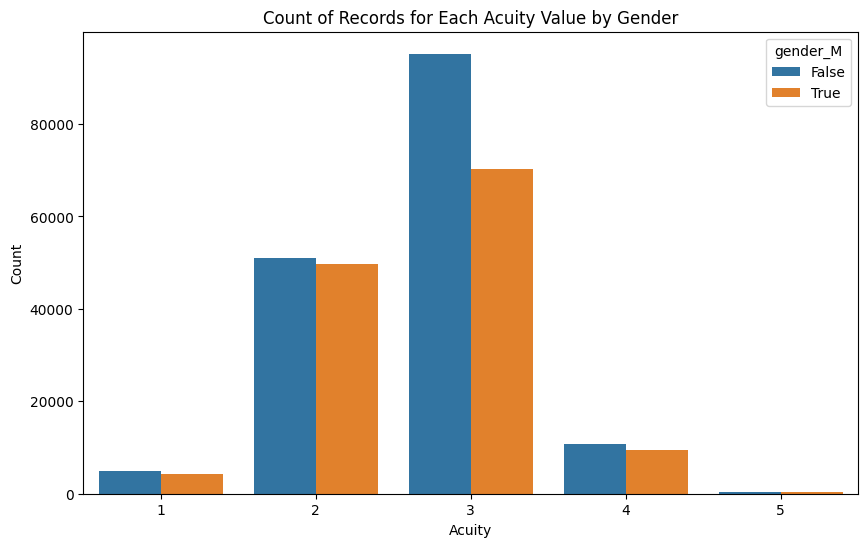

In [ ]:
# create a bar chart that shows count of records for each accuity value for each value of gender_M

# Create the bar chart
plt.figure(figsize=(10, 6))
sns.countplot(x='triage_acuity', hue='gender_M', data=reduced_master_df)
plt.xlabel('Acuity')
plt.ylabel('Count')
plt.title('Count of Records for Each Acuity Value by Gender')
plt.show()


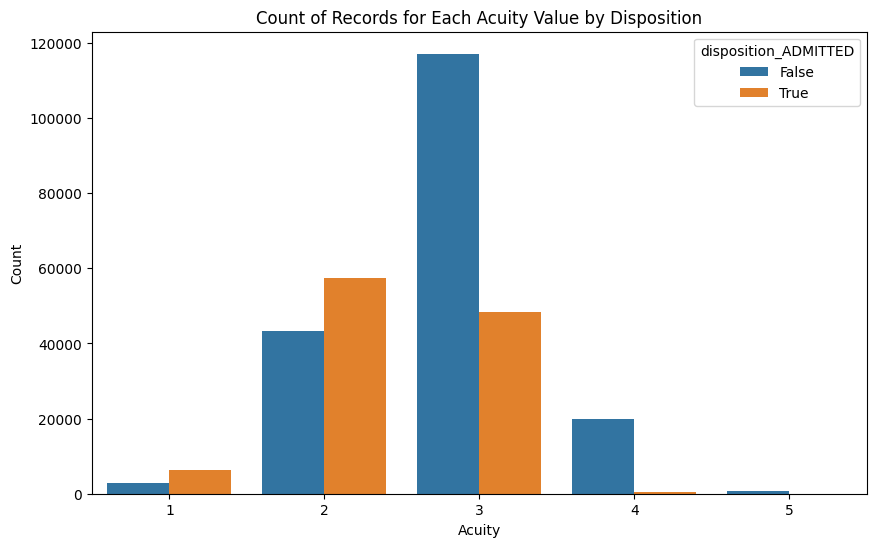

In [ ]:
# create a bar chart that shows count of records for each accuity value for each value of disposition_ADMITTED

# Create the bar chart
plt.figure(figsize=(10, 6))
sns.countplot(x='triage_acuity', hue='disposition_ADMITTED', data=reduced_master_df)
plt.xlabel('Acuity')
plt.ylabel('Count')
plt.title('Count of Records for Each Acuity Value by Disposition')
plt.show()

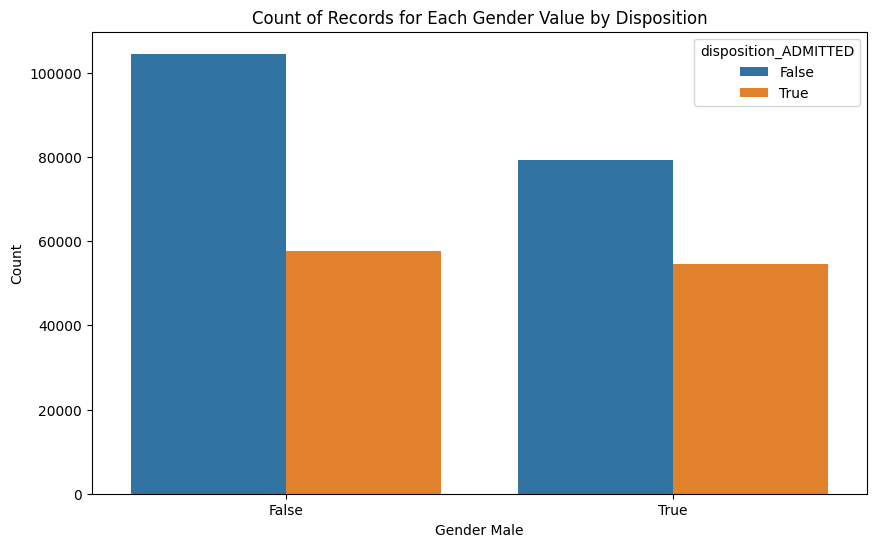

In [ ]:
# create a bar chart that shows count of records for each gender for each value of disposition_ADMITTED

# Create the bar chart
plt.figure(figsize=(10, 6))
sns.countplot(x='gender_M', hue='disposition_ADMITTED', data=reduced_master_df)
plt.xlabel('Gender Male')
plt.ylabel('Count')
plt.title('Count of Records for Each Gender Value by Disposition')
plt.show()

# **5. Develop & Evaluate Models**

In this section


*   Build our common performance evaluation functions, that will be used to calculate and print out performance metrics for all ML models and related bias checks as well
*   Build and assess 5 x different ML models which include
      - Logistic Regression (LR)
      - Decision Tree (DT)
      - Random Forest (RF)
      - XGBoost (XGB)
      - Deep Neural Network (DNN)

In the sub-section for each model we also
*   Call the common functions to calculate model performance and check for bias
*   Implement feature importance and XAI techniques to determine which features have most impact on the predictions being made

Bias - additional checks for intersectional bias performed for the XGBoost model.

Model Compression - implemented for the RF and DNN models.




## 5.0 Performance Eval Functions

In this section, we build our common performance evaluation functions that will be used to calculate and print out performance metrics for all ML models and related bias checks as well

###5.0.1 Analyse Performance Per Class

In [ ]:
def analyse_performance_by_class(y_test, y_pred):

  print("Analysis of Performance by Class")
  print("================================")
  print("")

  # print out confusion matrix
  conf_m = confusion_matrix(y_test, y_pred)

  # Plot heatmap
  plt.figure(figsize=(6, 5))
  sns.heatmap(conf_m, annot=True, fmt='d', cmap='Blues')
  plt.xlabel('Predicted Label')
  plt.ylabel('True Label')
  plt.title('Confusion Matrix Heatmap')
  plt.show()

# calculate standard metrics

# Extract values from the confusion matrix
  TN = conf_m[0, 0]  # True Negatives
  FP = conf_m[0, 1]  # False Positives
  FN = conf_m[1, 0]  # False Negatives
  TP = conf_m[1, 1]  # True Positives

# calculate metrics for target group
  Accuracy = round((TP + TN) / (TP + TN + FP + FN), 2)
  Precision = round(TP / (TP + FP), 2)
  Recall = round(TP / (TP + FN), 2)
  F1_Score = round(2 * (Precision * Recall) / (Precision + Recall), 2)
  Specificity = round(TN / (TN + FP), 2)

# print out metrics for target group
  print("\n")
  print("Accuracy: ", Accuracy)
  print("Precision: ", Precision)
  print("Recall / Sensitivity: ", Recall)
  print("Specificity: ", Specificity)
  print("F1 Score: ", F1_Score)
  print("\n")

### 5.0.2 Analyse Performance by Target Groups

In [ ]:
# function to calculate the assessment metrics
#
# target_Group = name of the target group
# act = actual Y values
# pred = predicted Y values
def subMetrics(targetGroup, act, pred):
  print("Metrics for: ", targetGroup)
  print("-------------------------------")
  print("")
  correct = 0
  # parse both lists to numpy arrays
  act = np.array(act)
  pred = np.array(pred)

  # flatten pred if needed
  if pred.ndim == 2:
    pred = pred.flatten()

  # There may be an easier way to do this, however, I believe it is a manual process!
  for index, item in enumerate(act):
    if item == pred[index]:
      correct += 1
  # print accuracy, and the confusion matrix
  accuracy = round((correct / len(act)) * 100,2)
  print("Accuracy:", accuracy, "%")
  print("")
  conf_m = pd.crosstab( np.array(act),  np.array(pred), rownames=['Actual'], colnames=['Predicted'], margins=True)
  print(conf_m)

# Extract values from the confusion matrix
  TN = conf_m.at[0, 0]  # True Negatives
  FP = conf_m.at[0, 1]  # False Positives
  FN = conf_m.at[1, 0]  # False Negatives
  TP = conf_m.at[1, 1]  # True Positives

# calculate metrics for target group
  Accuracy = round((TP + TN) / (TP + TN + FP + FN), 2)
  Precision = round(TP / (TP + FP), 2)
  Recall = round(TP / (TP + FN), 2)
  F1_Score = round(2 * (Precision * Recall) / (Precision + Recall), 2)
  Specificity = round(TN / (TN + FP), 2)

# print out metrics for target group
  print("\n")
  print("Accuracy: ", Accuracy)
  print("Precision: ", Precision)
  print("Recall / Sensitivity: ", Recall)
  print("Specificity: ", Specificity)
  print("F1 Score: ", F1_Score)

In [ ]:
# function to analyse the performance for Gender as a target group
#
# y_test = np array of the actual y values in the test test
# y_pred = np array of the predicted y values
# x_test = pandas dataframe of the x values

def analyse_performance_by_gender(y_test, y_pred, X_test):

  # Initialize lists to store predictions for each gender
  female_pred = []  # Female was label encoded as 0
  female_actual_class = []

  male_pred = []  # Male was label encoded as 1
  male_actual_class = []

  # Get the column index for 'gender_M'
  gender_M_index = X_test.columns.get_loc('gender_M')

  # Use enumerate to iterate through both X_test and y_pred with correct indices
  for i, (index, row) in enumerate(X_test.iterrows()):
      # Use iloc to access value by position
      if row.iloc[gender_M_index] == 0:  # Female
          female_pred.append(y_pred[i])  # Access y_pred using the loop index 'i'
          female_actual_class.append(y_test.iloc[i])  # Access Y_test using iloc
      else:  # Male
          male_pred.append(y_pred[i])  # Access y_pred using the loop index 'i'
          male_actual_class.append(y_test.iloc[i])  # Access Y_test using iloc

  # print target group title
  print("Performance Analysis for target group = GENDER")
  print("=================================================")
  print("")

  # Print the representation of each target group
  print("Female instances in the test set:", len(female_pred))
  print("Male instances in the test set:  ", len(male_pred))
  print("\n")

  # calculate and print the performance metrics per target group
  subMetrics("Female", female_actual_class, female_pred)
  print("\n")
  subMetrics("Male", male_actual_class, male_pred)

In [ ]:
# function to analyse the performance for Race Group as a target group
#
# y_test = np array of the actual y values in the test test
# y_pred = np array of the predicted y values
# x_test = pandas dataframe of the x values

def analyse_performance_by_race_group(y_test, y_pred, X_test):

  # Initialize lists to store predictions for each race group
  bam_pred = []   # black african amercian
  bam_actual_class = []

  hl_pred = []    # hispanic latino
  hl_actual_class = []

  un_pred = []    # unknown
  un_actual_class = []

  wh_pred = []    # white
  wh_actual_class = []

  as_pred = []    # asian
  as_actual_class = []

  ot_pred = [] # other
  ot_actual_class = []

  # Get the column index for each race group
  bam_index = X_test.columns.get_loc('race_group_Black/African American')
  hl_index = X_test.columns.get_loc('race_group_Hispanic/Latino')
  ot_index = X_test.columns.get_loc('race_group_Other')
  un_index = X_test.columns.get_loc('race_group_Unknown')
  wh_index = X_test.columns.get_loc('race_group_White')

  # Use enumerate to iterate through both X_test and y_pred with correct indices
  for i, (index, row) in enumerate(X_test.iterrows()):
      # Use iloc to access value by position
      if row.iloc[bam_index] == 1:
          bam_pred.append(y_pred[i])  # Access y_pred using the loop index 'i'
          bam_actual_class.append(y_test.iloc[i])  # Access Y_test using iloc
      elif row.iloc[hl_index] == 1:
          hl_pred.append(y_pred[i])  # Access y_pred using the loop index 'i'
          hl_actual_class.append(y_test.iloc[i])  # Access Y_test using iloc
      elif row.iloc[ot_index] == 1:
          ot_pred.append(y_pred[i])  # Access y_pred using the loop index 'i'
          ot_actual_class.append(y_test.iloc[i])  # Access Y_test using iloc
      elif row.iloc[un_index] == 1:
          un_pred.append(y_pred[i])  # Access y_pred using the loop index 'i'
          un_actual_class.append(y_test.iloc[i])  # Access Y_test using iloc
      elif row.iloc[wh_index] == 1:
          wh_pred.append(y_pred[i])  # Access y_pred using the loop index 'i'
          wh_actual_class.append(y_test.iloc[i])  # Access Y_test using iloc
      else:
          as_pred.append(y_pred[i])  # Access y_pred using the loop index 'i'
          as_actual_class.append(y_test.iloc[i])  # Access Y_test using iloc

  # print target group title
  print("Performance Analysis for target group = RACE GROUP")
  print("=================================================")
  print("")

  # Print the representation of each target group
  print("Black / African Amercian instances in the test set:", len(bam_pred))
  print("Hispanic / Latino instances in the test set:       ", len(hl_pred))
  print("Other instances in the test set:                   ", len(ot_pred))
  print("Unknown instances in the test set:                 ", len(un_pred))
  print("White instances in the test set:                   ", len(wh_pred))
  print("Asian instances in the test set:                   ", len(as_pred))
  print("\n")

  # calculate and print the performance metrics per target group
  subMetrics("BAM", bam_actual_class, bam_pred)
  print("\n")
  subMetrics("Hispanic/Latino", hl_actual_class, hl_pred)
  print("\n")
  subMetrics("Other", ot_actual_class, ot_pred)
  print("\n")
  subMetrics("Unknown", un_actual_class, un_pred)
  print("\n")
  subMetrics("White", wh_actual_class, wh_pred)
  print("\n")
  subMetrics("Asian", as_actual_class, as_pred)

In [ ]:
# function to analyse the performance for Age as a target group
#
# y_test = np array of the actual y values in the test test
# y_pred = np array of the predicted y values
# x_test = pandas dataframe of the x values

def analyse_performance_by_age_group(y_test, y_pred, X_test):

  # create a copy of X_test called X_test_age with first column = Age from X_test and second column = new column called Age_group.  Set Age_group = '18 - 30' if Age <= 30.   Set Age_group = '31 - 45' if Age >=31 and <= 45.  Set Age_group = '46 = 60' if Age >= 46 and <=60.  Set Age_group = '61 - 75' if Age >=75 and <=75.  Set Age_group = '75+' if Age >= 75.  For any other values of Age set Age_group = 'Error'

  # Create X_test_age
  X_test_age = X_test[['stay_age']].copy()
  X_test_age['Age_group'] = 'Error'  # Initialize Age_group column

  # Define age group conditions
  X_test_age.loc[X_test_age['stay_age'] <= 30, 'Age_group'] = '18 - 30'
  X_test_age.loc[(X_test_age['stay_age'] >= 31) & (X_test_age['stay_age'] <= 45), 'Age_group'] = '31 - 45'
  X_test_age.loc[(X_test_age['stay_age'] >= 46) & (X_test_age['stay_age'] <= 60), 'Age_group'] = '46 - 60'
  X_test_age.loc[(X_test_age['stay_age'] >= 61) & (X_test_age['stay_age'] <= 75), 'Age_group'] = '61 - 75'
  X_test_age.loc[X_test_age['stay_age'] >= 75, 'Age_group'] = '75+'

  # Initialize lists to store predictions for each Age group
  age_18_30_pred = []
  age_18_30_actual_class = []

  age_31_45_pred = []
  age_31_45_actual_class = []

  age_46_60_pred = []
  age_46_60_actual_class = []

  age_61_75_pred = []
  age_61_75_actual_class = []

  age_75_pred = []
  age_75_actual_class = []

  # Iterate through X_test_age and y_pred using their indices
  for i in range(len(X_test_age)):
      # Access Age_group directly using the column name
      if X_test_age.loc[X_test_age.index[i], 'Age_group'] == '18 - 30':
          age_18_30_pred.append(y_pred[i])
          age_18_30_actual_class.append(y_test.iloc[i])
      elif X_test_age.loc[X_test_age.index[i], 'Age_group'] == '31 - 45':
          age_31_45_pred.append(y_pred[i])
          age_31_45_actual_class.append(y_test.iloc[i])
      elif X_test_age.loc[X_test_age.index[i], 'Age_group'] == '46 - 60':
          age_46_60_pred.append(y_pred[i])
          age_46_60_actual_class.append(y_test.iloc[i])
      elif X_test_age.loc[X_test_age.index[i], 'Age_group'] == '61 - 75':
          age_61_75_pred.append(y_pred[i])
          age_61_75_actual_class.append(y_test.iloc[i])
      else:
          age_75_pred.append(y_pred[i])
          age_75_actual_class.append(y_test.iloc[i])

  # print target group title
  print("Performance Analysis for target group = AGE GROUP")
  print("=================================================")
  print("")

  # Print the representation of each target group
  print("Age 18-30 instances in the test set:", len(age_18_30_pred))
  print("Age 31-45 instances in the test set:", len(age_31_45_pred))
  print("Age 46-60 instances in the test set:", len(age_46_60_pred))
  print("Age 61-75 instances in the test set:", len(age_61_75_pred))
  print("Age 75+ instances in the test set:  ", len(age_75_pred))
  print("\n")

  # calculate and print the performance metrics per target group
  subMetrics("Age 18-30", age_18_30_actual_class, age_18_30_pred)
  print("\n")
  subMetrics("Age 31-45", age_31_45_actual_class, age_31_45_pred)
  print("\n")
  subMetrics("Age 46-60", age_46_60_actual_class, age_46_60_pred)
  print("\n")
  subMetrics("Age 61-75", age_61_75_actual_class, age_61_75_pred)
  print("\n")
  subMetrics("Age 75+", age_75_actual_class, age_75_pred)
  print("\n")

### 5.0.3 Analyse Performance by Intersectional Target Group

In [ ]:
# function to analyse the performance for Gender & Race Group as an intersectional target group
#
# y_test = np array of the actual y values in the test test
# y_pred = np array of the predicted y values
# x_test = pandas dataframe of the x values

def analyse_performance_by_gender_race_group(y_test, y_pred, X_test):

  # Initialize lists to store predictions for each gender and each race group
  male_bam_pred = []   # black african amercian male
  male_bam_actual_class = []

  male_hl_pred = []    # hispanic latino male
  male_hl_actual_class = []

  male_un_pred = []    # unknown male
  male_un_actual_class = []

  male_wh_pred = []    # white male
  male_wh_actual_class = []

  male_as_pred = []    # asian male
  male_as_actual_class = []

  male_ot_pred = [] # other male
  male_ot_actual_class = []

  female_bam_pred = []   # black african amercian female
  female_bam_actual_class = []

  female_hl_pred = []    # hispanic latino female
  female_hl_actual_class = []

  female_un_pred = []    # unknown female
  female_un_actual_class = []

  female_wh_pred = []    # white female
  female_wh_actual_class = []

  female_as_pred = []    # asian female
  female_as_actual_class = []

  female_ot_pred = [] # other female
  female_ot_actual_class = []

  # Get the column index for each gender and race group
  bam_index = X_test.columns.get_loc('race_group_Black/African American')
  hl_index = X_test.columns.get_loc('race_group_Hispanic/Latino')
  ot_index = X_test.columns.get_loc('race_group_Other')
  un_index = X_test.columns.get_loc('race_group_Unknown')
  wh_index = X_test.columns.get_loc('race_group_White')

  # Get the column index for 'gender_M'
  gender_M_index = X_test.columns.get_loc('gender_M')

  # Use enumerate to iterate through both X_test and y_pred with correct indices
  for i, (index, row) in enumerate(X_test.iterrows()):

      # Use iloc to access value by position

      if row.iloc[gender_M_index] == 1: ## gender = male

        if row.iloc[bam_index] == 1:
            male_bam_pred.append(y_pred[i])  # Access y_pred using the loop index 'i'
            male_bam_actual_class.append(y_test.iloc[i])  # Access Y_test using iloc
        elif row.iloc[hl_index] == 1:
            male_hl_pred.append(y_pred[i])  # Access y_pred using the loop index 'i'
            male_hl_actual_class.append(y_test.iloc[i])  # Access Y_test using iloc
        elif row.iloc[ot_index] == 1:
            male_ot_pred.append(y_pred[i])  # Access y_pred using the loop index 'i'
            male_ot_actual_class.append(y_test.iloc[i])  # Access Y_test using iloc
        elif row.iloc[un_index] == 1:
            male_un_pred.append(y_pred[i])  # Access y_pred using the loop index 'i'
            male_un_actual_class.append(y_test.iloc[i])  # Access Y_test using iloc
        elif row.iloc[wh_index] == 1:
            male_wh_pred.append(y_pred[i])  # Access y_pred using the loop index 'i'
            male_wh_actual_class.append(y_test.iloc[i])  # Access Y_test using iloc
        else:
            male_as_pred.append(y_pred[i])  # Access y_pred using the loop index 'i'
            male_as_actual_class.append(y_test.iloc[i])  # Access Y_test using iloc

      else:  ## geneder = female

        if row.iloc[bam_index] == 1:
            female_bam_pred.append(y_pred[i])  # Access y_pred using the loop index 'i'
            female_bam_actual_class.append(y_test.iloc[i])  # Access Y_test using iloc
        elif row.iloc[hl_index] == 1:
            female_hl_pred.append(y_pred[i])  # Access y_pred using the loop index 'i'
            female_hl_actual_class.append(y_test.iloc[i])  # Access Y_test using iloc
        elif row.iloc[ot_index] == 1:
            female_ot_pred.append(y_pred[i])  # Access y_pred using the loop index 'i'
            female_ot_actual_class.append(y_test.iloc[i])  # Access Y_test using iloc
        elif row.iloc[un_index] == 1:
            female_un_pred.append(y_pred[i])  # Access y_pred using the loop index 'i'
            female_un_actual_class.append(y_test.iloc[i])  # Access Y_test using iloc
        elif row.iloc[wh_index] == 1:
            female_wh_pred.append(y_pred[i])  # Access y_pred using the loop index 'i'
            female_wh_actual_class.append(y_test.iloc[i])  # Access Y_test using iloc
        else:
            female_as_pred.append(y_pred[i])  # Access y_pred using the loop index 'i'
            female_as_actual_class.append(y_test.iloc[i])  # Access Y_test using iloc


  # print target group title
  print("Performance Analysis for intersectional target group = GENDER & RACE")
  print("====================================================================")
  print("")

  # Print the representation of each target group - male
  print("Male Black / African Amercian instances in the test set:", len(male_bam_pred))
  print("Male Hispanic / Latino instances in the test set:       ", len(male_hl_pred))
  print("Male Other instances in the test set:                   ", len(male_ot_pred))
  print("Male Unknown instances in the test set:                 ", len(male_un_pred))
  print("Male White instances in the test set:                   ", len(male_wh_pred))
  print("Male Asian instances in the test set:                   ", len(male_as_pred))
  print("\n")

  # calculate and print the performance metrics per target group
  subMetrics("Male BAM", male_bam_actual_class, male_bam_pred)
  print("\n")
  subMetrics("Male Hispanic/Latino", male_hl_actual_class, male_hl_pred)
  print("\n")
  subMetrics("Male Other", male_ot_actual_class, male_ot_pred)
  print("\n")
  subMetrics("Male Unknown", male_un_actual_class, male_un_pred)
  print("\n")
  subMetrics("Male White", male_wh_actual_class, male_wh_pred)
  print("\n")
  subMetrics("Male Asian", male_as_actual_class, male_as_pred)


  # Print the representation of each target group - female
  print("")
  print("Female Black / African Amercian instances in the test set:", len(female_bam_pred))
  print("Female Hispanic / Latino instances in the test set:       ", len(female_hl_pred))
  print("Female Other instances in the test set:                   ", len(female_ot_pred))
  print("Female Unknown instances in the test set:                 ", len(female_un_pred))
  print("Female White instances in the test set:                   ", len(female_wh_pred))
  print("Female Asian instances in the test set:                   ", len(female_as_pred))
  print("\n")

  # calculate and print the performance metrics per target group
  subMetrics("Female BAM", female_bam_actual_class, female_bam_pred)
  print("\n")
  subMetrics("Female Hispanic/Latino", female_hl_actual_class, female_hl_pred)
  print("\n")
  subMetrics("Female Other", female_ot_actual_class, female_ot_pred)
  print("\n")
  subMetrics("Female Unknown", female_un_actual_class, female_un_pred)
  print("\n")
  subMetrics("Female White", female_wh_actual_class, female_wh_pred)
  print("\n")
  subMetrics("Female Asian", female_as_actual_class, female_as_pred)

In [ ]:
# function to analyse the performance for Gender and Age as an intersectional target group
#
# y_test = np array of the actual y values in the test test
# y_pred = np array of the predicted y values
# x_test = pandas dataframe of the x values

def analyse_performance_by_gender_age_group(y_test, y_pred, X_test):

  # Create X_test_age and include gender column as well ...
  X_test_age = X_test[['stay_age','gender_M']].copy()
  X_test_age['Age_group'] = 'Error'  # Initialize Age_group column

  # Define age group conditions
  X_test_age.loc[X_test_age['stay_age'] <= 30, 'Age_group'] = '18 - 30'
  X_test_age.loc[(X_test_age['stay_age'] >= 31) & (X_test_age['stay_age'] <= 45), 'Age_group'] = '31 - 45'
  X_test_age.loc[(X_test_age['stay_age'] >= 46) & (X_test_age['stay_age'] <= 60), 'Age_group'] = '46 - 60'
  X_test_age.loc[(X_test_age['stay_age'] >= 61) & (X_test_age['stay_age'] <= 75), 'Age_group'] = '61 - 75'
  X_test_age.loc[X_test_age['stay_age'] >= 75, 'Age_group'] = '75+'

  # Initialize lists to store predictions for each Age group
  male_age_18_30_pred = []
  male_age_18_30_actual_class = []

  male_age_31_45_pred = []
  male_age_31_45_actual_class = []

  male_age_46_60_pred = []
  male_age_46_60_actual_class = []

  male_age_61_75_pred = []
  male_age_61_75_actual_class = []

  male_age_75_pred = []
  male_age_75_actual_class = []

  female_age_18_30_pred = []
  female_age_18_30_actual_class = []

  female_age_31_45_pred = []
  female_age_31_45_actual_class = []

  female_age_46_60_pred = []
  female_age_46_60_actual_class = []

  female_age_61_75_pred = []
  female_age_61_75_actual_class = []

  female_age_75_pred = []
  female_age_75_actual_class = []

  # Get the column index for 'gender_M'
  gender_M_index = X_test.columns.get_loc('gender_M')

  # Iterate through X_test_age and y_pred using their indices
  for i in range(len(X_test_age)):

    if X_test_age.loc[X_test_age.index[i], 'gender_M'] == 1:   # Male

      # Access Age_group directly using the column name
      if X_test_age.loc[X_test_age.index[i], 'Age_group'] == '18 - 30':
          male_age_18_30_pred.append(y_pred[i])
          male_age_18_30_actual_class.append(y_test.iloc[i])
      elif X_test_age.loc[X_test_age.index[i], 'Age_group'] == '31 - 45':
          male_age_31_45_pred.append(y_pred[i])
          male_age_31_45_actual_class.append(y_test.iloc[i])
      elif X_test_age.loc[X_test_age.index[i], 'Age_group'] == '46 - 60':
          male_age_46_60_pred.append(y_pred[i])
          male_age_46_60_actual_class.append(y_test.iloc[i])
      elif X_test_age.loc[X_test_age.index[i], 'Age_group'] == '61 - 75':
          male_age_61_75_pred.append(y_pred[i])
          male_age_61_75_actual_class.append(y_test.iloc[i])
      else:
          male_age_75_pred.append(y_pred[i])
          male_age_75_actual_class.append(y_test.iloc[i])

    else:   # Female

      # Access Age_group directly using the column name
      if X_test_age.loc[X_test_age.index[i], 'Age_group'] == '18 - 30':
          female_age_18_30_pred.append(y_pred[i])
          female_age_18_30_actual_class.append(y_test.iloc[i])
      elif X_test_age.loc[X_test_age.index[i], 'Age_group'] == '31 - 45':
          female_age_31_45_pred.append(y_pred[i])
          female_age_31_45_actual_class.append(y_test.iloc[i])
      elif X_test_age.loc[X_test_age.index[i], 'Age_group'] == '46 - 60':
          female_age_46_60_pred.append(y_pred[i])
          female_age_46_60_actual_class.append(y_test.iloc[i])
      elif X_test_age.loc[X_test_age.index[i], 'Age_group'] == '61 - 75':
          female_age_61_75_pred.append(y_pred[i])
          female_age_61_75_actual_class.append(y_test.iloc[i])
      else:
          female_age_75_pred.append(y_pred[i])
          female_age_75_actual_class.append(y_test.iloc[i])



  # print target group title
  print("Performance Analysis for target intersectional group = GENDER AGE GROUP")
  print("=======================================================================")
  print("")

  # Print the representation of each target group
  print("Male Age 18-30 instances in the test set:", len(male_age_18_30_pred))
  print("Male Age 31-45 instances in the test set:", len(male_age_31_45_pred))
  print("Male Age 46-60 instances in the test set:", len(male_age_46_60_pred))
  print("Male Age 61-75 instances in the test set:", len(male_age_61_75_pred))
  print("Male Age 75+ instances in the test set:  ", len(male_age_75_pred))
  print("\n")

  # calculate and print the performance metrics per target group
  subMetrics("Male Age 18-30", male_age_18_30_actual_class, male_age_18_30_pred)
  print("\n")
  subMetrics("Male Age 31-45", male_age_31_45_actual_class, male_age_31_45_pred)
  print("\n")
  subMetrics("Male Age 46-60", male_age_46_60_actual_class, male_age_46_60_pred)
  print("\n")
  subMetrics("Male Age 61-75", male_age_61_75_actual_class, male_age_61_75_pred)
  print("\n")
  subMetrics("Male Age 75+", male_age_75_actual_class, male_age_75_pred)
  print("\n")


  # Print the representation of each target group
  print("\n")
  print("Female Age 18-30 instances in the test set:", len(female_age_18_30_pred))
  print("Female Age 31-45 instances in the test set:", len(female_age_31_45_pred))
  print("Female Age 46-60 instances in the test set:", len(female_age_46_60_pred))
  print("Female Age 61-75 instances in the test set:", len(female_age_61_75_pred))
  print("Female Age 75+ instances in the test set:  ", len(female_age_75_pred))
  print("\n")

  # calculate and print the performance metrics per target group
  subMetrics("Female Age 18-30", female_age_18_30_actual_class, female_age_18_30_pred)
  print("\n")
  subMetrics("Female Age 31-45", female_age_31_45_actual_class, female_age_31_45_pred)
  print("\n")
  subMetrics("Female Age 46-60", female_age_46_60_actual_class, female_age_46_60_pred)
  print("\n")
  subMetrics("Female Age 61-75", female_age_61_75_actual_class, female_age_61_75_pred)
  print("\n")
  subMetrics("Female Age 75+", female_age_75_actual_class, female_age_75_pred)
  print("\n")

## 5.1 Logistic Regression

This section includes all our implementation, feature importance / XAI analysis and bias checks for the LR model.



### **MODEL**

In [ ]:
# 1. Define Features and Target
X = reduced_master_df.drop(columns=['disposition_ADMITTED'])
y = reduced_master_df['disposition_ADMITTED']  # 1 = ADMITTED, 0 = HOME

In [ ]:
# 2. Train-Test Split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42, stratify=y)

In [ ]:
# 3. Feature Scaling
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

In [ ]:
# 4. Train Logistic Regression
logreg = LogisticRegression(max_iter=1000)
logreg.fit(X_train_scaled, y_train)

LogisticRegression(max_iter=1000)

In [ ]:
# 5. Evaluate Model
y_pred = logreg.predict(X_test_scaled)
y_proba = logreg.predict_proba(X_test_scaled)[:, 1]

In [ ]:
print(" Confusion Matrix ")
print(confusion_matrix(y_test, y_pred))

 Confusion Matrix 
[[46580  8582]
 [13414 20307]]


In [ ]:
y_pred = logreg.predict(X_test_scaled)
print(classification_report(y_test, y_pred))
print(confusion_matrix(y_test, y_pred))
y_proba = logreg.predict_proba(X_test_scaled)[:,1]  # Probabilities for positive class
print(f"ROC AUC Score: {roc_auc_score(y_test, y_proba):.3f}")

              precision    recall  f1-score   support

       False       0.78      0.84      0.81     55162
        True       0.70      0.60      0.65     33721

    accuracy                           0.75     88883
   macro avg       0.74      0.72      0.73     88883
weighted avg       0.75      0.75      0.75     88883

[[46580  8582]
 [13414 20307]]
ROC AUC Score: 0.821


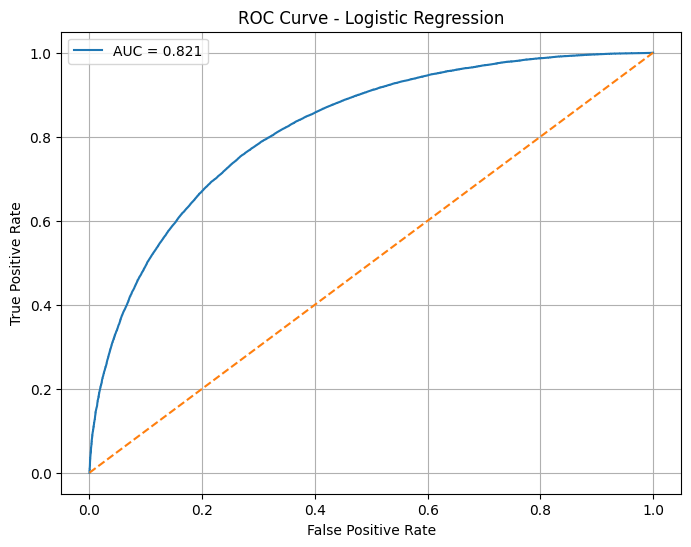

In [ ]:
fpr, tpr, thresholds = roc_curve(y_test, y_proba)
plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, label=f'AUC = {roc_auc_score(y_test, y_proba):.3f}')
plt.plot([0, 1], [0, 1], linestyle='--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve - Logistic Regression')
plt.legend()
plt.grid()
plt.show()

In [ ]:
print(f"ROC AUC Score: {roc_auc_score(y_test, y_proba):.3f}")

ROC AUC Score: 0.821


In [ ]:
print("\n Feature Correlation with Target ")
correlations = {}
for col in X.columns:
    correlations[col] = np.corrcoef(X[col], y)[0, 1]
sorted_corr = sorted(correlations.items(), key=lambda x: abs(x[1]), reverse=True)
for feature, corr in sorted_corr[:10]:
    print(f"{feature}: {corr:.3f}")


 Feature Correlation with Target 
triage_acuity: -0.342
stay_age: 0.339
medrecon_gsn_count: 0.284
arrival_transport_WALK IN: -0.261
triage_o2sat: -0.191
race_group_White: 0.157
triage_chiefcomplaint_class_General Medical: -0.139
triage_resprate: 0.126
triage_dbp: -0.120
admit_prev_90d_count: 0.117


<ipython-input-183-16ce7cffcadc>:4: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Correlation', y='Feature', data=corr_df, palette='coolwarm', orient='h')


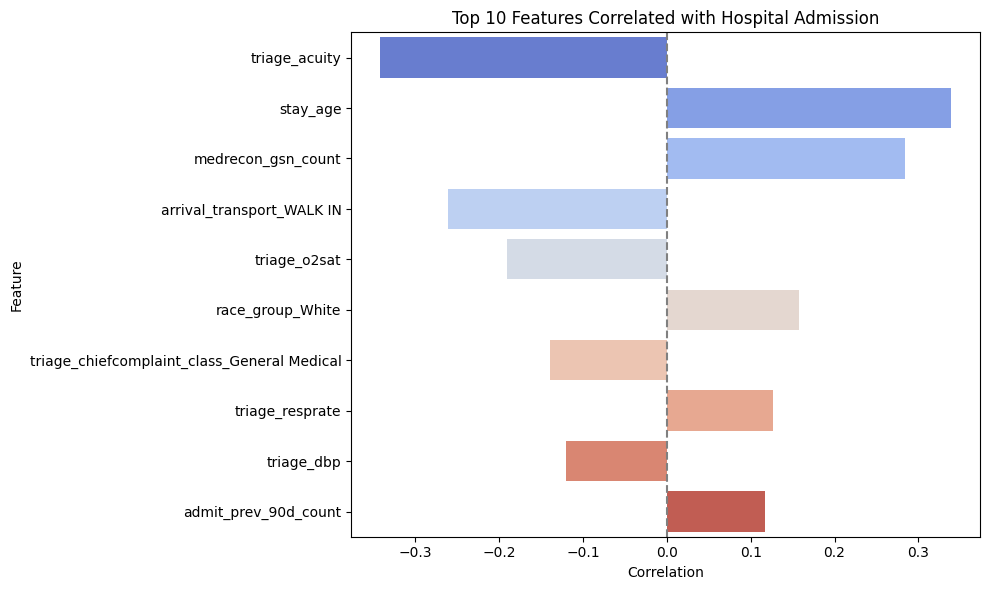

In [ ]:
corr_df = pd.DataFrame(sorted_corr[:10], columns=['Feature', 'Correlation'])

plt.figure(figsize=(10, 6))
sns.barplot(x='Correlation', y='Feature', data=corr_df, palette='coolwarm', orient='h')
plt.title('Top 10 Features Correlated with Hospital Admission')
plt.axvline(0, color='grey', linestyle='--')
plt.tight_layout()
plt.show()


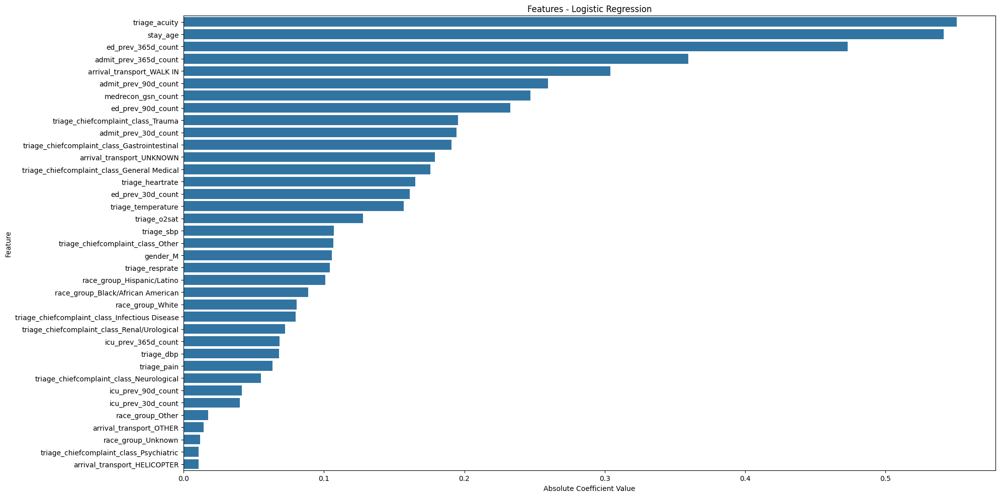

In [ ]:
coefficients = logreg.coef_[0]
feature_names = X.columns
coef_df = pd.DataFrame({'Feature': feature_names,'Coefficient': coefficients,'Abs_Coefficient': np.abs(coefficients)})

coef_df = coef_df.sort_values(by='Abs_Coefficient', ascending=False)

plt.figure(figsize=(20, 10))
sns.barplot(x='Abs_Coefficient', y='Feature', data=coef_df)
plt.title('Features - Logistic Regression')
plt.xlabel('Absolute Coefficient Value')
plt.ylabel('Feature')
plt.tight_layout()
plt.show()


### **XAI - LIME**

In [ ]:
# 6. LIME Explainability
explainer = LimeTabularExplainer(
    X_train_scaled,
    feature_names=X.columns.tolist(),
    class_names=['HOME', 'ADMITTED'],
    mode='classification'
)

# Identify 2 correct and 2 incorrect predictions
correct_indices = np.where(y_pred == y_test.values)[0]
incorrect_indices = np.where(y_pred != y_test.values)[0]

# Show LIME explanation for 2 correct predictions
print("\n LIME for 2 Correct Predictions ")
for i in correct_indices[:2]:
    exp = explainer.explain_instance(X_test_scaled[i], logreg.predict_proba)
    exp.show_in_notebook()

# Show LIME explanation for 2 incorrect predictions
print("\n LIME for 2 Incorrect Predictions ")
for i in incorrect_indices[:2]:
    exp = explainer.explain_instance(X_test_scaled[i], logreg.predict_proba)
    exp.show_in_notebook()


 LIME for 2 Correct Predictions 



 LIME for 2 Incorrect Predictions 


### **XAI - SHAP**

In [ ]:
# set up the test dataframe for Shap
X_test_df = pd.DataFrame(X_test_scaled, columns=X.columns)

# create the instance of the shap explainer
explainer = shap.LinearExplainer(logreg, X_train_scaled, feature_names=X.columns)

# calculate the shap values
shap_values = explainer.shap_values(X_test_scaled)

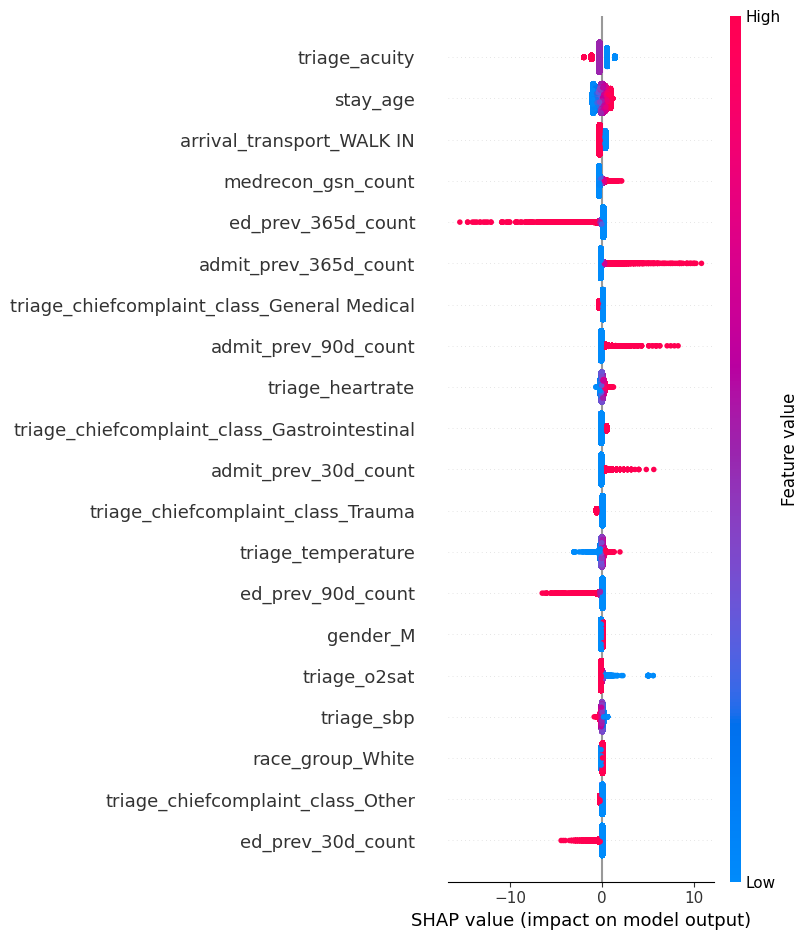

In [ ]:
shap.summary_plot(shap_values, X_test_df)

In [ ]:
feature_importance = pd.DataFrame({
    'Feature': X.columns,
    'MeanAbsSHAP': np.abs(shap_values).mean(axis=0)
}).sort_values('MeanAbsSHAP', ascending=False)

print("\n===== Top 15 Features by Mean Absolute SHAP Value =====");
print(feature_importance.head(15).to_string(index=False))


===== Top 15 Features by Mean Absolute SHAP Value =====
                                     Feature  MeanAbsSHAP
                               triage_acuity     0.471238
                                    stay_age     0.460495
                   arrival_transport_WALK IN     0.300753
                          medrecon_gsn_count     0.217687
                          ed_prev_365d_count     0.208856
                       admit_prev_365d_count     0.187563
 triage_chiefcomplaint_class_General Medical     0.152142
                        admit_prev_90d_count     0.134382
                            triage_heartrate     0.131151
triage_chiefcomplaint_class_Gastrointestinal     0.127580
                        admit_prev_30d_count     0.120064
          triage_chiefcomplaint_class_Trauma     0.116730
                          triage_temperature     0.109273
                           ed_prev_90d_count     0.108962
                                    gender_M     0.105087


### **Analysis of Performance by Class**

Analysis of Performance by Class



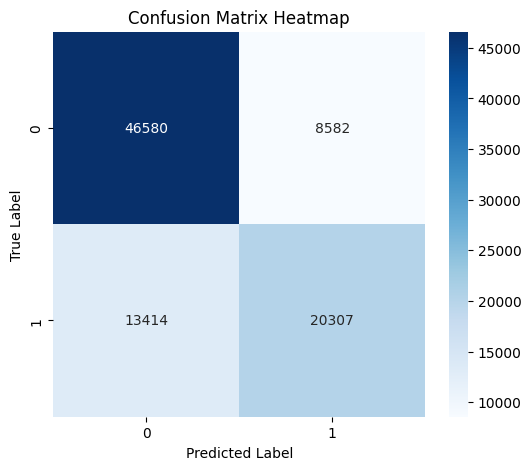



Accuracy:  0.75
Precision:  0.7
Recall / Sensitivity:  0.6
Specificity:  0.84
F1 Score:  0.65




In [ ]:
analyse_performance_by_class(y_test, y_pred)

### **Performance Analysis for target group = GENDER**

In [ ]:
analyse_performance_by_gender(y_test, y_pred, X_test)

Performance Analysis for target group = GENDER

Female instances in the test set: 48776
Male instances in the test set:   40107


Metrics for:  Female
-------------------------------

Accuracy: 75.54 %

Predicted  False   True    All
Actual                        
False      27052   4438  31490
True        7494   9792  17286
All        34546  14230  48776


Accuracy:  0.76
Precision:  0.69
Recall / Sensitivity:  0.57
Specificity:  0.86
F1 Score:  0.62


Metrics for:  Male
-------------------------------

Accuracy: 74.91 %

Predicted  False   True    All
Actual                        
False      19528   4144  23672
True        5920  10515  16435
All        25448  14659  40107


Accuracy:  0.75
Precision:  0.72
Recall / Sensitivity:  0.64
Specificity:  0.82
F1 Score:  0.68


### **Performance Analysis for target group = RACE GROUP**

In [ ]:
analyse_performance_by_race_group(y_test, y_pred, X_test)

Performance Analysis for target group = RACE GROUP

Black / African Amercian instances in the test set: 19772
Hispanic / Latino instances in the test set:        7260
Other instances in the test set:                    757
Unknown instances in the test set:                  5193
White instances in the test set:                    52011
Asian instances in the test set:                    3890


Metrics for:  BAM
-------------------------------

Accuracy: 77.86 %

Predicted  False  True    All
Actual                       
False      12886  1279  14165
True        3099  2508   5607
All        15985  3787  19772


Accuracy:  0.78
Precision:  0.66
Recall / Sensitivity:  0.45
Specificity:  0.91
F1 Score:  0.54


Metrics for:  Hispanic/Latino
-------------------------------

Accuracy: 79.21 %

Predicted  False  True   All
Actual                      
False       5030   355  5385
True        1154   721  1875
All         6184  1076  7260


Accuracy:  0.79
Precision:  0.67
Recall / Sensitivity:

### **Performance Analysis for target group = AGE GROUP**

In [ ]:
analyse_performance_by_age_group(y_test, y_pred, X_test)

Performance Analysis for target group = AGE GROUP

Age 18-30 instances in the test set: 17034
Age 31-45 instances in the test set: 16160
Age 46-60 instances in the test set: 21870
Age 61-75 instances in the test set: 19046
Age 75+ instances in the test set:   14773


Metrics for:  Age 18-30
-------------------------------

Accuracy: 85.95 %

Predicted  False  True    All
Actual                       
False      14272   300  14572
True        2093   369   2462
All        16365   669  17034


Accuracy:  0.86
Precision:  0.55
Recall / Sensitivity:  0.15
Specificity:  0.98
F1 Score:  0.24


Metrics for:  Age 31-45
-------------------------------

Accuracy: 78.0 %

Predicted  False  True    All
Actual                       
False      11370   630  12000
True        2925  1235   4160
All        14295  1865  16160


Accuracy:  0.78
Precision:  0.66
Recall / Sensitivity:  0.3
Specificity:  0.95
F1 Score:  0.41


Metrics for:  Age 46-60
-------------------------------

Accuracy: 72.71 %

Predic

## 5.2 Decision Tree & Random Forest

This section includes all our implementation, feature importance / XAI analysis and bias checks for the DT/RF models.

### 5.2.1 Decision Tree

#### Model - full

In [ ]:
# Set up the X and Y values
X = reduced_master_df.drop('disposition_ADMITTED', axis=1)                              # Separate features (X) and target (y)
y = reduced_master_df['disposition_ADMITTED']

# Split the X and y into train and test sets
X_train, X_test, y_train, y_test = train_test_split(X,y,test_size=0.3,random_state=42) # Test train split

dtree=DecisionTreeClassifier()                                                  # Create and fit the Decision Tree
dtree.fit(X_train,y_train)

DecisionTreeClassifier()

In [ ]:
# Make predictions and a Confusion Matrix
predictions= dtree.predict(X_test)
CM = confusion_matrix(y_test, predictions)
print("Confusion Matrix:")
print(CM)
print(" ")

Confusion Matrix:
[[40616 14685]
 [14397 19185]]
 


In [ ]:
# Print a Classification Report
print("Classification Report:")
print(classification_report(y_test, predictions))

Classification Report:
              precision    recall  f1-score   support

       False       0.74      0.73      0.74     55301
        True       0.57      0.57      0.57     33582

    accuracy                           0.67     88883
   macro avg       0.65      0.65      0.65     88883
weighted avg       0.67      0.67      0.67     88883



In [ ]:
# print out how many levels there are in the decision tree i.e. the depth
print(f"Depth of the decision tree: {dtree.get_depth()}")

Depth of the decision tree: 42


In [ ]:
# Export as DOT format
#dot_data = export_graphviz(dtree,
#                           out_file=None,
#                           feature_names=X_train.columns,
#                           class_names=['HOME', 'ADMITTED'],
#                           filled=True,
#                           rounded=True,
#                           special_characters=True)

#graph = graphviz.Source(dot_data)                                               # Create graph from DOT data
#graph.render("Decision_Tree_Full")                                              # Saves as "Decision_Tree" as a gv and pdf file
#graph.view()

'Decision_Tree_Full.pdf'

NOTE - this export code did not run to completion, likely because the decision tree was too large and too complex to generate an image for.  So we will comment out the code above and then use the Max Depth to control the size and complexity of the tree ....

#### Model - Max Depth 10

In [ ]:
# Try a decision tree with much smaller number for Max_Depth, lets set it to 10
dtree_10 = DecisionTreeClassifier(max_depth=10)
dtree_10.fit(X_train,y_train)

DecisionTreeClassifier(max_depth=10)

In [ ]:
# make predictions & print a classification report
predictions_10= dtree_10.predict(X_test)
print("Classification Report:")
print(classification_report(y_test, predictions_10))

Classification Report:
              precision    recall  f1-score   support

       False       0.77      0.83      0.80     55301
        True       0.68      0.59      0.63     33582

    accuracy                           0.74     88883
   macro avg       0.73      0.71      0.72     88883
weighted avg       0.74      0.74      0.74     88883



NOTE - the accuracy has increased from 67% up to 74% when we reduced the Max Depth down to 10 !

ROC AUC Score: 0.806


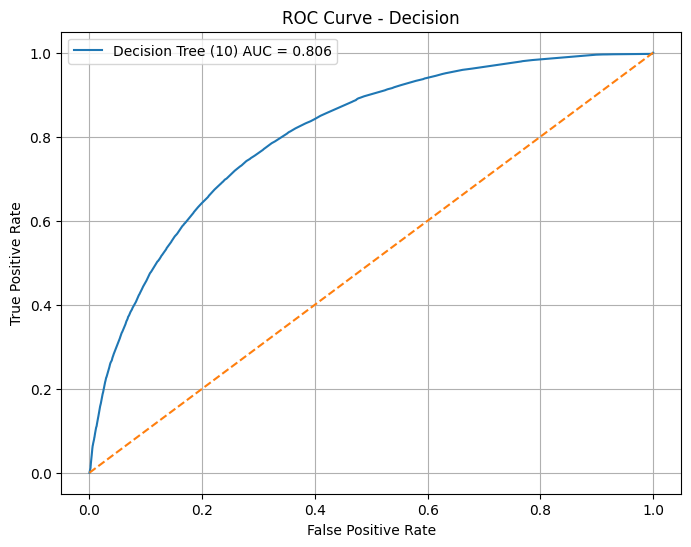

In [ ]:
y_proba = dtree_10.predict_proba(X_test)[:, 1]                                  # Get predicted probabilities
roc_auc = roc_auc_score(y_test, y_proba)                                        # Calculates the ROC AUC score
print(f"ROC AUC Score: {roc_auc:.3f}")                                          # Prints the ROC AUC score
fpr, tpr, thresholds = roc_curve(y_test, y_proba)                               # Calculates the ROC curve

# Plotting the ROC curve
plt.figure(figsize=(8, 6))                                                      # Setting the figure size
plt.plot(fpr, tpr, label=f'Decision Tree (10) AUC = {roc_auc:.3f}')             # Plotting the ROC curve
plt.plot([0, 1], [0, 1], linestyle='--')                                        # Plotting the diagonal line
plt.xlabel('False Positive Rate')                                               # Labelling the x-axis
plt.ylabel('True Positive Rate')                                                # Labelling the y-axis
plt.title('ROC Curve - Decision')                                               # Labelling the title
plt.legend()                                                                    # Adding a legend
plt.grid()                                                                      # Adding a grid
plt.show()                                                                      # Displaying the plot

In [ ]:
# Export as DOT format
dot_data = export_graphviz(dtree_10,
                           out_file=None,
                           feature_names=X_train.columns,
                           class_names=['HOME', 'ADMITTED'],
                           filled=True,
                           rounded=True,
                           special_characters=True)

graph = graphviz.Source(dot_data)                                               # Create graph from DOT data
graph.render("Decision_Tree_10")                                                # Saves as "Decision_Tree_10" as a gv and pdf file
graph.view()

'Decision_Tree_10.pdf'

#### Model - Max Depth 5

In [ ]:
# Try a decision tree with much smaller number for Max_Depth, lets set it to 5
dtree_5=DecisionTreeClassifier(max_depth=5)
dtree_5.fit(X_train,y_train)

DecisionTreeClassifier(max_depth=5)

In [ ]:
# make predictions & print a classification report
predictions_5= dtree_5.predict(X_test)
print("Classification Report:")
print(classification_report(y_test, predictions_5))

Classification Report:
              precision    recall  f1-score   support

       False       0.75      0.85      0.79     55301
        True       0.68      0.53      0.59     33582

    accuracy                           0.73     88883
   macro avg       0.71      0.69      0.69     88883
weighted avg       0.72      0.73      0.72     88883



NOTE - the accuracy has dropped to 73% when we reduced the Max Depth down to 5

ROC AUC Score: 0.783


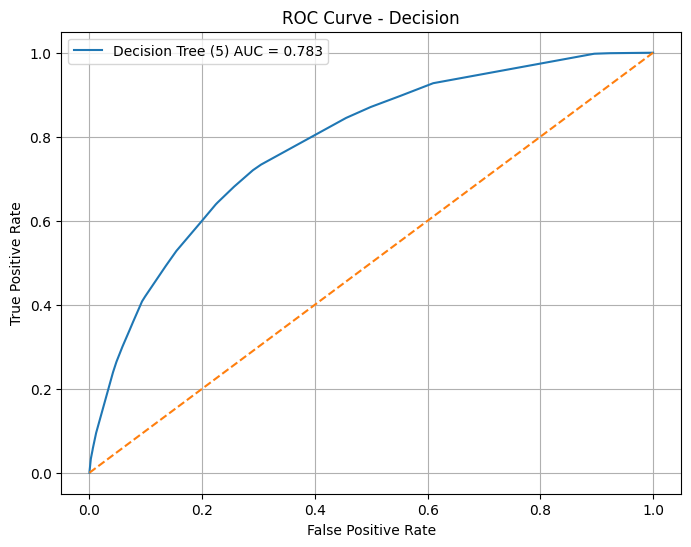

In [ ]:
y_proba = dtree_5.predict_proba(X_test)[:, 1]                                  # Get predicted probabilities
roc_auc = roc_auc_score(y_test, y_proba)                                        # Calculates the ROC AUC score
print(f"ROC AUC Score: {roc_auc:.3f}")                                          # Prints the ROC AUC score
fpr, tpr, thresholds = roc_curve(y_test, y_proba)                               # Calculates the ROC curve

# Plotting the ROC curve
plt.figure(figsize=(8, 6))                                                      # Setting the figure size
plt.plot(fpr, tpr, label=f'Decision Tree (5) AUC = {roc_auc:.3f}')             # Plotting the ROC curve
plt.plot([0, 1], [0, 1], linestyle='--')                                        # Plotting the diagonal line
plt.xlabel('False Positive Rate')                                               # Labelling the x-axis
plt.ylabel('True Positive Rate')                                                # Labelling the y-axis
plt.title('ROC Curve - Decision')                                               # Labelling the title
plt.legend()                                                                    # Adding a legend
plt.grid()                                                                      # Adding a grid
plt.show()                                                                      # Displaying the plot

In [ ]:
# Export as DOT format
dot_data = export_graphviz(dtree_5,
                           out_file=None,
                           feature_names=X_train.columns,
                           class_names=['HOME', 'ADMITTED'],
                           filled=True,
                           rounded=True,
                           special_characters=True)

graph = graphviz.Source(dot_data)                                              # Create graph from DOT data
graph.render("Decision_Tree_5")                                                # Saves as "Decision_Tree_10" as a gv and pdf file
graph.view()

'Decision_Tree_5.pdf'

NOTE - we will keep the Decision Tree with Max Depth = 10 for our further performance analysis because it has the highest Accuracy.  However we also note that it is harder to interpret the decision tree PDF image for this model than the Max_Depth = 5 model, as it is much wider and has much more levels in it.   

#### Analyse Performance per Class

Analysis of Performance by Class



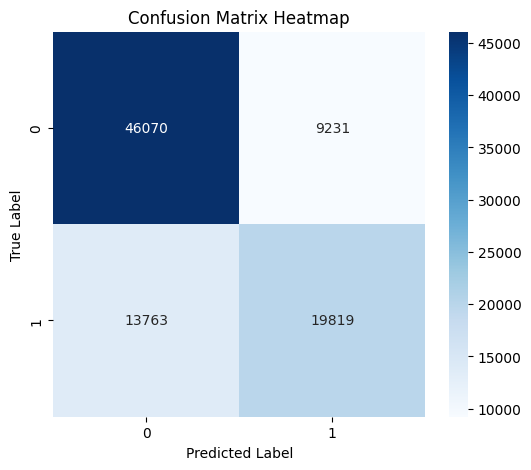



Accuracy:  0.74
Precision:  0.68
Recall / Sensitivity:  0.59
Specificity:  0.83
F1 Score:  0.63




In [ ]:
# get standard performance metrics by class
analyse_performance_by_class(y_test, predictions_10)

#### Analyse Performance per Target Group = Gender

In [ ]:
# target group = GENDER
analyse_performance_by_gender(y_test, predictions_10, X_test)

Performance Analysis for target group = GENDER

Female instances in the test set: 48746
Male instances in the test set:   40137


Metrics for:  Female
-------------------------------

Accuracy: 74.55 %

Predicted  False   True    All
Actual                        
False      26425   5134  31559
True        7270   9917  17187
All        33695  15051  48746


Accuracy:  0.75
Precision:  0.66
Recall / Sensitivity:  0.58
Specificity:  0.84
F1 Score:  0.62


Metrics for:  Male
-------------------------------

Accuracy: 73.62 %

Predicted  False   True    All
Actual                        
False      19645   4097  23742
True        6493   9902  16395
All        26138  13999  40137


Accuracy:  0.74
Precision:  0.71
Recall / Sensitivity:  0.6
Specificity:  0.83
F1 Score:  0.65


#### Analyse Performance per Target Group = Race Group

In [ ]:
# target group = RACE GROUP

analyse_performance_by_race_group(y_test, predictions_10, X_test)

Performance Analysis for target group = RACE GROUP

Black / African Amercian instances in the test set: 19944
Hispanic / Latino instances in the test set:        7253
Other instances in the test set:                    783
Unknown instances in the test set:                  4976
White instances in the test set:                    52038
Asian instances in the test set:                    3889


Metrics for:  BAM
-------------------------------

Accuracy: 76.97 %

Predicted  False  True    All
Actual                       
False      12498  1755  14253
True        2838  2853   5691
All        15336  4608  19944


Accuracy:  0.77
Precision:  0.62
Recall / Sensitivity:  0.5
Specificity:  0.88
F1 Score:  0.55


Metrics for:  Hispanic/Latino
-------------------------------

Accuracy: 78.27 %

Predicted  False  True   All
Actual                      
False       4869   578  5447
True         998   808  1806
All         5867  1386  7253


Accuracy:  0.78
Precision:  0.58
Recall / Sensitivity: 

#### Analyse Performance per Target Group = Age Group

In [ ]:
# target group = AGE GROUP

analyse_performance_by_age_group(y_test, predictions_10, X_test)

Performance Analysis for target group = AGE GROUP

Age 18-30 instances in the test set: 17045
Age 31-45 instances in the test set: 16127
Age 46-60 instances in the test set: 21623
Age 61-75 instances in the test set: 19108
Age 75+ instances in the test set:   14980


Metrics for:  Age 18-30
-------------------------------

Accuracy: 85.77 %

Predicted  False  True    All
Actual                       
False      14235   287  14522
True        2139   384   2523
All        16374   671  17045


Accuracy:  0.86
Precision:  0.57
Recall / Sensitivity:  0.15
Specificity:  0.98
F1 Score:  0.24


Metrics for:  Age 31-45
-------------------------------

Accuracy: 77.6 %

Predicted  False  True    All
Actual                       
False      11248   749  11997
True        2864  1266   4130
All        14112  2015  16127


Accuracy:  0.78
Precision:  0.63
Recall / Sensitivity:  0.31
Specificity:  0.94
F1 Score:  0.42


Metrics for:  Age 46-60
-------------------------------

Accuracy: 70.82 %

Predi

### 5.2.2 Random Forest

#### Model

In [ ]:
# create the random forest classifier
rfc=RandomForestClassifier(n_estimators = 100)
rfc.fit(X_train, y_train)

RandomForestClassifier()

In [ ]:
# make predictions and print out confusion matrix, classification report
rfc_pred=rfc.predict(X_test)
print("Confusion Matrix")
print(confusion_matrix(y_test, rfc_pred))
print("Classification Report")
print(classification_report(y_test, rfc_pred))

Confusion Matrix
[[46499  8802]
 [12447 21135]]
Classification Report
              precision    recall  f1-score   support

       False       0.79      0.84      0.81     55301
        True       0.71      0.63      0.67     33582

    accuracy                           0.76     88883
   macro avg       0.75      0.74      0.74     88883
weighted avg       0.76      0.76      0.76     88883



NOTE - Accuracy has increased to 76% in the Random Forest (was 73-74% for the Decision Tree) ....

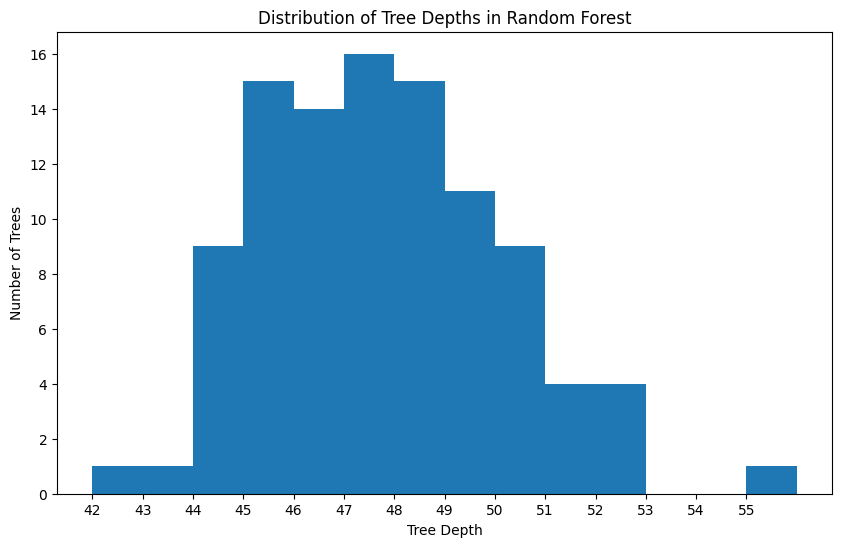

In [ ]:
# Creating a bar chart to display the amount of trees and each depth there are in the rfc classifier
tree_depths = [estimator.tree_.max_depth for estimator in rfc.estimators_]

plt.figure(figsize=(10, 6))
plt.hist(tree_depths, bins=range(min(tree_depths), max(tree_depths) + 2))       # Added +2 for better visualization
plt.xlabel('Tree Depth')                                                        # Label for x-axis
plt.ylabel('Number of Trees')                                                   # Label for y-axis
plt.title('Distribution of Tree Depths in Random Forest')                       # Added title
plt.xticks(range(min(tree_depths), max(tree_depths) + 1))                       # Ensure x-ticks match bins
plt.show()                                                                      # Show the plot

#### Accuracy vs Max Depth

We want to investigate how much Accuracy varies depending on the value of Max Depth for our Random Forest ....

Max Depth: 5, Accuracy: 0.7395452448724728
Max Depth: 10, Accuracy: 0.7542837212965359
Max Depth: 15, Accuracy: 0.7614616968374155
Max Depth: 20, Accuracy: 0.7629017922437361
Max Depth: 25, Accuracy: 0.7611241744765591
Max Depth: 30, Accuracy: 0.7609329118054071
Max Depth: 35, Accuracy: 0.7600553536671805
Max Depth: 40, Accuracy: 0.7603141208105036
Max Depth: 45, Accuracy: 0.76029161931978
Max Depth: 50, Accuracy: 0.7606403924259982
Max Depth: 55, Accuracy: 0.7611466759672828


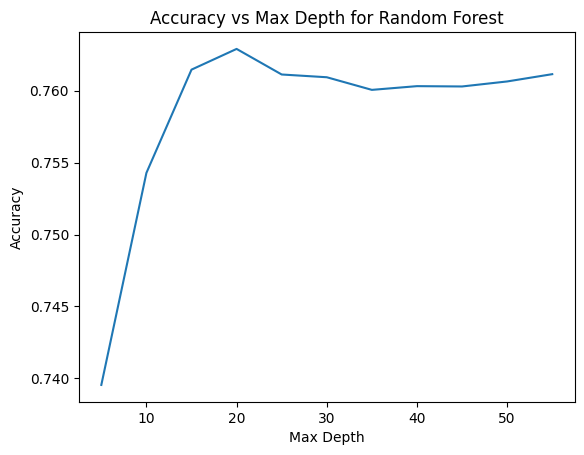

In [ ]:
# A loop with a random forest classifier inside it:
accuracy_scores = []                                                            # List that stores accuracy scores
max_depths = []                                                                 # List that stores the max depths

# Increment the value of max depth from 5 up to 55 in increments of 5
for max_depth in range(5, 56, 5):
  rfc = RandomForestClassifier(n_estimators=100, max_depth=max_depth, random_state=42)
  rfc.fit(X_train, y_train)                                                     # Fit the model
  y_pred = rfc.predict(X_test)                                                  # Making predictions
  accuracy = accuracy_score(y_test, y_pred)                                     # Calculate the accuracy
  accuracy_scores.append(accuracy)                                              # Append accuracy and max depth to the lists
  max_depths.append(max_depth)                                                  # Append accuracy and max depth to the lists
  print(f"Max Depth: {max_depth}, Accuracy: {accuracy}")

plt.plot(max_depths, accuracy_scores)                                           # Plot the Accuracy vs Max Depth
plt.xlabel("Max Depth")                                                         # Label for x-axis
plt.ylabel("Accuracy")                                                          # Label for y-axis
plt.title("Accuracy vs Max Depth for Random Forest")                            # Added a title to our plot
plt.show()                                                                      # Show the plot

NOTE - the graph above shows us that Accuracy peaks at about 76.3% when Max Depth = 20.  If we increase Max Depth more than this we actually see Accuracy is falling off and is not giving any better performance.

#### RFC with a max dept of 20

In [ ]:
# Repeat a random forest classifier with a max dept of 20
rfc=RandomForestClassifier(n_estimators = 100, max_depth = 20)
rfc.fit(X_train, y_train)
y_pred = rfc.predict(X_test)
print(accuracy_score(y_test, y_pred))

0.762260499758109


In [ ]:
# Export as DOT format
"""
dot_data = export_graphviz(rfc.estimators_[0],
                           out_file=None,
                           feature_names=X_train.columns,
                           class_names=['HOME', 'ADMITTED'],
                           filled=True,
                           rounded=True,
                           special_characters=True)

# Create and render the graph
graph = graphviz.Source(dot_data)                                               # Create graph from DOT data
graph.render("Random_Forest_Example1_20")                                       # Saves "Random_Forest_Example1_20" as a gv and pdf
graph.view()                                                                    # Open viewer
"""

NOTE - for RF with max_depth = 20 above, we are unable to get the graphviz code to complete and print out the tree image - it seems the tree has too many levels and is too complex to generate.  For this reason, we will set Max Depth = 10 as we will not lose very much accuracy and can then use this model for our further analysis.

#### RFC with a max dept of 10

In [ ]:
# Repeat a random forest classifier with a max dept of 5
rfc=RandomForestClassifier(n_estimators = 100, max_depth = 10)
rfc.fit(X_train, y_train)
y_pred = rfc.predict(X_test)
print(accuracy_score(y_test, y_pred))

0.7547225003656493


ROC AUC Score: 0.825


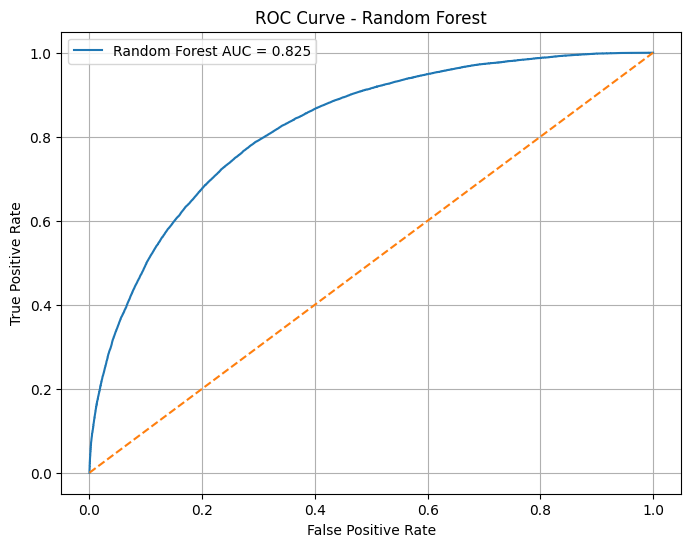

In [ ]:
y_proba = rfc.predict_proba(X_test)[:, 1]                                       # Get predicted probabilities
roc_auc = roc_auc_score(y_test, y_proba)                                        # Calculates the ROC AUC score
print(f"ROC AUC Score: {roc_auc:.3f}")                                          # Prints the ROC AUC score
fpr, tpr, thresholds = roc_curve(y_test, y_proba)                               # Calculates the ROC curve

# Plotting the ROC curve
plt.figure(figsize=(8, 6))                                                      # Setting the figure size
plt.plot(fpr, tpr, label=f'Random Forest AUC = {roc_auc:.3f}')                  # Plotting the ROC curve
plt.plot([0, 1], [0, 1], linestyle='--')                                        # Plotting the diagonal line
plt.xlabel('False Positive Rate')                                               # Labelling the x-axis
plt.ylabel('True Positive Rate')                                                # Labelling the y-axis
plt.title('ROC Curve - Random Forest')                                          # Labelling the title
plt.legend()                                                                    # Adding a legend
plt.grid()                                                                      # Adding a grid
plt.show()                                                                      # Displaying the plot

In [ ]:
# Export as DOT format
dot_data = export_graphviz(rfc.estimators_[0],
                           out_file=None,
                           feature_names=X_train.columns,
                           class_names=['HOME', 'ADMITTED'],
                           filled=True,
                           rounded=True,
                           special_characters=True)

# Create and render the graph
graph = graphviz.Source(dot_data)                                               # Create graph from DOT data
graph.render("Random_Forest_10")                                                # Saves "Random_Forest_Example1_5" as a gv and pdf
graph.view()                                                                    # Open viewer

'Random_Forest_10.pdf'

#### Analyse Performance per Class

Analysis of Performance by Class



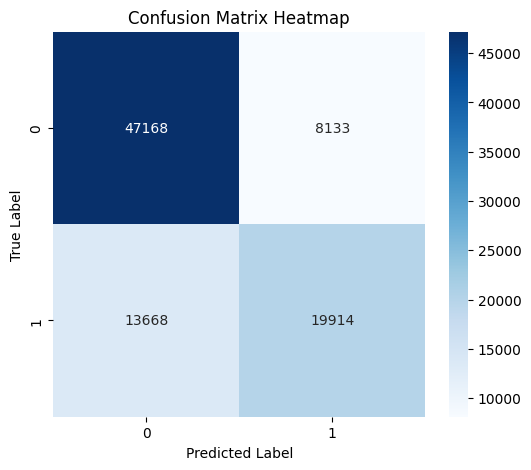



Accuracy:  0.75
Precision:  0.71
Recall / Sensitivity:  0.59
Specificity:  0.85
F1 Score:  0.64




In [ ]:
# get standard performance metrics by class
analyse_performance_by_class(y_test, y_pred)

#### Analyse Performance per Target Group = Gender

In [ ]:
# target group = GENDER
analyse_performance_by_gender(y_test, y_pred, X_test)

Performance Analysis for target group = GENDER

Female instances in the test set: 48746
Male instances in the test set:   40137


Metrics for:  Female
-------------------------------

Accuracy: 75.9 %

Predicted  False   True    All
Actual                        
False      27079   4480  31559
True        7270   9917  17187
All        34349  14397  48746


Accuracy:  0.76
Precision:  0.69
Recall / Sensitivity:  0.58
Specificity:  0.86
F1 Score:  0.63


Metrics for:  Male
-------------------------------

Accuracy: 74.96 %

Predicted  False   True    All
Actual                        
False      20089   3653  23742
True        6398   9997  16395
All        26487  13650  40137


Accuracy:  0.75
Precision:  0.73
Recall / Sensitivity:  0.61
Specificity:  0.85
F1 Score:  0.66


#### Analyse Performance per Target Group = Race Group

In [ ]:
# target group = RACE GROUP

analyse_performance_by_race_group(y_test, y_pred, X_test)

Performance Analysis for target group = RACE GROUP

Black / African Amercian instances in the test set: 19944
Hispanic / Latino instances in the test set:        7253
Other instances in the test set:                    783
Unknown instances in the test set:                  4976
White instances in the test set:                    52038
Asian instances in the test set:                    3889


Metrics for:  BAM
-------------------------------

Accuracy: 78.32 %

Predicted  False  True    All
Actual                       
False      13044  1209  14253
True        3114  2577   5691
All        16158  3786  19944


Accuracy:  0.78
Precision:  0.68
Recall / Sensitivity:  0.45
Specificity:  0.92
F1 Score:  0.54


Metrics for:  Hispanic/Latino
-------------------------------

Accuracy: 79.83 %

Predicted  False  True   All
Actual                      
False       5016   431  5447
True        1032   774  1806
All         6048  1205  7253


Accuracy:  0.8
Precision:  0.64
Recall / Sensitivity: 

#### Analyse Performance per Target Group = Age Group

In [ ]:
# target group = AGE GROUP

analyse_performance_by_age_group(y_test,y_pred, X_test)

Performance Analysis for target group = AGE GROUP

Age 18-30 instances in the test set: 17045
Age 31-45 instances in the test set: 16127
Age 46-60 instances in the test set: 21623
Age 61-75 instances in the test set: 19108
Age 75+ instances in the test set:   14980


Metrics for:  Age 18-30
-------------------------------

Accuracy: 86.17 %

Predicted  False  True    All
Actual                       
False      14366   156  14522
True        2201   322   2523
All        16567   478  17045


Accuracy:  0.86
Precision:  0.67
Recall / Sensitivity:  0.13
Specificity:  0.99
F1 Score:  0.22


Metrics for:  Age 31-45
-------------------------------

Accuracy: 78.36 %

Predicted  False  True    All
Actual                       
False      11464   533  11997
True        2957  1173   4130
All        14421  1706  16127


Accuracy:  0.78
Precision:  0.69
Recall / Sensitivity:  0.28
Specificity:  0.96
F1 Score:  0.4


Metrics for:  Age 46-60
-------------------------------

Accuracy: 72.84 %

Predi

### 5.2.3 Feature Importance

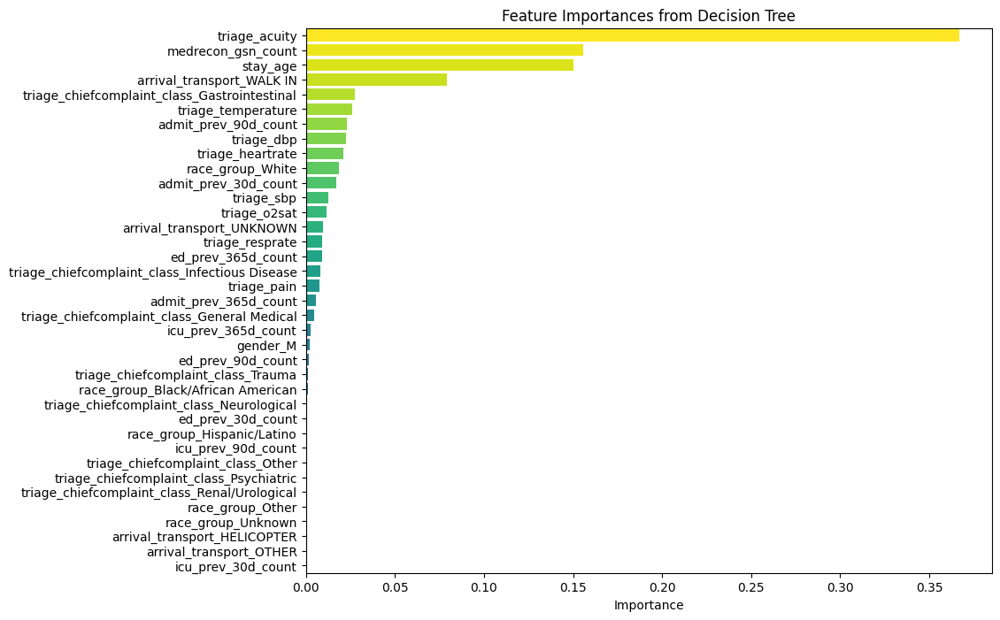

In [ ]:
# Visualize features by importance - for our Decision Tree with Max Depth 10
importances = dtree_10.feature_importances_                                     # Getting the feature importances
feature_names = X_train.columns                                                 # Getting the feature names
dtree_importances = pd.Series(importances, index=feature_names)                 # Creates a Series with feature names as the index

dtree_importances.sort_values().plot(kind='barh', figsize=(10, 8))
plt.barh(dtree_importances.sort_values().index, dtree_importances.sort_values().values, color=plt.cm.viridis(np.linspace(0, 1, len(dtree_importances))))
plt.xlabel('Importance')                                                        # Label for x-axis
plt.title("Feature Importances from Decision Tree")                             # Added a title to our plot
plt.show()                                                                      # Show the plot

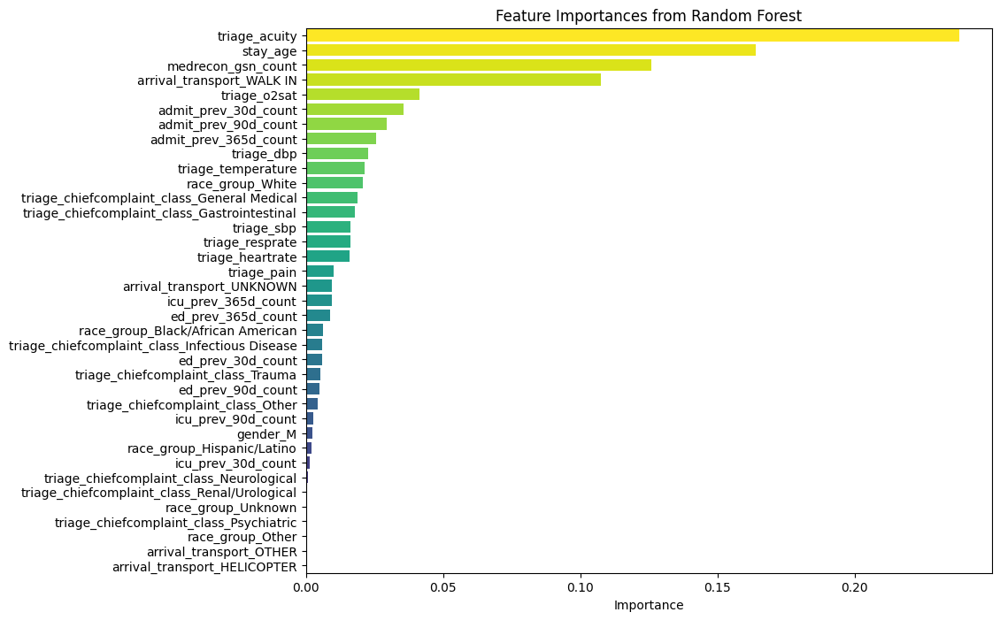

In [ ]:
# Visualize features by importance - for our Random Forest with Max Depth 10
importances = rfc.feature_importances_                                          # Getting the feature importances
feature_names = X_train.columns                                                 # Getting the feature names
forest_importances = pd.Series(importances, index=feature_names)                # Creates a Series with feature names as the index

forest_importances.sort_values().plot(kind='barh', figsize=(10, 8))
plt.barh(forest_importances.sort_values().index, forest_importances.sort_values().values, color=plt.cm.viridis(np.linspace(0, 1, len(forest_importances))))
plt.xlabel('Importance')                                                        # Label for x-axis
plt.title("Feature Importances from Random Forest")                             # Added a title to our plot
plt.show()                                                                      # Show the plot

### 5.2.4 Random Forest - Model Compression

#### RF Model Compression

Max Depth: 2, Accuracy: 0.7003, Model Size: 96.56 KB, Inference Time: 647.70 ms
Max Depth: 4, Accuracy: 0.7326, Model Size: 283.74 KB, Inference Time: 1209.94 ms
Max Depth: 6, Accuracy: 0.7420, Model Size: 1019.84 KB, Inference Time: 1977.20 ms
Max Depth: 8, Accuracy: 0.7494, Model Size: 3599.37 KB, Inference Time: 2309.96 ms
Max Depth: 10, Accuracy: 0.7543, Model Size: 11137.02 KB, Inference Time: 2841.81 ms
Max Depth: 12, Accuracy: 0.7582, Model Size: 28378.74 KB, Inference Time: 2900.16 ms
Max Depth: 14, Accuracy: 0.7607, Model Size: 60987.81 KB, Inference Time: 3302.75 ms
Max Depth: 16, Accuracy: 0.7613, Model Size: 110358.43 KB, Inference Time: 3619.83 ms
Max Depth: 18, Accuracy: 0.7620, Model Size: 180126.56 KB, Inference Time: 4194.81 ms
Max Depth: 20, Accuracy: 0.7629, Model Size: 260503.74 KB, Inference Time: 5561.45 ms
Max Depth: 22, Accuracy: 0.7618, Model Size: 344563.12 KB, Inference Time: 6236.00 ms


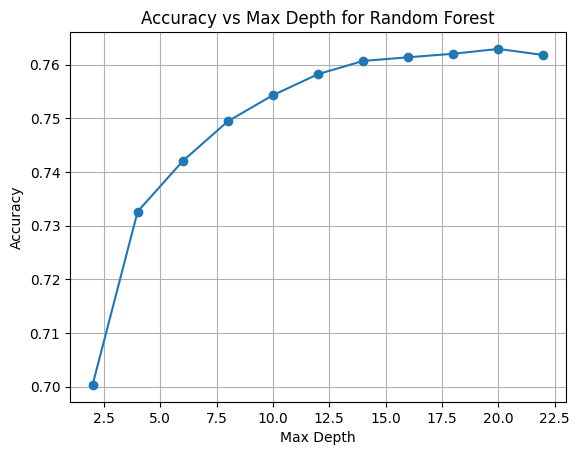

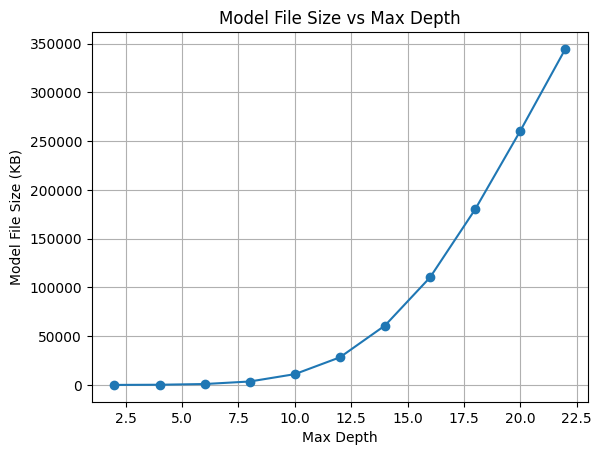

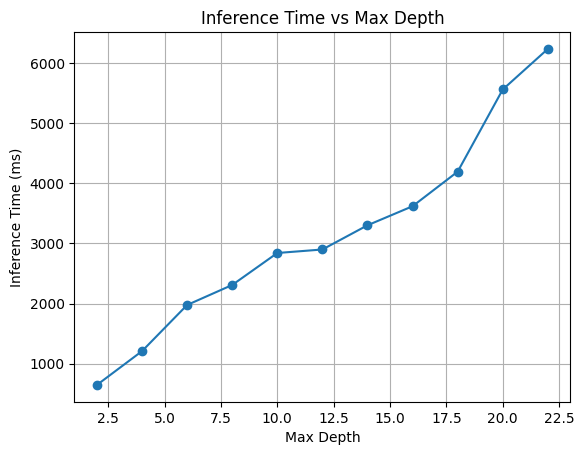

In [ ]:
# set up X and y (again)
X = reduced_master_df.drop('disposition_ADMITTED', axis=1)                                  # Separate features (X) and target (y)
y = reduced_master_df['disposition_ADMITTED']

# Test train split
X_train, X_test, y_train, y_test= train_test_split(X,y,test_size=0.3,random_state=42)

accuracy_scores = []
max_depths = []
model_file_sizes = []
inference_times_ms = []

for max_depth in range(2, 24, 2):
    rfc = RandomForestClassifier(n_estimators=100, max_depth=max_depth, random_state=42)
    rfc.fit(X_train, y_train)

    # Time the inference
    start_time = time.time()
    y_pred = rfc.predict(X_test)
    end_time = time.time()

    inference_time_ms = (end_time - start_time) * 1000  # milliseconds
    inference_times_ms.append(inference_time_ms)

    # Accuracy
    accuracy = accuracy_score(y_test, y_pred)
    accuracy_scores.append(accuracy)
    max_depths.append(max_depth)

    # Save model
    filename = f"rfc_model_{max_depth}.joblib"
    joblib.dump(rfc, filename)

    # Get file size in kilobytes
    file_size_kb = os.path.getsize(filename) / 1024
    model_file_sizes.append(file_size_kb)

    print(f"Max Depth: {max_depth}, Accuracy: {accuracy:.4f}, "
          f"Model Size: {file_size_kb:.2f} KB, Inference Time: {inference_time_ms:.2f} ms")

# Plot Accuracy vs Max Depth
plt.figure()
plt.plot(max_depths, accuracy_scores, marker='o')
plt.xlabel("Max Depth")
plt.ylabel("Accuracy")
plt.title("Accuracy vs Max Depth for Random Forest")
plt.grid(True)
plt.show()

# Plot Max Depth vs Model File Size
plt.figure()
plt.plot(max_depths, model_file_sizes, marker='o')
plt.xlabel("Max Depth")
plt.ylabel("Model File Size (KB)")
plt.title("Model File Size vs Max Depth")
plt.grid(True)
plt.show()

# Plot Max Depth vs Inference Time
plt.figure()
plt.plot(max_depths, inference_times_ms, marker='o')
plt.xlabel("Max Depth")
plt.ylabel("Inference Time (ms)")
plt.title("Inference Time vs Max Depth")
plt.grid(True)
plt.show()



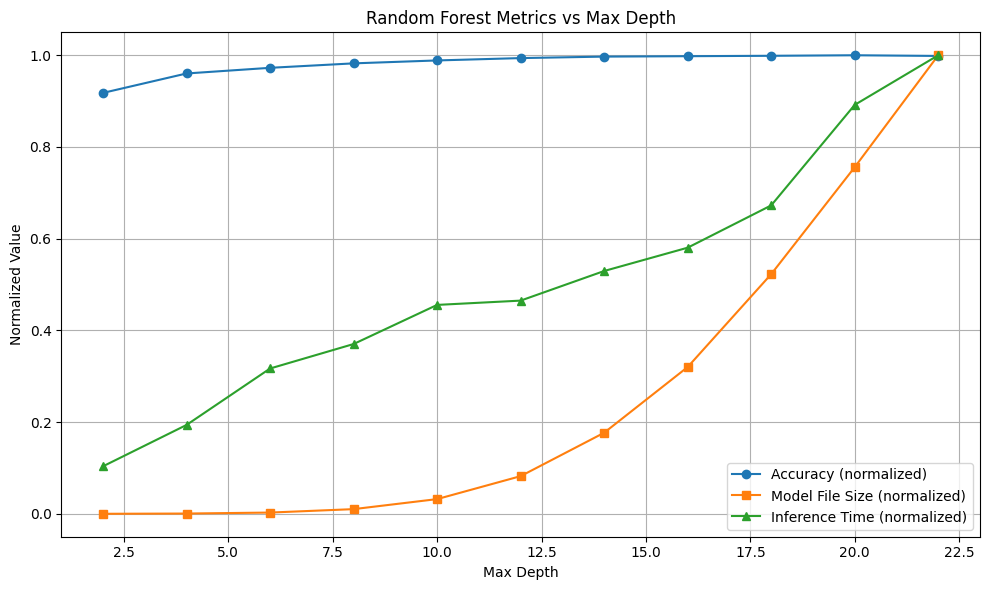

In [ ]:
# Plot all on same graph

# Normalize values for consistent scale in plotting
accuracy_norm = np.array(accuracy_scores) / max(accuracy_scores)
file_size_norm = np.array(model_file_sizes) / max(model_file_sizes)
inference_time_norm = np.array(inference_times_ms) / max(inference_times_ms)

# Plot all metrics on the same graph
plt.figure(figsize=(10, 6))
plt.plot(max_depths, accuracy_norm, marker='o', label='Accuracy (normalized)')
plt.plot(max_depths, file_size_norm, marker='s', label='Model File Size (normalized)')
plt.plot(max_depths, inference_time_norm, marker='^', label='Inference Time (normalized)')
plt.xlabel("Max Depth")
plt.ylabel("Normalized Value")
plt.title("Random Forest Metrics vs Max Depth")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

## 5.3 XGBoost

This section includes all our implementation, feature importance / XAI analysis and bias checks for the XGBoost model.

### 5.3.1 Model

In [ ]:
# Separate features and target
X = reduced_master_df.drop('disposition_ADMITTED', axis=1)
y = reduced_master_df['disposition_ADMITTED']

# Split into training and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

In [ ]:
# Initialize and train the XGBoost model
xgb_model = XGBClassifier(
    n_estimators=100,
    learning_rate=0.1,
    max_depth=8,
    subsample=0.8,
    colsample_bytree=0.8,
    #use_label_encoder=False,
    eval_metric='logloss',
    random_state=42
)

xgb_model.fit(X_train, y_train)

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=0.8, device=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric='logloss',
              feature_types=None, gamma=None, grow_policy=None,
              importance_type=None, interaction_constraints=None,
              learning_rate=0.1, max_bin=None, max_cat_threshold=None,
              max_cat_to_onehot=None, max_delta_step=None, max_depth=8,
              max_leaves=None, min_child_weight=None, missing=nan,
              monotone_constraints=None, multi_strategy=None, n_estimators=100,
              n_jobs=None, num_parallel_tree=None, random_state=42, ...)

In [ ]:
# Make predictions
y_pred = xgb_model.predict(X_test)
y_proba = xgb_model.predict_proba(X_test)[:, 1]

In [ ]:
# Evaluate performance
print(f"Accuracy: {accuracy_score(y_test, y_pred):.2f}")
print(f"ROC AUC: {roc_auc_score(y_test, y_proba):.2f}")
print("Classification Report:\n", classification_report(y_test, y_pred))

Accuracy: 0.77
ROC AUC: 0.84
Classification Report:
               precision    recall  f1-score   support

       False       0.80      0.84      0.82     55301
        True       0.71      0.64      0.68     33582

    accuracy                           0.77     88883
   macro avg       0.75      0.74      0.75     88883
weighted avg       0.76      0.77      0.76     88883



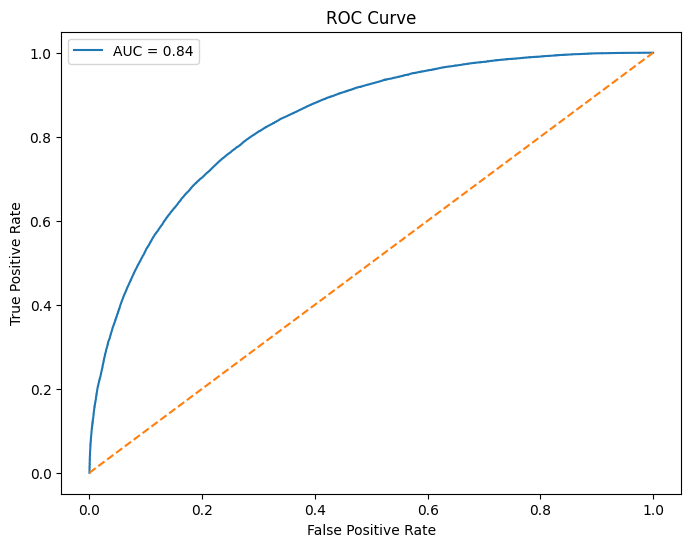

In [ ]:
# create a graph of the ROC curve
fpr, tpr, thresholds = roc_curve(y_test, y_proba)

plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, label=f'AUC = {roc_auc_score(y_test, y_proba):.2f}')
plt.plot([0, 1], [0, 1], linestyle='--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve')
plt.legend()
plt.show()


### 5.3.2 Feature Importance

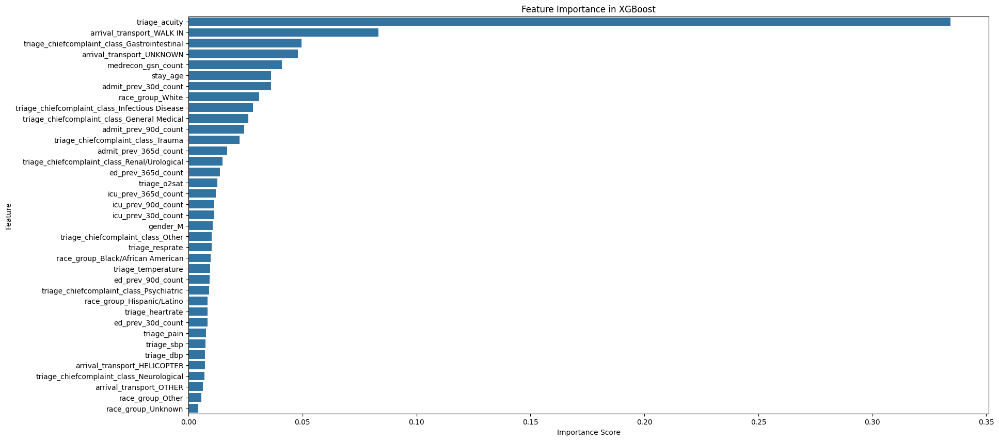

In [ ]:
# Feature importance
feature_importances = xgb_model.feature_importances_

feature_names = X.columns
importance_df = pd.DataFrame({'feature': feature_names, 'importance': feature_importances})

# Sort importance_df
importance_df = importance_df.sort_values('importance', ascending=False)

# Create a bar plot
plt.figure(figsize=(20, 10))
sns.barplot(x='importance', y='feature', data=importance_df)
plt.title('Feature Importance in XGBoost')
plt.xlabel('Importance Score')
plt.ylabel('Feature')
plt.show()

### 5.3.3 Performance per Class

Analysis of Performance by Class



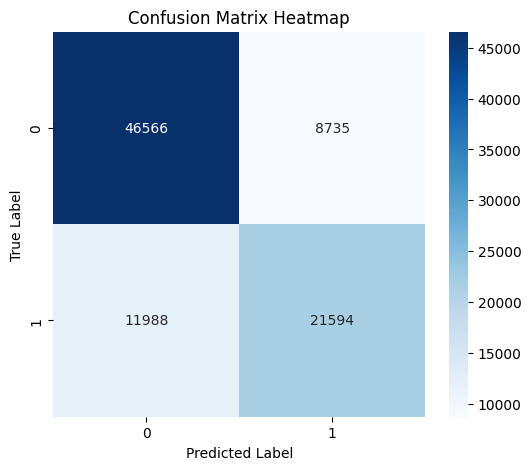



Accuracy:  0.77
Precision:  0.71
Recall / Sensitivity:  0.64
Specificity:  0.84
F1 Score:  0.67




In [ ]:
# call the function to analyse performance by class
analyse_performance_by_class(y_test, y_pred)

### 5.3.4 Performance Per Target Group - Gender (Female / Male)

In [ ]:
# call function to do model performance analysis by gender
analyse_performance_by_gender(y_test, y_pred, X_test)

Performance Analysis for target group = GENDER

Female instances in the test set: 48746
Male instances in the test set:   40137


Metrics for:  Female
-------------------------------

Accuracy: 76.94 %

Predicted      0      1    All
Actual                        
False      27044   4515  31559
True        6724  10463  17187
All        33768  14978  48746


Accuracy:  0.77
Precision:  0.7
Recall / Sensitivity:  0.61
Specificity:  0.86
F1 Score:  0.65


Metrics for:  Male
-------------------------------

Accuracy: 76.37 %

Predicted      0      1    All
Actual                        
False      19522   4220  23742
True        5264  11131  16395
All        24786  15351  40137


Accuracy:  0.76
Precision:  0.73
Recall / Sensitivity:  0.68
Specificity:  0.82
F1 Score:  0.7


### 5.3.5 Performance per Target Group - Race Group

In [ ]:
# call function to do model performance analysis by race group
analyse_performance_by_race_group(y_test, y_pred, X_test)

Performance Analysis for target group = RACE GROUP

Black / African Amercian instances in the test set: 19944
Hispanic / Latino instances in the test set:        7253
Other instances in the test set:                    783
Unknown instances in the test set:                  4976
White instances in the test set:                    52038
Asian instances in the test set:                    3889


Metrics for:  BAM
-------------------------------

Accuracy: 79.4 %

Predicted      0     1    All
Actual                       
False      12923  1330  14253
True        2779  2912   5691
All        15702  4242  19944


Accuracy:  0.79
Precision:  0.69
Recall / Sensitivity:  0.51
Specificity:  0.91
F1 Score:  0.59


Metrics for:  Hispanic/Latino
-------------------------------

Accuracy: 80.57 %

Predicted     0     1   All
Actual                     
False      5046   401  5447
True       1008   798  1806
All        6054  1199  7253


Accuracy:  0.81
Precision:  0.67
Recall / Sensitivity:  0.44

### 5.3.6 Performance per Target Group - Age Group

In [ ]:
# call function to do model performance analysis by race group
analyse_performance_by_age_group(y_test, y_pred, X_test)

Performance Analysis for target group = AGE GROUP

Age 18-30 instances in the test set: 17045
Age 31-45 instances in the test set: 16127
Age 46-60 instances in the test set: 21623
Age 61-75 instances in the test set: 19108
Age 75+ instances in the test set:   14980


Metrics for:  Age 18-30
-------------------------------

Accuracy: 86.42 %

Predicted      0    1    All
Actual                      
False      14300  222  14522
True        2092  431   2523
All        16392  653  17045


Accuracy:  0.86
Precision:  0.66
Recall / Sensitivity:  0.17
Specificity:  0.98
F1 Score:  0.27


Metrics for:  Age 31-45
-------------------------------

Accuracy: 79.29 %

Predicted      0     1    All
Actual                       
False      11183   814  11997
True        2526  1604   4130
All        13709  2418  16127


Accuracy:  0.79
Precision:  0.66
Recall / Sensitivity:  0.39
Specificity:  0.93
F1 Score:  0.49


Metrics for:  Age 46-60
-------------------------------

Accuracy: 74.49 %

Predicted

### 5.3.7 Performance per Intersectional Target Group - Gender Race Group

In [ ]:
# call function to do model performance analysis by gender and race group
analyse_performance_by_gender_race_group(y_test, y_pred, X_test)

Performance Analysis for intersectional target group = GENDER & RACE

Male Black / African Amercian instances in the test set: 7700
Male Hispanic / Latino instances in the test set:        3021
Male Other instances in the test set:                    352
Male Unknown instances in the test set:                  2299
Male White instances in the test set:                    25041
Male Asian instances in the test set:                    1724


Metrics for:  Male BAM
-------------------------------

Accuracy: 79.17 %

Predicted     0     1   All
Actual                     
False      4758   564  5322
True       1040  1338  2378
All        5798  1902  7700


Accuracy:  0.79
Precision:  0.7
Recall / Sensitivity:  0.56
Specificity:  0.89
F1 Score:  0.62


Metrics for:  Male Hispanic/Latino
-------------------------------

Accuracy: 78.88 %

Predicted     0    1   All
Actual                    
False      1953  188  2141
True        450  430   880
All        2403  618  3021


Accuracy:  0.79
Pr

### 5.3.8 Performance per Intersectional Target Group - Gender Age Group

In [ ]:
# call function to do model performance analysis by gender and race group
analyse_performance_by_gender_age_group(y_test, y_pred, X_test)

Performance Analysis for target intersectional group = GENDER AGE GROUP

Male Age 18-30 instances in the test set: 6791
Male Age 31-45 instances in the test set: 7006
Male Age 46-60 instances in the test set: 10636
Male Age 61-75 instances in the test set: 9327
Male Age 75+ instances in the test set:   6377


Metrics for:  Male Age 18-30
-------------------------------

Accuracy: 85.01 %

Predicted     0    1   All
Actual                    
False      5583   96  5679
True        922  190  1112
All        6505  286  6791


Accuracy:  0.85
Precision:  0.66
Recall / Sensitivity:  0.17
Specificity:  0.98
F1 Score:  0.27


Metrics for:  Male Age 31-45
-------------------------------

Accuracy: 78.68 %

Predicted     0     1   All
Actual                     
False      4709   356  5065
True       1138   803  1941
All        5847  1159  7006


Accuracy:  0.79
Precision:  0.69
Recall / Sensitivity:  0.41
Specificity:  0.93
F1 Score:  0.51


Metrics for:  Male Age 46-60
-----------------------

### 5.3.9 XAI - LIME

In [ ]:
# LIME Explainability

# Convert X_train and X_test to a NumPy array
X_train_np = X_train.values
X_test_np = X_test.values

explainer = LimeTabularExplainer(
    X_train_np,
    feature_names=X.columns.tolist(),
    class_names=['HOME', 'ADMITTED'],
    mode='classification'
)

In [ ]:
# Identify 2 correct and 2 incorrect predictions when actual y = "ADMITTED"
correct_indices = np.where((y_pred == y_test.values) & (y_test.values ==1))[0]
incorrect_indices = np.where((y_pred != y_test.values) & (y_test.values ==1))[0]

# Show LIME explanation for 2 correct predictions
print("\n LIME for 2 Correct Predictions when actual = 'ADMITTED'")
print("========================================================")
for i in correct_indices[:2]:    # Use .iloc to access rows by their numerical position
    exp = explainer.explain_instance(X_test.iloc[i].values, xgb_model.predict_proba)
    exp.show_in_notebook()

# Show LIME explanation for 2 incorrect predictions
print("\n LIME for 2 Incorrect Predictions when actual = 'ADMITTED'")
print("========================================================")
for i in incorrect_indices[:2]:
    # Use .iloc to access rows by their numerical position
    exp = explainer.explain_instance(X_test.iloc[i].values, xgb_model.predict_proba)
    exp.show_in_notebook()





 LIME for 2 Correct Predictions when actual = 'ADMITTED'



 LIME for 2 Incorrect Predictions when actual = 'ADMITTED'


In [ ]:
# Identify 2 correct and 2 incorrect predictions when actual y = "HOME"
correct_indices = np.where((y_pred == y_test.values) & (y_test.values ==0))[0]
incorrect_indices = np.where((y_pred != y_test.values) & (y_test.values ==0))[0]

# Show LIME explanation for 2 correct predictions
print("\n LIME for 2 Correct Predictions when actual = 'HOME'")
print("========================================================")
for i in correct_indices[:2]:
    # Use .iloc to access rows by their numerical position
    exp = explainer.explain_instance(X_test.iloc[i].values, xgb_model.predict_proba)
    exp.show_in_notebook()

# Show LIME explanation for 2 incorrect predictions
print("\n LIME for 2 Incorrect Predictions when actual = 'HOME'")
print("========================================================")
for i in incorrect_indices[:2]:
    # Use .iloc to access rows by their numerical position
    exp = explainer.explain_instance(X_test.iloc[i].values, xgb_model.predict_proba)
    exp.show_in_notebook()


 LIME for 2 Correct Predictions when actual = 'HOME'



 LIME for 2 Incorrect Predictions when actual = 'HOME'


### 5.3.10 XAI - SHAP

In [ ]:
# prompt: convert all boolean variables in X_train and X_test to integers

for col in X_train.select_dtypes(include=['bool']).columns:
    X_train[col] = X_train[col].astype(int)
for col in X_test.select_dtypes(include=['bool']).columns:
    X_test[col] = X_test[col].astype(int)


In [ ]:
# prompt: convert all Int64 variables to int64 in X_train and X_test

# Assuming X_train and X_test are pandas DataFrames
for col in X_train.select_dtypes(include=['Int64']):
    X_train[col] = X_train[col].astype('int64')

for col in X_test.select_dtypes(include=['Int64']):
    X_test[col] = X_test[col].astype('int64')


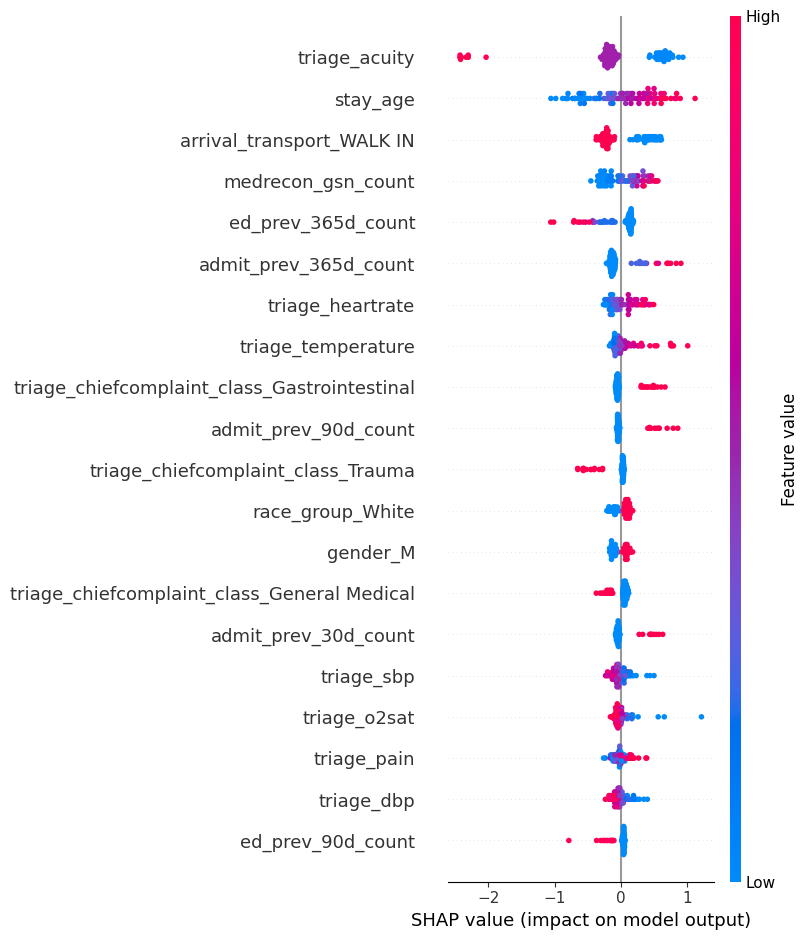

In [ ]:
# SHAP explanations
# Recreate DataFrame with feature names after scaling
feature_names = X.columns.tolist()
X_test_df = pd.DataFrame(X_test, columns=feature_names)

# Use SHAP DeepExplainer (or KernelExplainer if Deep doesn't work)
explainer = shap.Explainer(xgb_model, X_train)
shap_values = explainer(X_test_df[:100])

# Summary plot with feature names and values
shap.summary_plot(shap_values, X_test_df[:100], feature_names=feature_names, show=True)

In [ ]:
# Calculate feature importance based on mean absolute SHAP values
feature_importance = pd.DataFrame({
    'Feature': X.columns,
    'MeanAbsSHAP': np.abs(shap_values.values).mean(axis=0)
}).sort_values('MeanAbsSHAP', ascending=False)

# Print the top 15 features and their absolute SHAP values
print("\n===== Top 15 Features by Mean Absolute SHAP Value =====");
print(feature_importance.head(15).to_string(index=False))



===== Top 15 Features by Mean Absolute SHAP Value =====
                                     Feature  MeanAbsSHAP
                               triage_acuity     0.505731
                                    stay_age     0.408809
                   arrival_transport_WALK IN     0.302989
                          medrecon_gsn_count     0.248692
                          ed_prev_365d_count     0.204062
                       admit_prev_365d_count     0.198705
                            triage_heartrate     0.165274
                          triage_temperature     0.129564
triage_chiefcomplaint_class_Gastrointestinal     0.117790
                        admit_prev_90d_count     0.104911
          triage_chiefcomplaint_class_Trauma     0.103262
                            race_group_White     0.102525
                                    gender_M     0.101531
 triage_chiefcomplaint_class_General Medical     0.090739
                        admit_prev_30d_count     0.089520


### 5.3.11 XGBoost - Tree Images

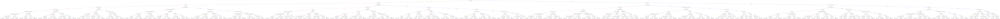

In [ ]:
# Export as DOT format using XGBoost's to_graphviz - this will show tree #1
dot_data = xgb.to_graphviz(xgb_model)

# You can then save this data to a file or display it directly
# To save to a file:
dot_data.render("xgboost_tree_image_1") # This will create a file named xgboost_tree.gv and xgboost_tree.gv.pdf (if you have graphviz installed)

# To display in Colab:
display(dot_data)

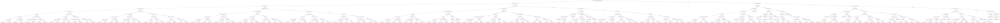

In [ ]:
# Export as DOT format using XGBoost's to_graphviz - this will show tree # 50
dot_data = xgb.to_graphviz(xgb_model, num_trees=50)

# You can then save this data to a file or display it directly
# To save to a file:
dot_data.render("xgboost_tree_image_50") # This will create a file named xgboost_tree.gv and xgboost_tree.gv.pdf (if you have graphviz installed)

# To display in Colab:
display(dot_data)

In [ ]:
n_trees = len(xgb_model.get_booster().get_dump())
print(f"Number of trees: {n_trees}")

Number of trees: 100


In [ ]:
import xgboost
print(xgboost.__version__)


2.1.4


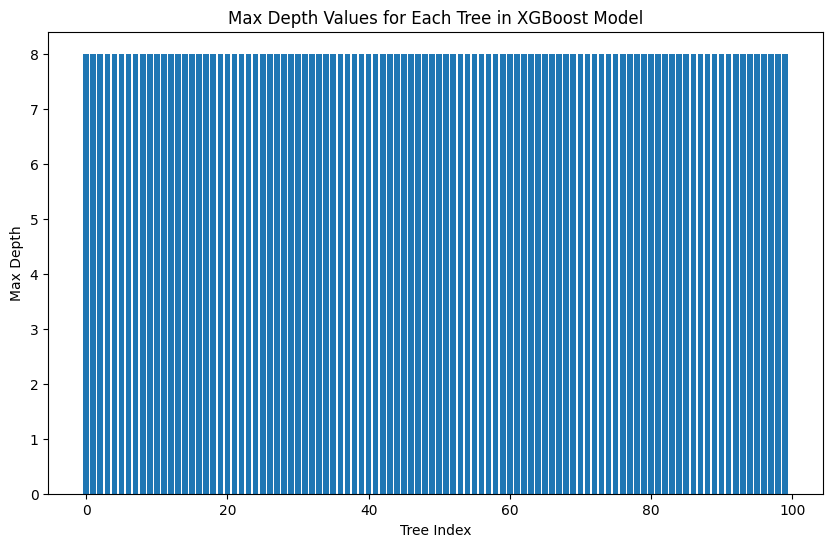

In [ ]:
import matplotlib.pyplot as plt
import pandas as pd
import json
import xgboost as xgb

# Get the model dump in JSON format
model_dump = xgb_model.get_booster().get_dump(dump_format='json')

tree_depths = []

# Parse each tree's JSON and compute max depth
def compute_max_depth(node, depth=0):
    if 'children' not in node:
        return depth
    return max(compute_max_depth(child, depth + 1) for child in node['children'])

for tree_json in model_dump:
    tree_dict = json.loads(tree_json)
    max_depth = compute_max_depth(tree_dict)
    tree_depths.append(max_depth)

# Plotting
depth_df = pd.DataFrame({'Tree': range(len(tree_depths)), 'Max Depth': tree_depths})
plt.figure(figsize=(10, 6))
plt.bar(depth_df['Tree'], depth_df['Max Depth'])
plt.xlabel('Tree Index')
plt.ylabel('Max Depth')
plt.title('Max Depth Values for Each Tree in XGBoost Model')
plt.show()


## 5.4 Deep Neural Network

This section includes all our implementation, feature importance / XAI analysis and bias checks for the DNN model.

### Model

In [ ]:
# set master = the main dataframe from end of Section 4 - Pre-Processing ...
master = reduced_master_df.copy()
master.info()

<class 'pandas.core.frame.DataFrame'>
Index: 296274 entries, 0 to 369143
Data columns (total 38 columns):
 #   Column                                          Non-Null Count   Dtype  
---  ------                                          --------------   -----  
 0   stay_age                                        296274 non-null  Int64  
 1   ed_prev_30d_count                               296274 non-null  int64  
 2   ed_prev_90d_count                               296274 non-null  int64  
 3   ed_prev_365d_count                              296274 non-null  int64  
 4   admit_prev_30d_count                            296274 non-null  int64  
 5   admit_prev_90d_count                            296274 non-null  int64  
 6   admit_prev_365d_count                           296274 non-null  int64  
 7   icu_prev_30d_count                              296274 non-null  int64  
 8   icu_prev_90d_count                              296274 non-null  int64  
 9   icu_prev_365d_count            

In [ ]:
# 1a. Define Target Variable
target_column = 'disposition_ADMITTED' # Your target column name
if target_column not in master.columns:
    print(f"Error: Target column '{target_column}' not found.")
    exit()

y = master[target_column].astype(int) # Ensure target is integer (0 or 1)
print(f"\nTarget variable '{target_column}' assigned.")
print(f"Class distribution:\n{y.value_counts(normalize=True)}")


Target variable 'disposition_ADMITTED' assigned.
Class distribution:
disposition_ADMITTED
0    0.620618
1    0.379382
Name: proportion, dtype: float64


In [ ]:
# # 1b. Convert Boolean Columns to Integer (for TensorFlow/scaling)
# bool_cols = X.select_dtypes(include=['bool']).columns
# if not bool_cols.empty:
#     X[bool_cols] = X[bool_cols].astype(int)
#     print(f"Converted {len(bool_cols)} boolean columns to integers.")


In [ ]:
# Set up the X values
X = master.copy() # Use .copy()
X = X.drop('disposition_ADMITTED', axis=1)

In [ ]:
# 1c. Handle potential NaN/Inf values (using median imputation)
numeric_cols_for_impute = X.select_dtypes(include=[np.number]).columns
X[numeric_cols_for_impute] = X[numeric_cols_for_impute].replace([np.inf, -np.inf], np.nan)
if X.isnull().sum().sum() > 0:
    print(f"Warning: Found {X.isnull().sum().sum()} NaN values. Imputing with median...")
    for col in numeric_cols_for_impute:
         if X[col].isnull().any():
             median_val = X[col].median()
             X[col] = X[col].fillna(median_val)
else:
    print("No NaN or Inf values found in features.")

No NaN or Inf values found in features.


In [ ]:
# =============================================
# STEP 2: DATA SPLITTING & STANDARDIZATION
# =============================================

# Split data (70-15-15)
X_train_val, X_test, y_train_val, y_test = train_test_split(
    X, y, test_size=0.15, random_state=42, stratify=y
)
X_train, X_val, y_train, y_val = train_test_split(
    X_train_val, y_train_val, test_size=0.1765, random_state=42, stratify=y_train_val
)

In [ ]:
X_train.info()

<class 'pandas.core.frame.DataFrame'>
Index: 207383 entries, 7831 to 228733
Data columns (total 37 columns):
 #   Column                                          Non-Null Count   Dtype  
---  ------                                          --------------   -----  
 0   stay_age                                        207383 non-null  Int64  
 1   ed_prev_30d_count                               207383 non-null  int64  
 2   ed_prev_90d_count                               207383 non-null  int64  
 3   ed_prev_365d_count                              207383 non-null  int64  
 4   admit_prev_30d_count                            207383 non-null  int64  
 5   admit_prev_90d_count                            207383 non-null  int64  
 6   admit_prev_365d_count                           207383 non-null  int64  
 7   icu_prev_30d_count                              207383 non-null  int64  
 8   icu_prev_90d_count                              207383 non-null  int64  
 9   icu_prev_365d_count         

In [ ]:
# Keep a copy of all X values before scaling is performed
X_train_unscaled = X_train.copy()
X_val_unscaled = X_val.copy()
X_test_unscaled = X_test.copy()

In [ ]:
# =============================================
# STEP 3: DATA SCALING
# =============================================
# Standardize numeric features
scaler = StandardScaler()
numeric_cols = X.select_dtypes(include=['float64', 'int64']).columns
X_train[numeric_cols] = scaler.fit_transform(X_train[numeric_cols])
X_val[numeric_cols] = scaler.transform(X_val[numeric_cols])
X_test[numeric_cols] = scaler.transform(X_test[numeric_cols])

print("Numeric features scaled using StandardScaler.")

Numeric features scaled using StandardScaler.


In [ ]:
X_train.describe()

,stay_age,ed_prev_30d_count,ed_prev_90d_count,ed_prev_365d_count,admit_prev_30d_count,admit_prev_90d_count,admit_prev_365d_count,icu_prev_30d_count,icu_prev_90d_count,icu_prev_365d_count,triage_temperature,triage_heartrate,triage_resprate,triage_o2sat,triage_sbp,triage_dbp,triage_pain,triage_acuity,medrecon_gsn_count
count,2.073830e+05,2.073830e+05,2.073830e+05,2.073830e+05,2.073830e+05,2.073830e+05,2.073830e+05,2.073830e+05,2.073830e+05,2.073830e+05,2.073830e+05,2.073830e+05,2.073830e+05,2.073830e+05,2.073830e+05,2.073830e+05,2.073830e+05,2.073830e+05,2.073830e+05
mean,-7.811814e-18,5.310663e-17,-4.433547e-17,2.778676e-17,-1.041575e-17,-1.699412e-17,-1.517822e-17,-3.004807e-17,7.537715e-19,5.638725e-17,2.569916e-15,-2.071501e-16,6.387528e-16,-6.100513e-15,6.124051e-16,5.290106e-17,-2.161440e-16,-2.713578e-16,8.039659e-17
std,1.000002e+00,1.000002e+00,1.000002e+00,1.000002e+00,1.000002e+00,1.000002e+00,1.000002e+00,1.000002e+00,1.000002e+00,1.000002e+00,1.000002e+00,1.000002e+00,1.000002e+00,1.000002e+00,1.000002e+00,1.000002e+00,1.000002e+00,1.000002e+00,1.000002e+00
min,-1.705615e+00,-3.122958e-01,-2.874027e-01,-3.052115e-01,-3.152263e-01,-2.996342e-01,-3.210003e-01,-1.259841e-01,-1.353452e-01,-1.751266e-01,-1.949238e+01,-4.351683e+00,-6.916585e+00,-4.316027e+01,-5.879978e+00,-5.240714e+00,-1.106457e+00,-2.540976e+00,-9.373166e-01
25%,-8.733676e-01,-3.122958e-01,-2.874027e-01,-3.052115e-01,-3.152263e-01,-2.996342e-01,-3.210003e-01,-1.259841e-01,-1.353452e-01,-1.751266e-01,-5.865555e-01,-7.433654e-01,-6.426701e-01,-6.227088e-01,-6.963163e-01,-6.530620e-01,-1.106457e+00,-1.020138e+00,-7.898928e-01
50%,5.679167e-02,-3.122958e-01,-2.874027e-01,-3.052115e-01,-3.152263e-01,-2.996342e-01,-3.210003e-01,-1.259841e-01,-1.353452e-01,-1.751266e-01,-8.105218e-02,-5.606674e-02,1.938518e-01,2.543544e-01,-1.103371e-01,-4.587280e-02,-3.745842e-02,5.007004e-01,-3.476211e-01
75%,7.911279e-01,-3.122958e-01,-2.874027e-01,5.342658e-02,-3.152263e-01,-2.996342e-01,-3.210003e-01,-1.259841e-01,-1.353452e-01,-1.751266e-01,4.244511e-01,6.312319e-01,1.938518e-01,6.928859e-01,6.108680e-01,6.287819e-01,1.031540e+00,5.007004e-01,5.369221e-01
max,2.455623e+00,2.639833e+01,2.687917e+01,3.268949e+01,2.718780e+01,3.045846e+01,3.017754e+01,2.669153e+01,2.635417e+01,3.758984e+01,1.235433e+01,9.451565e+00,8.008170e+01,6.928859e-01,7.372166e+00,2.005884e+01,1.566040e+00,3.542377e+00,8.645235e+00


In [ ]:
# =============================================
# STEP 4: DEFINE AND COMPILE NN MODEL
# =============================================

# Define the model
model = keras.Sequential([
    layers.Input(shape=(X_train.shape[1],)),  # Input layer with the shape of your features
    layers.Dense(64, activation='relu'),  # First hidden layer with 64 neurons and ReLU activation
    layers.Dense(32, activation='relu'),  # Second hidden layer with 32 neurons and ReLU activation
    layers.Dense(1, activation='sigmoid')  # Output layer with 1 neuron and sigmoid activation for binary classification
])

# Compile the model
model.compile(optimizer='adam',
              loss='binary_crossentropy',
              metrics=['accuracy'])

# Print model summary
model.summary()

# =============================================
# STEP 5: TRAIN NEURAL NETWORK
# =============================================

# Train the model
history = model.fit(X_train, y_train, epochs=10, batch_size=32, validation_split=0.2)  # Adjust epochs and batch_size as needed

# =============================================
# STEP 6: EVALUATE NEURAL NETWORK
# =============================================

# Evaluate the model on the test set
loss, accuracy = model.evaluate(X_test, y_test)
print(f"Test Loss: {loss:.4f}")
print(f"Test Accuracy: {accuracy:.4f}")

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ dense (Dense)                   │ (None, 64)             │         2,432 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 32)             │         2,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_2 (Dense)                 │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,545 (17.75 KB)

 Trainable params: 4,545 (17.75 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/10
5185/5185 ━━━━━━━━━━━━━━━━━━━━ 41s 7ms/step - accuracy: 0.7485 - loss: 0.5049 - val_accuracy: 0.7662 - val_loss: 0.4795
Epoch 2/10
5185/5185 ━━━━━━━━━━━━━━━━━━━━ 28s 4ms/step - accuracy: 0.7621 - loss: 0.4816 - val_accuracy: 0.7673 - val_loss: 0.4758
Epoch 3/10
5185/5185 ━━━━━━━━━━━━━━━━━━━━ 43s 5ms/step - accuracy: 0.7640 - loss: 0.4794 - val_accuracy: 0.7664 - val_loss: 0.4756
Epoch 4/10
5185/5185 ━━━━━━━━━━━━━━━━━━━━ 39s 4ms/step - accuracy: 0.7651 - loss: 0.4763 - val_accuracy: 0.7675 - val_loss: 0.4754
Epoch 5/10
5185/5185 ━━━━━━━━━━━━━━━━━━━━ 24s 5ms/step - accuracy: 0.7673 - loss: 0.4753 - val_accuracy: 0.7680 - val_loss: 0.4741
Epoch 6/10
5185/5185 ━━━━━━━━━━━━━━━━━━━━ 24s 5ms/step - accuracy: 0.7662 - loss: 0.4760 - val_accuracy: 0.7680 - val_loss: 0.4746
Epoch 7/10
5185/5185 ━━━━━━━━━━━━━━━━━━━━ 42s 5ms/step - accuracy: 0.7697 - loss: 0.4716 - val_accuracy: 0.7682 - val_loss: 0.4749
Epoch 8/10
5185/5185 ━━━━━━━━━━━━━━━━━━━━ 38s 4ms/step - accuracy: 0.7709 - loss: 0

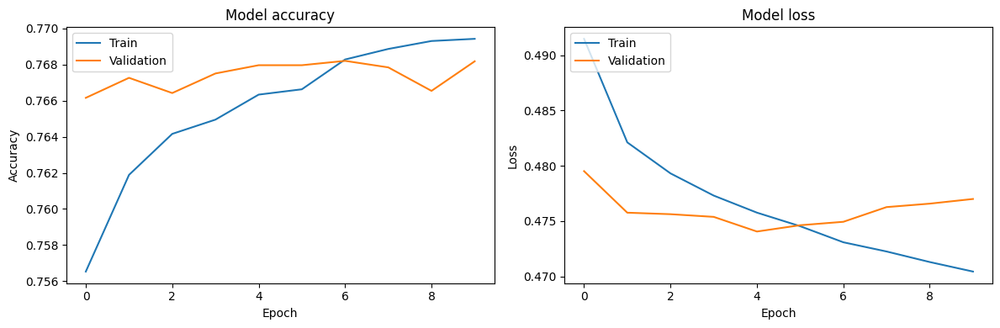

In [ ]:
if history is not None: # Check if history object exists (TensorFlow)
    # Plot training & validation accuracy values
    plt.figure(figsize=(12, 4))

    plt.subplot(1, 2, 1) # Create a subplot for accuracy
    plt.plot(history.history['accuracy'])
    plt.plot(history.history['val_accuracy'])
    plt.title('Model accuracy')
    plt.ylabel('Accuracy')
    plt.xlabel('Epoch')
    plt.legend(['Train', 'Validation'], loc='upper left')

    # Plot training & validation loss values
    plt.subplot(1, 2, 2) # Create a subplot for loss
    plt.plot(history.history['loss'])
    plt.plot(history.history['val_loss'])
    plt.title('Model loss')
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend(['Train', 'Validation'], loc='upper left')

    plt.tight_layout() # Adjust layout to prevent overlapping
    plt.show()

else:  # If history is None, likely using MLPClassifier
    print("Training history not available for visualization. (MLPClassifier used)")

### XAI - SHAP


Starting SHAP explainability analysis...
Creating SHAP DeepExplainer using 150 background samples...
SHAP Explainer created.
Calculating SHAP values for 300 test samples...
SHAP values calculated. Original shape: (300, 37, 1)
Reshaping SHAP values from (300, 37, 1) to 2D.
Shape of SHAP values for plotting: (300, 37)
Explainer expected value (baseline): 0.0000

Generating SHAP Summary Plot (Beeswarm)...


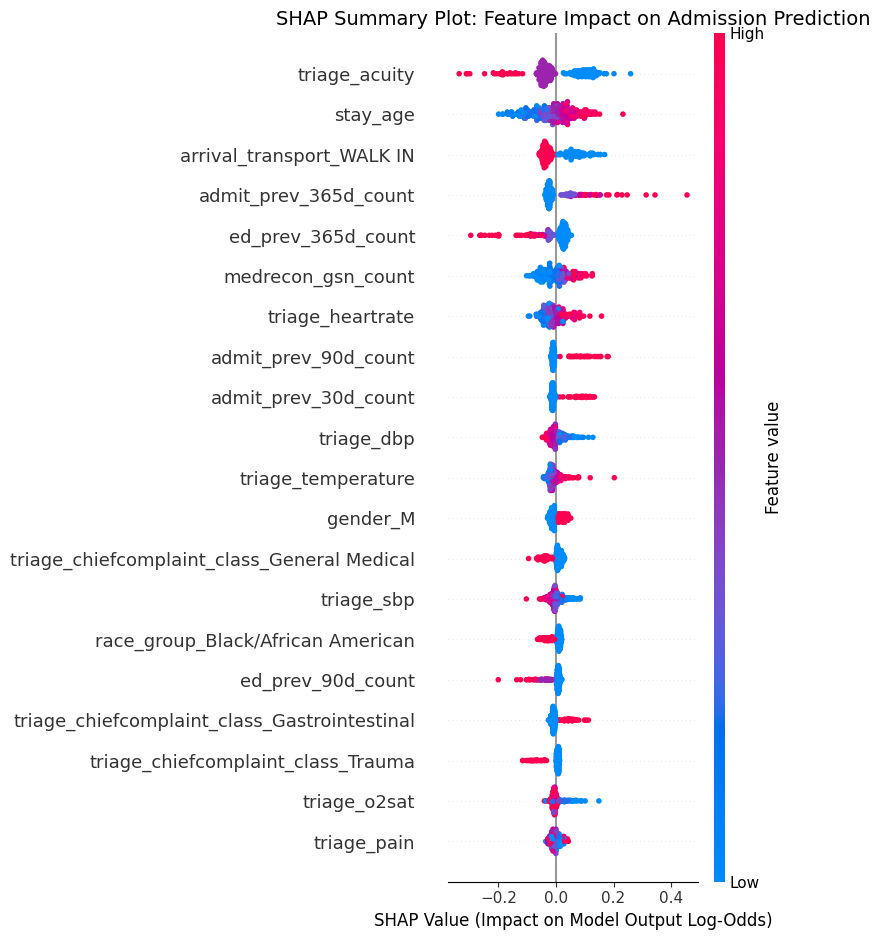

Beeswarm plot saved as 'shap_summary_beeswarm_plot.png'

--- How to Interpret SHAP Beeswarm Plot ---
- Features ranked by importance (top=most important).
- X-axis: SHAP value (Right->Admission=1, Left->Admission=0).
- Color: Feature value (Red=High, Blue=Low).
-------------------------------------------

===== Top 15 Features by Mean Absolute SHAP Value =====
                                    Feature  MeanAbsSHAP
                              triage_acuity     0.075529
                                   stay_age     0.057513
                  arrival_transport_WALK IN     0.048781
                      admit_prev_365d_count     0.040235
                         ed_prev_365d_count     0.039469
                         medrecon_gsn_count     0.037593
                           triage_heartrate     0.029800
                       admit_prev_90d_count     0.019754
                       admit_prev_30d_count     0.019733
                                 triage_dbp     0.018000
          

In [ ]:
# =============================================
# STEP 7: SHAP EXPLAINABILITY (Corrected Shape Handling)
# =============================================

print("\nStarting SHAP explainability analysis...")

# -------------------------------------------------
# 7a. Create SHAP Explainer
# -------------------------------------------------
background_sample_size = 150
background_data = X_train.sample(n=background_sample_size, random_state=42).values.astype('float32')
print(f"Creating SHAP DeepExplainer using {background_sample_size} background samples...")
explainer = shap.DeepExplainer(model, background_data)
print("SHAP Explainer created.")

# -------------------------------------------------
# 7b. Calculate SHAP Values
# -------------------------------------------------
shap_sample_size = 300
X_test_sample = X_test.iloc[:shap_sample_size].values.astype('float32')
X_test_sample_df = X_test.iloc[:shap_sample_size].copy()

print(f"Calculating SHAP values for {shap_sample_size} test samples...")
shap_values = explainer.shap_values(X_test_sample)
print(f"SHAP values calculated. Original shape: {np.array(shap_values).shape}") # Print original shape

# -------------------------------------------------
# 7c. Handle SHAP Value Shape (Corrected)
# -------------------------------------------------
# DeepExplainer with a single sigmoid output often returns (samples, features, 1) or a list containing one such array.

if isinstance(shap_values, list) and len(shap_values) == 1:
    # If it's a list containing one array
    shap_values_array = shap_values[0]
elif isinstance(shap_values, np.ndarray):
      # If it's directly a numpy array
      shap_values_array = shap_values
else:
      raise ValueError(f"Unexpected SHAP values type or structure: {type(shap_values)}")

# Check the dimensions and squeeze the last dimension if it's 1
if shap_values_array.ndim == 3 and shap_values_array.shape[2] == 1:
    print(f"Reshaping SHAP values from {shap_values_array.shape} to 2D.")
    shap_values_for_plot = np.squeeze(shap_values_array, axis=-1)
elif shap_values_array.ndim == 2:
      # Already in the correct 2D shape
      print("SHAP values are already in expected 2D shape.")
      shap_values_for_plot = shap_values_array
else:
      raise ValueError(f"Unexpected SHAP values dimensions after processing: {shap_values_for_plot.shape}")

# Check the expected value format
if isinstance(explainer.expected_value, list) and len(explainer.expected_value) == 1:
    expected_value = explainer.expected_value[0]
elif isinstance(explainer.expected_value, (int, float)):
      expected_value = explainer.expected_value
else:
      print(f"Warning: Unexpected format for explainer.expected_value: {explainer.expected_value}. Using 0 as fallback.")
      expected_value = 0 # Fallback, might affect force plot baseline

print(f"Shape of SHAP values for plotting: {shap_values_for_plot.shape}")
print(f"Explainer expected value (baseline): {expected_value:.4f}")

# -------------------------------------------------
# 7d. Generate SHAP Summary Plot (Beeswarm)
# -------------------------------------------------
print("\nGenerating SHAP Summary Plot (Beeswarm)...")
plt.figure(figsize=(12, 10))
shap.summary_plot(
    shap_values_for_plot,
    X_test_sample_df, # Use DataFrame for feature names
    max_display=20,
    show=False
)
plt.title('SHAP Summary Plot: Feature Impact on Admission Prediction', fontsize=14)
plt.xlabel("SHAP Value (Impact on Model Output Log-Odds)", fontsize=12)
plt.tight_layout()
plt.savefig('shap_summary_beeswarm_plot.png', dpi=300, bbox_inches='tight')
plt.show()
print("Beeswarm plot saved as 'shap_summary_beeswarm_plot.png'")

# --- Interpretation Guidance ---
print("\n--- How to Interpret SHAP Beeswarm Plot ---")
print("- Features ranked by importance (top=most important).")
print("- X-axis: SHAP value (Right->Admission=1, Left->Admission=0).")
print("- Color: Feature value (Red=High, Blue=Low).")
print("-------------------------------------------")

# -------------------------------------------------
# 7e. Calculate and Print Top Features
# -------------------------------------------------
feature_importance = pd.DataFrame({
    'Feature': X.columns,
    'MeanAbsSHAP': np.abs(shap_values_for_plot).mean(axis=0)
}).sort_values('MeanAbsSHAP', ascending=False)
print("\n===== Top 15 Features by Mean Absolute SHAP Value ====="); print(feature_importance.head(15).to_string(index=False))

print("\nExplainability analysis section finished.")

**Short Interpretation of SHAP Results:**

Deep learning model's admission predictions are most influenced by:

1.  **`triage_acuity`**: Higher urgency (lower acuity number) strongly pushes towards predicting admission.
2.  **`stay_age`**: Older age significantly increases the prediction for admission.
3.  **`arrival_transport_WALK IN`**: Patients walking in strongly pushes the prediction *away* from admission.
4.  **`medrecon_gsn_count`**: Taking more home medications increases admission prediction.
5.  **Past Admissions/ED Visits**: More frequent prior admissions (`admit_prev_365d_count`, `admit_prev_90d_count`) or ED visits (`ed_prev_365d_count`) increase admission prediction.

**Overall:** The model relies heavily on clinically relevant factors available at triage (urgency, age, arrival mode, chronic burden, history), behaving as expected.

### Analyse Performance By Class

In [ ]:
# Get model predictions for the test set
y_pred = model.predict(X_test)
y_pred = (y_pred > 0.5).astype(int) # Convert to binary (0 or 1) based on threshold 0.5

1389/1389 ━━━━━━━━━━━━━━━━━━━━ 12s 8ms/step


Analysis of Performance by Class



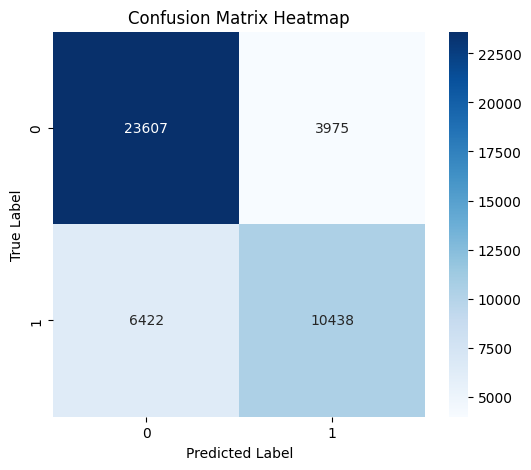



Accuracy:  0.77
Precision:  0.72
Recall / Sensitivity:  0.62
Specificity:  0.86
F1 Score:  0.67




In [ ]:
analyse_performance_by_class(y_test, y_pred)


### Analyse Performance by Target Group - Gender, Race Group, Age Group

In [ ]:
analyse_performance_by_gender(y_test, y_pred, X_test_unscaled) # pass X_test_unscaled
analyse_performance_by_race_group(y_test, y_pred, X_test_unscaled) # pass X_test_unscaled
analyse_performance_by_age_group(y_test, y_pred, X_test_unscaled)  # pass X_test_unscaled

Performance Analysis for target group = GENDER

Female instances in the test set: 24410
Male instances in the test set:   20032


Metrics for:  Female
-------------------------------

Accuracy: 76.85 %

Predicted      0     1    All
Actual                       
0          13604  2097  15701
1           3555  5154   8709
All        17159  7251  24410


Accuracy:  0.77
Precision:  0.71
Recall / Sensitivity:  0.59
Specificity:  0.87
F1 Score:  0.64


Metrics for:  Male
-------------------------------

Accuracy: 76.31 %

Predicted      0     1    All
Actual                       
0          10003  1878  11881
1           2867  5284   8151
All        12870  7162  20032


Accuracy:  0.76
Precision:  0.74
Recall / Sensitivity:  0.65
Specificity:  0.84
F1 Score:  0.69
Performance Analysis for target group = RACE GROUP

Black / African Amercian instances in the test set: 9839
Hispanic / Latino instances in the test set:        3619
Other instances in the test set:                    396
Unknow

### Model Compression - NN Quanitization

In [ ]:
# Keras model
model.save("my_original_model.h5")  # Saves architecture, weights, and optimizer state
# Or, to save just the weights:
# model.save_weights("my_original_model_weights.h5")
print("Original TensorFlow/Keras model saved.")


Original TensorFlow/Keras model saved.


Original model loaded from: /content/my_original_model.h5
Data prepared: X_test shape: (44442, 37), y_test shape: (44442,)

===== Evaluating Baseline Model =====
Baseline: Accuracy=0.7661, Size=79.79KB, Inference=16.242194ms

===== Processing Dynamic Quantization =====
Saved artifact at '/tmp/tmpq24er8ha'. The following endpoints are available:

* Endpoint 'serve'
  args_0 (POSITIONAL_ONLY): TensorSpec(shape=(None, 37), dtype=tf.float32, name='input_layer')
Output Type:
  TensorSpec(shape=(None, 1), dtype=tf.float32, name=None)
Captures:
  134966472832976: TensorSpec(shape=(), dtype=tf.resource, name=None)
  134966259660560: TensorSpec(shape=(), dtype=tf.resource, name=None)
  134966259662288: TensorSpec(shape=(), dtype=tf.resource, name=None)
  134966259661520: TensorSpec(shape=(), dtype=tf.resource, name=None)
  134966676397456: TensorSpec(shape=(), dtype=tf.resource, name=None)
  134966676396496: TensorSpec(shape=(), dtype=tf.resource, name=None)
Saved Dynamic model to: /content/dyn

<Figure size 1800x500 with 0 Axes>

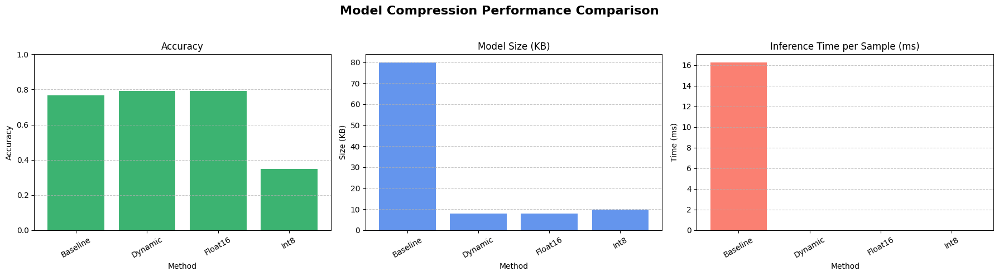


Compression analysis complete. Visualization saved as 'model_compression_comparison.png'


In [ ]:
# Load your trained model
model = tf.keras.models.load_model('/content/my_original_model.h5')
print(f"Original model loaded from: /content/my_original_model.h5")

# STEP 1: Prepare your data (ensure same preprocessing as during training)
# Assuming X_test and X_train are already available as DataFrame or arrays
try:
    # Convert to numpy if DataFrames
    if isinstance(X_test, pd.DataFrame):
        X_test_np = X_test.values.astype(np.float32)
        y_test_np = y_test.values.astype(np.float32)
        X_train_np = X_train.values.astype(np.float32)
    else:
        X_test_np = X_test.astype(np.float32)
        y_test_np = y_test.astype(np.float32)
        X_train_np = X_train.astype(np.float32)

    print(f"Data prepared: X_test shape: {X_test_np.shape}, y_test shape: {y_test_np.shape}")
except NameError:
    print("WARNING: Test/train data not found. Using random data for demonstration.")
    # Generate random data for demonstration
    input_shape = model.input_shape[1]
    X_test_np = np.random.random((1000, input_shape)).astype(np.float32)
    y_test_np = np.random.randint(0, 2, (1000,)).astype(np.float32)
    X_train_np = np.random.random((1000, input_shape)).astype(np.float32)

# STEP 2: Helper functions
def representative_dataset_gen():
    """Generate representative dataset for INT8 quantization"""
    for i in range(min(100, len(X_train_np))):
        sample = X_train_np[i:i+1]
        yield [sample]

def evaluate_tflite_model(tflite_model_path, X_test_np, y_test_np):
    """Evaluate TFLite model performance (accuracy, size, inference time)"""
    try:
        # Get model size
        model_size_kb = os.path.getsize(tflite_model_path) / 1024

        # Initialize interpreter
        interpreter = tf.lite.Interpreter(model_path=tflite_model_path)
        interpreter.allocate_tensors()
        input_details = interpreter.get_input_details()[0]
        output_details = interpreter.get_output_details()[0]

        # Measure inference time
        # Warmup runs
        sample_input = X_test_np[0:1]
        if input_details['dtype'] == np.uint8:
            scale, zero_point = input_details['quantization']
            sample_input = (sample_input / scale + zero_point).astype(np.uint8)

        for _ in range(5):
            interpreter.set_tensor(input_details['index'], sample_input)
            interpreter.invoke()

        # Timed runs
        iterations = 50
        start_time = time.time()
        for _ in range(iterations):
            interpreter.set_tensor(input_details['index'], sample_input)
            interpreter.invoke()
            _ = interpreter.get_tensor(output_details['index'])
        avg_inference_time = (time.time() - start_time) * 1000 / iterations

        # Measure accuracy (on subset for speed if needed)
        subset_size = min(500, len(X_test_np))  # Limit to 500 samples for speed
        predictions = []

        for i in range(subset_size):
            input_data = X_test_np[i:i+1]
            if input_details['dtype'] == np.uint8:
                scale, zero_point = input_details['quantization']
                input_data = (input_data / scale + zero_point).astype(np.uint8)

            interpreter.set_tensor(input_details['index'], input_data)
            interpreter.invoke()
            output = interpreter.get_tensor(output_details['index'])
            predictions.append(1 if output[0][0] > 0.5 else 0)

        accuracy = accuracy_score(y_test_np[:subset_size], predictions)

        return accuracy, model_size_kb, avg_inference_time
    except Exception as e:
        print(f"Evaluation error: {str(e)}")
        return None, None, None

# STEP 3: Quantization configurations
quant_methods = [
    ("Baseline", None),
    ("Dynamic", {"optimizations": [tf.lite.Optimize.DEFAULT]}),
    ("Float16", {
        "optimizations": [tf.lite.Optimize.DEFAULT],
        "target_spec.supported_types": [tf.float16]
    }),
    ("Int8", {
        "optimizations": [tf.lite.Optimize.DEFAULT],
        "representative_dataset": representative_dataset_gen,
        "target_spec.supported_ops": [tf.lite.OpsSet.TFLITE_BUILTINS_INT8],
        "inference_input_type": tf.uint8,
        "inference_output_type": tf.uint8
    })
]

# STEP 4: Run quantizations and evaluations
results = []

# First evaluate the baseline (original keras model)
print("\n===== Evaluating Baseline Model =====")
keras_size_kb = os.path.getsize('/content/my_original_model.h5') / 1024

# Time baseline inference
start_time = time.time()
iterations = 50
batch_size = 32
for i in range(0, min(500, len(X_test_np)), batch_size):
    end_idx = min(i + batch_size, len(X_test_np))
    _ = model.predict(X_test_np[i:end_idx], verbose=0)
keras_inf_time = (time.time() - start_time) * 1000 / min(500, len(X_test_np))

# Calculate baseline accuracy
y_pred = (model.predict(X_test_np, verbose=0) > 0.5).astype(int).ravel()
keras_acc = accuracy_score(y_test_np, y_pred)

results.append(("Baseline", keras_acc, keras_size_kb, keras_inf_time))
print(f"Baseline: Accuracy={keras_acc:.4f}, Size={keras_size_kb:.2f}KB, Inference={keras_inf_time:.6f}ms")

# Process each quantization method
for name, config in quant_methods[1:]:  # Skip baseline
    print(f"\n===== Processing {name} Quantization =====")
    try:
        converter = tf.lite.TFLiteConverter.from_keras_model(model)

        # Apply quantization configuration
        if config:
            for key, value in config.items():
                if key == "representative_dataset":
                    converter.representative_dataset = value
                else:
                    setattr(converter, key, value)

        # Convert model
        tflite_model = converter.convert()
        tflite_path = f"/content/{name.lower()}_quant.tflite"

        # Save quantized model
        with open(tflite_path, "wb") as f:
            f.write(tflite_model)
        print(f"Saved {name} model to: {tflite_path}")

        # Evaluate the quantized model
        accuracy, size_kb, inf_time = evaluate_tflite_model(tflite_path, X_test_np, y_test_np)

        if accuracy is not None:
            results.append((name, accuracy, size_kb, inf_time))
            print(f"{name}: Accuracy={accuracy:.4f}, Size={size_kb:.2f}KB, Inference={inf_time:.6f}ms")
        else:
            results.append((name, "Failed", "Failed", "Failed"))
            print(f"{name}: Evaluation failed")

    except Exception as e:
        print(f"Error in {name} quantization: {str(e)}")
        results.append((name, "Failed", "Failed", "Failed"))

# STEP 5: Create results table
print("\n===== Model Compression Results =====")
results_df = pd.DataFrame(results, columns=["Method", "Accuracy", "Model Size (KB)", "Inference Time (ms)"])
print(results_df.to_string(index=False))

# STEP 6: Visualization
# Convert columns to numeric, handling failed entries gracefully
numeric_cols = ["Accuracy", "Model Size (KB)", "Inference Time (ms)"]
for col in numeric_cols:
    results_df[col] = pd.to_numeric(results_df[col], errors='coerce')

# Get valid methods (where quantization didn't fail)
valid_methods = results_df[results_df['Accuracy'].notna()]['Method']

# Create visualization
plt.figure(figsize=(18, 5))

# Create 3 subplots
fig, axs = plt.subplots(1, 3, figsize=(18, 5))

# Plot 1: Accuracy
axs[0].bar(valid_methods, results_df.loc[results_df['Method'].isin(valid_methods), 'Accuracy'], color='mediumseagreen')
axs[0].set_title("Accuracy")
axs[0].set_ylabel("Accuracy")
axs[0].set_ylim(0, 1.0)
axs[0].grid(axis='y', linestyle='--', alpha=0.7)

# Plot 2: Model Size
axs[1].bar(valid_methods, results_df.loc[results_df['Method'].isin(valid_methods), 'Model Size (KB)'], color='cornflowerblue')
axs[1].set_title("Model Size (KB)")
axs[1].set_ylabel("Size (KB)")
axs[1].grid(axis='y', linestyle='--', alpha=0.7)

# Plot 3: Inference Time
axs[2].bar(valid_methods, results_df.loc[results_df['Method'].isin(valid_methods), 'Inference Time (ms)'], color='salmon')
axs[2].set_title("Inference Time per Sample (ms)")
axs[2].set_ylabel("Time (ms)")
axs[2].grid(axis='y', linestyle='--', alpha=0.7)

# Set common properties
for ax in axs:
    ax.set_xlabel("Method")
    ax.set_xticklabels(valid_methods, rotation=30)

plt.suptitle("Model Compression Performance Comparison", fontsize=16, fontweight='bold')
plt.tight_layout(rect=[0, 0, 1, 0.95])
plt.savefig('model_compression_comparison.png', dpi=300, bbox_inches='tight')
plt.show()

print("\nCompression analysis complete. Visualization saved as 'model_compression_comparison.png'")


# === PRINT TO HTML ===


In [ ]:
# CODE TO PRINT TO HTML
!jupyter nbconvert --to html  '/content/drive/MyDrive/Colab Notebooks/GROUP CA/GROUP CA - MASTER FILE.ipynb' --TemplateExporter.exclude_input=False

[NbConvertApp] Converting notebook /content/drive/MyDrive/Colab Notebooks/GROUP CA/GROUP CA - MASTER FILE.ipynb to html
[NbConvertApp] WARNING | Alternative text is missing on 54 image(s).
[NbConvertApp] Writing 6626000 bytes to /content/drive/MyDrive/Colab Notebooks/GROUP CA/GROUP CA - MASTER FILE.html
